In [213]:
#Imports and library used

import pandas as pd
from tabulate import tabulate
from IPython.display import display, HTML
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
from scipy.stats import linregress
import pymannkendall as mk
from scipy import stats
from scipy import stats
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
from sklearn.preprocessing import OneHotEncoder
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.impute import SimpleImputer
from sklearn.model_selection import GridSearchCV
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import cross_val_score

In [ ]:
# Loading the dataset
df = pd.read_csv("heat_demand_data.csv", index_col=0)

# Displaying the first 5 rows in a neat tabular format
print("First 5 rows of the dataset (Tabulate format):")

# Creating a table using the tabulate function
table = tabulate(df.head(), headers='keys', tablefmt='html', showindex=False)

# Using Custom CSS Styling for the Table
styled_table = f"""
<div style="font-family: Arial, sans-serif; background-color: #f9f9f9; padding: 20px; border-radius: 10px;">
    <table style="width: 100%; border-collapse: collapse; margin: 25px 0; font-size: 16px; text-align: center; border: 1px solid #ddd;">
        <thead style="background-color: #4CAF50; color: white; font-weight: bold; text-align: center;">
            {table.split('<thead>')[1].split('</thead>')[0]}
        </thead>
        <tbody style="background-color: #ffffff;">
            {table.split('<tbody>')[1].split('</tbody>')[0]}
        </tbody>
    </table>
</div>
"""

# Displaying the styled table in Jupyter Notebook
display(HTML(styled_table))

First 5 rows of the dataset (Tabulate format):


utc_timestamp,cet_cest_timestamp,country,heat_demand_space,heat_demand_water,heat_demand_total
2007-12-31T22:00:00Z,2007-12-31T23:00:00+0100,AT,9320,344,9664
2007-12-31T23:00:00Z,2008-01-01T00:00:00+0100,AT,9320,344,9664
2008-01-01T00:00:00Z,2008-01-01T01:00:00+0100,AT,9432,402,9834
2008-01-01T01:00:00Z,2008-01-01T02:00:00+0100,AT,9636,395,10031
2008-01-01T02:00:00Z,2008-01-01T03:00:00+0100,AT,10198,438,10636


In [ ]:
# Step 1: Checking for missing values in each column and calculate the percentage of missing data
missing_data = df.isnull().sum()
missing_percentage = (missing_data / len(df)) * 100

# Step 2: Creating a DataFrame to present the missing data and its percentage clearly
missing_info = pd.DataFrame({
    'Missing Values': missing_data,
    'Percentage': missing_percentage
})

# Step 3: Sorting the missing data by the count of missing values (descending)
missing_info = missing_info.sort_values(by='Missing Values', ascending=False)

# Step 4: Displaying the result using tabulate for a neat presentation
from tabulate import tabulate
print("\nMissing Data Information (Count & Percentage):")
print(tabulate(missing_info, headers='keys', tablefmt='fancy_grid', showindex=True))



Missing Data Information (Count & Percentage):
╒════════════════════╤══════════════════╤══════════════╕
│                    │   Missing Values │   Percentage │
╞════════════════════╪══════════════════╪══════════════╡
│ heat_demand_space  │      1.85835e+06 │      50.4778 │
├────────────────────┼──────────────────┼──────────────┤
│ heat_demand_water  │      1.85835e+06 │      50.4778 │
├────────────────────┼──────────────────┼──────────────┤
│ heat_demand_total  │      1.85835e+06 │      50.4778 │
├────────────────────┼──────────────────┼──────────────┤
│ utc_timestamp      │      0           │       0      │
├────────────────────┼──────────────────┼──────────────┤
│ cet_cest_timestamp │      0           │       0      │
├────────────────────┼──────────────────┼──────────────┤
│ country            │      0           │       0      │
╘════════════════════╧══════════════════╧══════════════╛


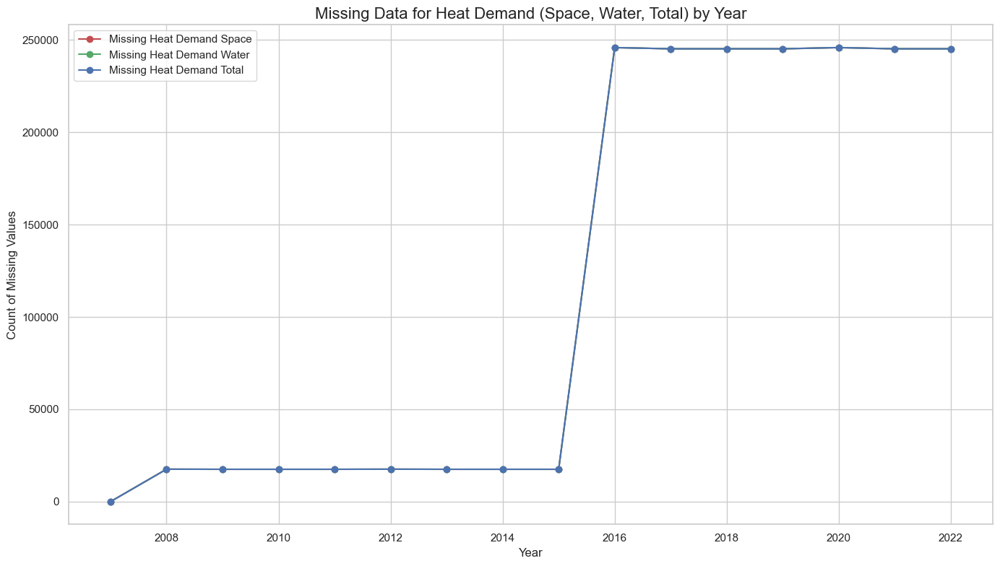

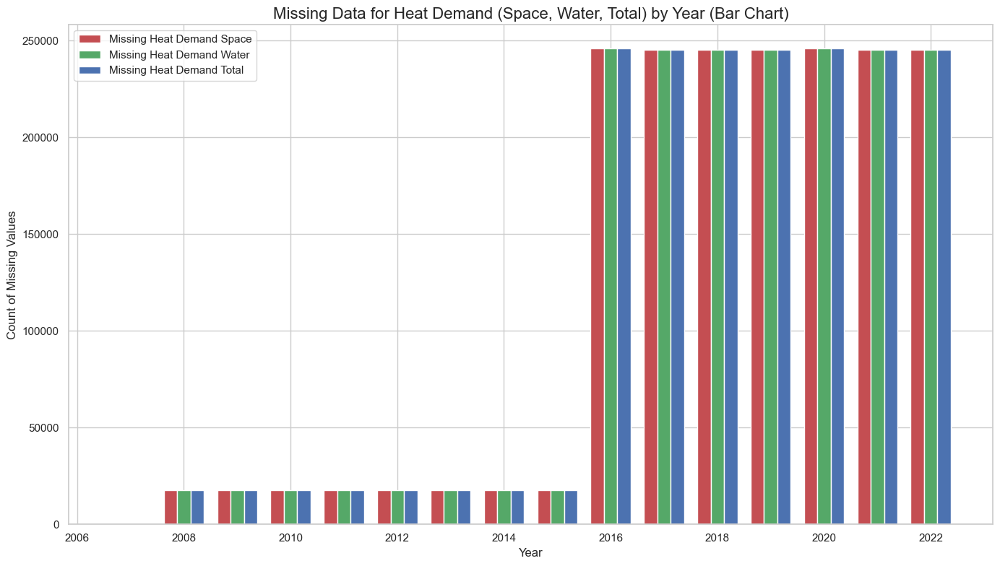

In [ ]:
# Assuming your dataframe is already loaded as 'df'

# Step 1: Converting 'cet_cest_timestamp' to datetime safely, handling mixed time zones
df['cet_cest_timestamp'] = pd.to_datetime(df['cet_cest_timestamp'], errors='coerce', utc=True)

# Step 3: Extract 'year' from the 'cet_cest_timestamp' column
df['year'] = df['cet_cest_timestamp'].dt.year

# Step 5: Groupping by 'year' and count missing values for each relevant column
missing_data_by_year = df.groupby('year').agg({
    'heat_demand_space': lambda x: x.isnull().sum(),
    'heat_demand_water': lambda x: x.isnull().sum(),
    'heat_demand_total': lambda x: x.isnull().sum()
}).reset_index()

# Step 6: Plotting missing data for each column (line plot)
plt.figure(figsize=(14, 8))

# Using Line plot for heat_demand_space
plt.plot(missing_data_by_year['year'], missing_data_by_year['heat_demand_space'],
         marker='o', linestyle='-', color='r', label='Missing Heat Demand Space')

# Using Line plot for heat_demand_water
plt.plot(missing_data_by_year['year'], missing_data_by_year['heat_demand_water'],
         marker='o', linestyle='-', color='g', label='Missing Heat Demand Water')

# Using Line plot for heat_demand_total
plt.plot(missing_data_by_year['year'], missing_data_by_year['heat_demand_total'],
         marker='o', linestyle='-', color='b', label='Missing Heat Demand Total')

# Adding labels, title, and legend
plt.title('Missing Data for Heat Demand (Space, Water, Total) by Year', fontsize=16)
plt.xlabel('Year', fontsize=12)
plt.ylabel('Count of Missing Values', fontsize=12)
plt.legend()
plt.tight_layout()
plt.show()

# Step 7: Plotting missing data for each column (bar plot)
plt.figure(figsize=(14, 8))

bar_width = 0.25
years = missing_data_by_year['year']

# Using Bar plot for heat_demand_space
plt.bar(years - bar_width, missing_data_by_year['heat_demand_space'], width=bar_width,
        color='r', label='Missing Heat Demand Space')

# Using Bar plot for heat_demand_water
plt.bar(years, missing_data_by_year['heat_demand_water'], width=bar_width,
        color='g', label='Missing Heat Demand Water')

# Using Bar plot for heat_demand_total
plt.bar(years + bar_width, missing_data_by_year['heat_demand_total'], width=bar_width,
        color='b', label='Missing Heat Demand Total')

# Adding labels, title, and legend
plt.title('Missing Data for Heat Demand (Space, Water, Total) by Year (Bar Chart)', fontsize=16)
plt.xlabel('Year', fontsize=12)
plt.ylabel('Count of Missing Values', fontsize=12)
plt.legend()
plt.tight_layout()
plt.show()

In [ ]:
# Step 1: Dropping rows where all three columns (heat_demand_space, heat_demand_water, and heat_demand_total) are missing
df = df.dropna(subset=['heat_demand_space', 'heat_demand_water', 'heat_demand_total'], how='all')

# Step 2: Remove rows where any of the three columns are missing in any row
df = df.dropna(subset=['heat_demand_space', 'heat_demand_water', 'heat_demand_total'], how='any')


Missing Data Information (Count & Percentage):
╒════════════════════╤══════════════════╤══════════════╕
│                    │   Missing Values │   Percentage │
╞════════════════════╪══════════════════╪══════════════╡
│ utc_timestamp      │                0 │            0 │
├────────────────────┼──────────────────┼──────────────┤
│ cet_cest_timestamp │                0 │            0 │
├────────────────────┼──────────────────┼──────────────┤
│ country            │                0 │            0 │
├────────────────────┼──────────────────┼──────────────┤
│ heat_demand_space  │                0 │            0 │
├────────────────────┼──────────────────┼──────────────┤
│ heat_demand_water  │                0 │            0 │
├────────────────────┼──────────────────┼──────────────┤
│ heat_demand_total  │                0 │            0 │
├────────────────────┼──────────────────┼──────────────┤
│ year               │                0 │            0 │
╘════════════════════╧══════════════════

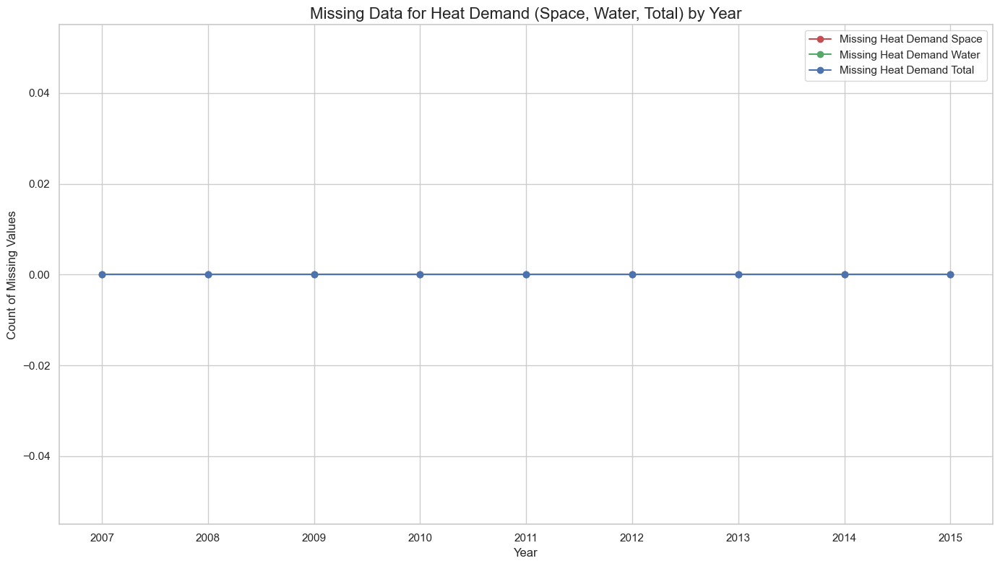

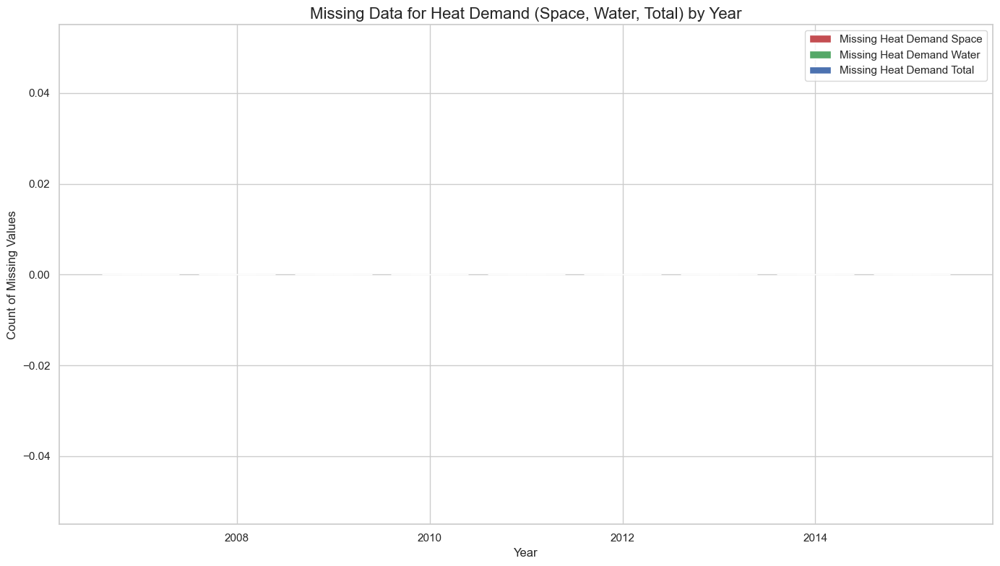

In [ ]:
# Step 1: Checking for missing values in each column and calculate the percentage of missing data
missing_data = df.isnull().sum()
missing_percentage = (missing_data / len(df)) * 100

# Step 2: Creating a DataFrame to present the missing data and its percentage clearly
missing_info = pd.DataFrame({
    'Missing Values': missing_data,
    'Percentage': missing_percentage
})

# Step 3: Sorting the missing data by the count of missing values (descending)
missing_info = missing_info.sort_values(by='Missing Values', ascending=False)

# Step 4: Displaying the result using tabulate for a neat presentation
from tabulate import tabulate
print("\nMissing Data Information (Count & Percentage):")
print(tabulate(missing_info, headers='keys', tablefmt='fancy_grid', showindex=True))




# Step 1: Counting missing values for each year and column
missing_data_by_year = df.groupby('year').agg({
    'heat_demand_space': lambda x: x.isnull().sum(),
    'heat_demand_water': lambda x: x.isnull().sum(),
    'heat_demand_total': lambda x: x.isnull().sum()
}).reset_index()

# Step 2: Ploting the missing data for each column (space, water, total)
plt.figure(figsize=(14, 8))

# Ploting missing data for heat_demand_space
plt.plot(missing_data_by_year['year'], missing_data_by_year['heat_demand_space'], marker='o', linestyle='-', color='r', label='Missing Heat Demand Space')

# Ploting missing data for heat_demand_water
plt.plot(missing_data_by_year['year'], missing_data_by_year['heat_demand_water'], marker='o', linestyle='-', color='g', label='Missing Heat Demand Water')

# Ploting missing data for heat_demand_total
plt.plot(missing_data_by_year['year'], missing_data_by_year['heat_demand_total'], marker='o', linestyle='-', color='b', label='Missing Heat Demand Total')

# Adding labels and title
plt.title('Missing Data for Heat Demand (Space, Water, Total) by Year', fontsize=16)
plt.xlabel('Year', fontsize=12)
plt.ylabel('Count of Missing Values', fontsize=12)

# Showing legend
plt.legend()

# Using Adjust layout and show the plot
plt.tight_layout()
plt.show()


# Step 2: Ploting the missing data for each column (space, water, total) using bar plots
plt.figure(figsize=(14, 8))

# Using Bar plot for missing data in heat_demand_space
plt.bar(missing_data_by_year['year'] - 0.2, missing_data_by_year['heat_demand_space'], width=0.4, color='r', label='Missing Heat Demand Space')

# Using Bar plot for missing data in heat_demand_water
plt.bar(missing_data_by_year['year'] + 0.2, missing_data_by_year['heat_demand_water'], width=0.4, color='g', label='Missing Heat Demand Water')

# Using Bar plot for missing data in heat_demand_total
plt.bar(missing_data_by_year['year'], missing_data_by_year['heat_demand_total'], width=0.4, color='b', label='Missing Heat Demand Total')

# Adding labels and title
plt.title('Missing Data for Heat Demand (Space, Water, Total) by Year', fontsize=16)
plt.xlabel('Year', fontsize=12)
plt.ylabel('Count of Missing Values', fontsize=12)

# Showing legend
plt.legend()

# Using Adjust layout and show the plot
plt.tight_layout()
plt.show()

In [ ]:
#summary for dataset

# Getting the descriptive statistics
desc_stats = df.describe()

# Converting to HTML table
table_desc = tabulate(desc_stats, headers='keys', tablefmt='html', showindex=True)

# Using Custom CSS Styling for the Descriptive Statistics Table
styled_desc_table = f"""
<div style="font-family: 'Arial', sans-serif; background-color: #f9f9f9; padding: 20px; border-radius: 10px;">
    <h3 style="text-align: center; color: #4CAF50; font-size: 24px; font-weight: bold;">Descriptive Statistics</h3>
    <table style="width: 100%; border-collapse: collapse; margin: 25px 0; font-size: 16px; text-align: center; border: 1px solid #ddd;">
        <thead style="background-color: #4CAF50; color: white; font-weight: bold; text-align: center;">
            {table_desc.split('<thead>')[1].split('</thead>')[0]}
        </thead>
        <tbody style="background-color: #ffffff;">
            {table_desc.split('<tbody>')[1].split('</tbody>')[0]}
        </tbody>
    </table>
</div>
"""

# Displaying the styled descriptive statistics table in Jupyter Notebook
display(HTML(styled_desc_table))

,heat_demand_space,heat_demand_water,heat_demand_total,year
count,1.82317e+06,1.82317e+06,1.82317e+06,1.82317e+06
mean,9450.33,1971.61,11421.9,2011.5
std,18896.2,2870.67,20983.3,2.29153
min,1,24,27,2007
25%,751,334,1326,2009
50%,2471,846,3582,2011
75%,9205,1991,11538,2013
max,244977,19800,264244,2015


In [ ]:
# Defining aggregation functions for heat_demand_water only
agg_funcs_water = {
    'heat_demand_water': [
        'mean',
        lambda x: x.quantile(0.25),  # Q1 (lower quartile)
        lambda x: x.quantile(0.75),  # Q3 (upper quartile)
        'min', 'max'
    ]
}

# Grouping by country and compute the stats for heat_demand_water
country_summary_water = df.groupby('country').agg(agg_funcs_water).round(2)

# Using Rename columns for clarity
def rename_stat(col):
    stat_map = {
        '<lambda_0>': 'q1',
        '<lambda_1>': 'q3'
    }
    stat_name = stat_map.get(col[1], col[1])
    return f"{col[0]}_{stat_name}"

country_summary_water.columns = [rename_stat(col) for col in country_summary_water.columns]

# Using Reset index for cleaner display
country_summary_water.reset_index(inplace=True)

# Converting to HTML table
# Using Rename columns for simplicity
country_summary_water.columns = [
    'country', 
    'mean', 
    'q1', 
    'q3', 
    'min', 
    'max'
]

# Converting to HTML table
table_country_summary_water = tabulate(country_summary_water, headers='keys', tablefmt='html', showindex=False)

# Using Style and wrap it in a horizontal scroll div
styled_country_table_water = f"""
<div style="font-family: 'Arial', sans-serif; background-color: #f9f9f9; padding: 20px; border-radius: 10px; overflow-x: auto;">
    <h3 style="text-align: center; color: #a4CAF50; font-size: 24px; font-weight: bold;">Country-wise Heat Demand Water Summary</h3>
    <table style="width: 100%; border-collapse: collapse; margin: 25px 0; font-size: 14px; text-align: center; border: 1px solid #ddd; word-wrap: break-word;">
        <thead style="background-color: #4CAF50; color: white; font-weight: bold;">
            {table_country_summary_water.split('<thead>')[1].split('</thead>')[0]}
        </thead>
        <tbody style="background-color: #ffffff;">
            {table_country_summary_water.split('<tbody>')[1].split('</tbody>')[0]}
        </tbody>
    </table>
</div>
"""

# Displaying the styled table
display(HTML(styled_country_table_water))

country,mean,q1,q3,min,max
AT,1028.45,774,1262,323,2076
BE,1313.62,981,1616,395,2651
BG,475.4,349,588,134,1001
CZ,940.83,694,1164,274,1917
DE,10017.9,7591,12310,3186,19800
DK,775.22,579,954,227,1522
EE,141.26,105,174,40,279
ES,3656.63,2740,4497,1115,7332
FI,953.56,697,1181,275,1904
FR,6920.31,5176,8540,2080,14311


C:\Users\oppor\AppData\Local\Temp\ipykernel_8232\4274318051.py:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='country', y='mean', data=country_summary_water, palette='viridis')


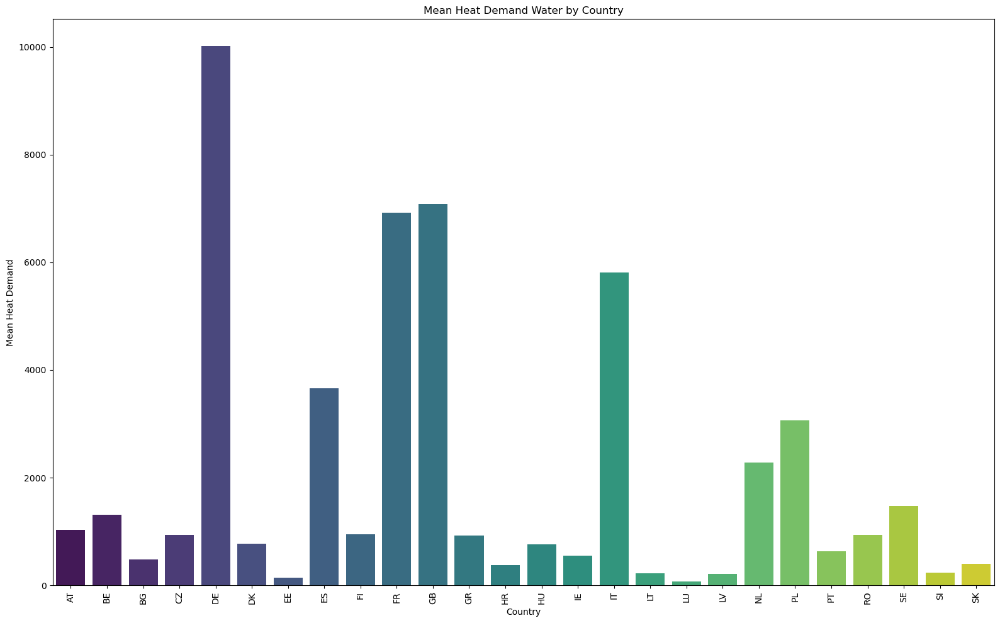

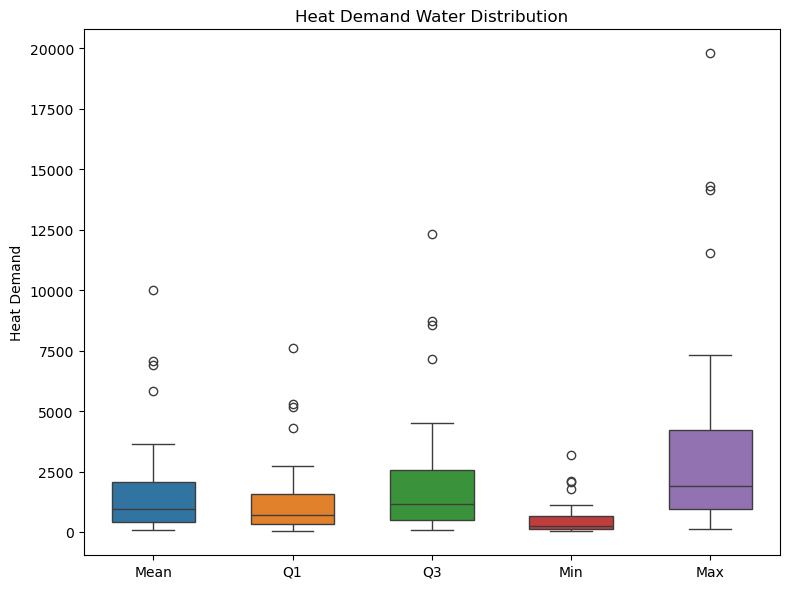

C:\Users\oppor\AppData\Local\Temp\ipykernel_8232\4274318051.py:25: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='country', y='range', data=country_summary_water, palette='coolwarm')


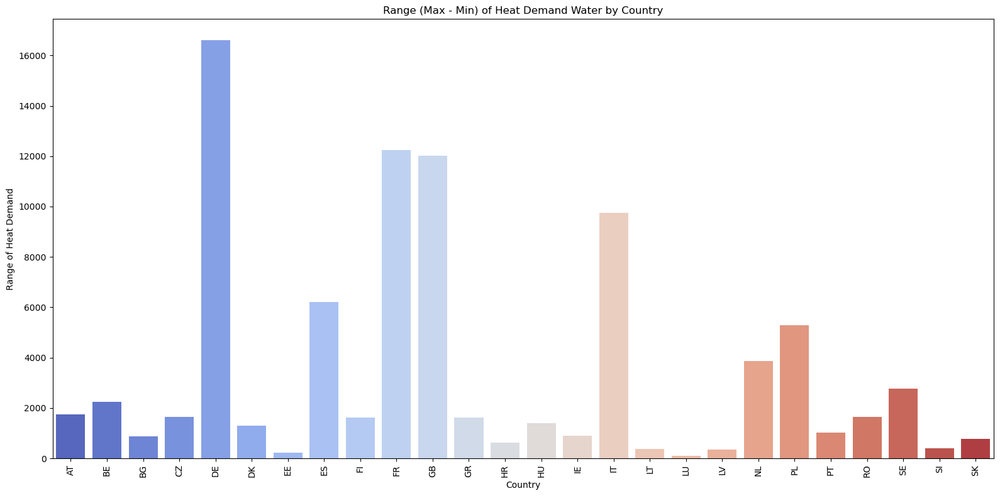

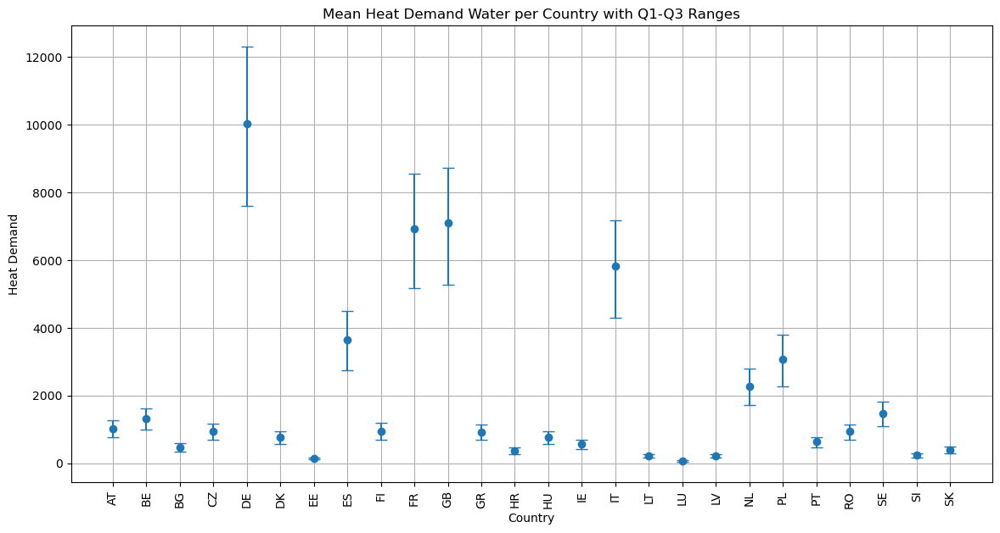

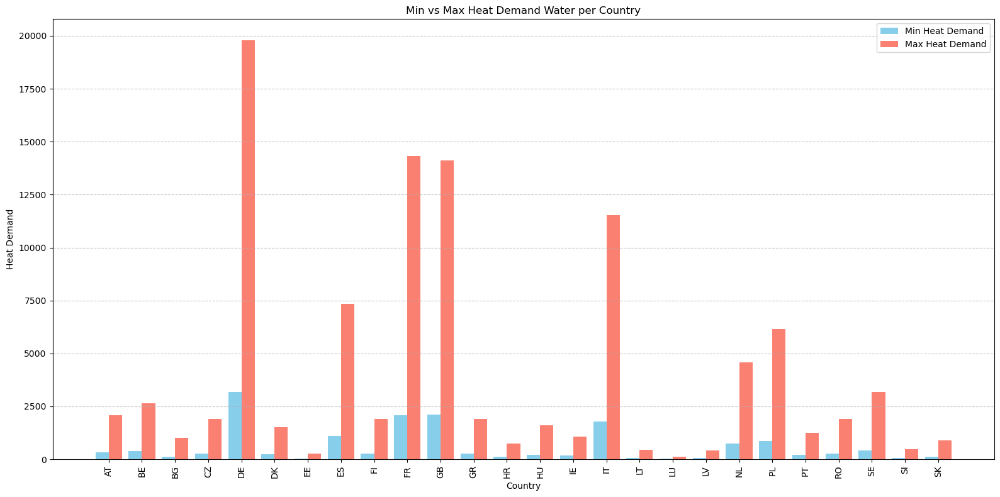

In [ ]:
# Creating the figure
plt.figure(figsize=(16, 10))

# 1. Using Bar Plot for mean heat demand across countries
sns.barplot(x='country', y='mean', data=country_summary_water, palette='viridis')
plt.title("Mean Heat Demand Water by Country")
plt.xticks(rotation=90)
plt.ylabel("Mean Heat Demand")
plt.xlabel("Country")
plt.tight_layout()  # Adjust layout to avoid overlap
plt.show()

# 2. Using Boxplot for distribution (Q1, Q3, Min, Max)
plt.figure(figsize=(8, 6))
sns.boxplot(data=country_summary_water[['mean', 'q1', 'q3', 'min', 'max']], width=0.6)
plt.title("Heat Demand Water Distribution")
plt.xticks(ticks=range(5), labels=['Mean', 'Q1', 'Q3', 'Min', 'Max'])
plt.ylabel("Heat Demand")
plt.tight_layout()
plt.show()

# 3. Using Bar Plot for the range (Max - Min) of heat demand water for each country
country_summary_water['range'] = country_summary_water['max'] - country_summary_water['min']
plt.figure(figsize=(16, 8))
sns.barplot(x='country', y='range', data=country_summary_water, palette='coolwarm')
plt.title("Range (Max - Min) of Heat Demand Water by Country")
plt.xticks(rotation=90)
plt.ylabel("Range of Heat Demand")
plt.xlabel("Country")
plt.tight_layout()
plt.show()

plt.figure(figsize=(14, 7))
plt.errorbar(
    country_summary_water['country'], 
    country_summary_water['mean'], 
    yerr=[country_summary_water['mean'] - country_summary_water['q1'], country_summary_water['q3'] - country_summary_water['mean']], 
    fmt='o', capsize=5
)
plt.xticks(rotation=90)
plt.title('Mean Heat Demand Water per Country with Q1-Q3 Ranges')
plt.ylabel('Heat Demand')
plt.xlabel('Country')
plt.grid(True)
plt.show()

plt.figure(figsize=(16, 8))

# Setting bar width
bar_width = 0.4

# Using Position of bars on x-axis
r1 = np.arange(len(country_summary_water))
r2 = [x + bar_width for x in r1]

# Ploting bars
plt.bar(r1, country_summary_water['min'], color='skyblue', width=bar_width, label='Min Heat Demand')
plt.bar(r2, country_summary_water['max'], color='salmon', width=bar_width, label='Max Heat Demand')

# Adding labels and title
plt.xlabel('Country')
plt.ylabel('Heat Demand')
plt.title('Min vs Max Heat Demand Water per Country')
plt.xticks([r + bar_width / 2 for r in range(len(country_summary_water))], country_summary_water['country'], rotation=90)
plt.legend()

# Adding grid
plt.grid(axis='y', linestyle='--', alpha=0.7)

# Using Tight layout to avoid clipping
plt.tight_layout()

# Showing plot
plt.show()

In [ ]:
# For First, ensure that cet_cest_timestamp is converted properly to datetime with timezone awareness
df['cet_cest_timestamp'] = pd.to_datetime(df['cet_cest_timestamp'], utc=True)

# Converting it to the correct local time zone if needed (assuming CET/CEST for your data)
df['cet_cest_timestamp'] = df['cet_cest_timestamp'].dt.tz_convert('Europe/Paris')

# Extracting the hour from the timestamp (now timezone-aware)
df['hour'] = df['cet_cest_timestamp'].dt.hour

# Check if the 'hour' column is extracted correctly
df[['cet_cest_timestamp', 'hour']].head()


# Defining aggregation functions
agg_funcs_hourly = {
    'heat_demand_water': [
        'mean',
        lambda x: x.quantile(0.25),
        lambda x: x.quantile(0.75),
        'min',
        'max'
    ]
}

# Grouping by 'country' and 'hour' and compute the stats
hourly_summary = df.groupby(['country', 'hour']).agg(agg_funcs_hourly).round(2)

# Renaming columns for clarity
def rename_hour_stat(col):
    stat_map = {
        '<lambda_0>': 'q1',
        '<lambda_1>': 'q3'
    }
    stat_name = stat_map.get(col[1], col[1])
    return f"{col[0]}_{stat_name}"

hourly_summary.columns = [rename_hour_stat(col) for col in hourly_summary.columns]

# Reseting index for cleaner display
hourly_summary.reset_index(inplace=True)

# Renaming columns for simplicity
hourly_summary.columns = ['country', 'hour', 'mean', 'q1', 'q3', 'min', 'max']

# Displaying only the first few rows (default 5) using head()
table_hourly_summary = tabulate(hourly_summary.head(), headers='keys', tablefmt='html', showindex=False)

# Using Style and wrap it in a scrollable div
styled_hourly_table = f"""
<div style="font-family: 'Arial', sans-serif; background-color: #f9f9f9; padding: 20px; border-radius: 10px; overflow-x: auto;">
    <h3 style="text-align: center; color: #4CAF50; font-size: 24px; font-weight: bold;">Country-wise Hourly Heat Demand Water Summary (Top 5)</h3>
    <table style="width: 100%; border-collapse: collapse; margin: 25px 0; font-size: 14px; text-align: center; border: 1px solid #ddd; word-wrap: break-word;">
        <thead style="background-color: #4CAF50; color: white; font-weight: bold;">
            {table_hourly_summary.split('<thead>')[1].split('</thead>')[0]}
        </thead>
        <tbody style="background-color: #ffffff;">
            {table_hourly_summary.split('<tbody>')[1].split('</tbody>')[0]}
        </tbody>
    </table>
</div>
"""

# Displaying the styled table
display(HTML(styled_hourly_table))

country,hour,mean,q1,q3,min,max
AT,0,371.38,354,382,323,517
AT,1,424.12,410,437,378,478
AT,2,409.97,395,425,328,495
AT,3,474.86,441,473,404,652
AT,4,762.82,720,780,639,971


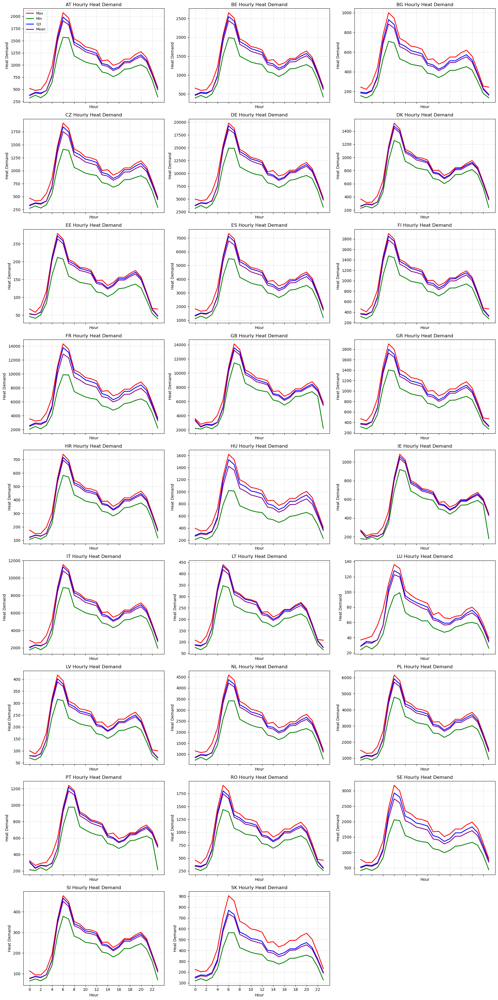

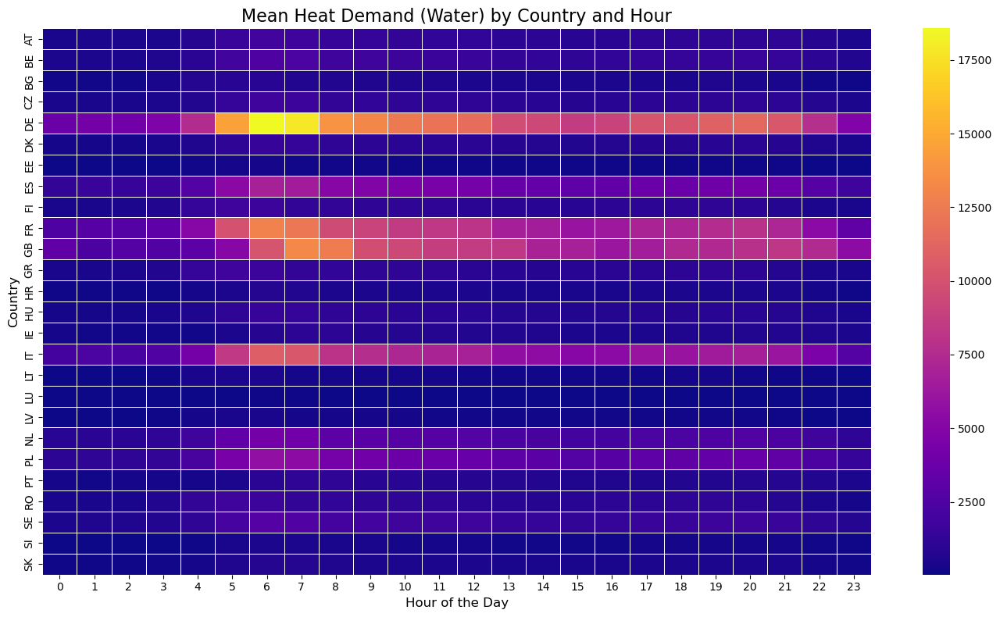

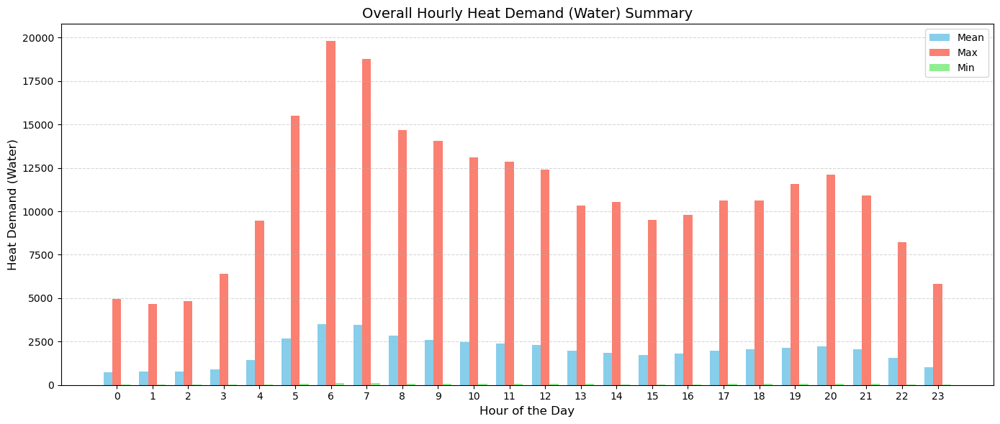

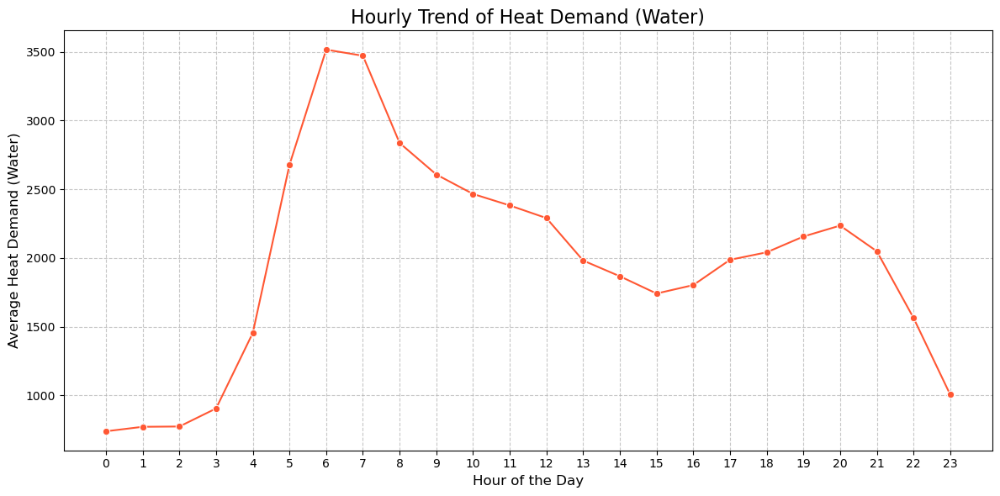

In [ ]:
# Using List of countries
countries = hourly_summary['country'].unique()

# Setting-up subplot grid
n_cols = 3
n_rows = (len(countries) // n_cols) + (len(countries) % n_cols > 0)
fig, axes = plt.subplots(n_rows, n_cols, figsize=(18, n_rows * 4), sharex=True, sharey=False)

axes = axes.flatten()

# Plotting loop
for i, country in enumerate(countries):
    country_data = hourly_summary[hourly_summary['country'] == country]
    
    ax = axes[i]
    ax.plot(country_data['hour'], country_data['max'], label='Max', color='red', linewidth=2)
    ax.plot(country_data['hour'], country_data['min'], label='Min', color='green', linewidth=2)
    ax.plot(country_data['hour'], country_data['q3'], label='Q3', color='blue', linewidth=2)
    ax.plot(country_data['hour'], country_data['mean'], label='Mean', color='purple', linewidth=2)
    
    ax.set_title(f"{country} Hourly Heat Demand", fontsize=12)
    ax.set_xlabel("Hour")
    ax.set_ylabel("Heat Demand")
    ax.grid(True, linestyle='--', alpha=0.5)
    ax.set_xticks(range(0, 24, 2))
    
    # Only adding legend to the first subplot for cleanliness
    if i == 0:
        ax.legend(loc='upper left', fontsize=9)

# Hiding any empty subplots
for j in range(i+1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()

df['cet_cest_timestamp'] = pd.to_datetime(df['cet_cest_timestamp'], utc=True)
df['cet_cest_timestamp'] = df['cet_cest_timestamp'].dt.tz_convert('Europe/Paris')
df['hour'] = df['cet_cest_timestamp'].dt.hour

# Grouping by country and hour, compute mean
pivot_mean = df.groupby(['country', 'hour'])['heat_demand_water'].mean().reset_index()

# Using Pivot for heatmap structure
heatmap_data = pivot_mean.pivot(index='country', columns='hour', values='heat_demand_water')

# Ploting heatmap
plt.figure(figsize=(14, 8))
sns.heatmap(heatmap_data, cmap='plasma', annot=False, linewidths=0.5)

plt.title('Mean Heat Demand (Water) by Country and Hour', fontsize=16)
plt.xlabel('Hour of the Day', fontsize=12)
plt.ylabel('Country', fontsize=12)
plt.tight_layout()
plt.show()


df['cet_cest_timestamp'] = pd.to_datetime(df['cet_cest_timestamp'], utc=True)
df['cet_cest_timestamp'] = df['cet_cest_timestamp'].dt.tz_convert('Europe/Paris')

# Extracting hour
df['hour'] = df['cet_cest_timestamp'].dt.hour

# Grouping overall by hour and compute mean, max, min
overall_hourly_summary = df.groupby('hour')['heat_demand_water'].agg(['mean', 'max', 'min']).reset_index()

# Setting positions and bar width
bar_width = 0.25
hours = overall_hourly_summary['hour'].values

r1 = np.arange(len(hours))
r2 = [x + bar_width for x in r1]
r3 = [x + bar_width for x in r2]

# Ploting grouped bar plot
plt.figure(figsize=(14, 6))
plt.bar(r1, overall_hourly_summary['mean'], width=bar_width, label='Mean', color='skyblue')
plt.bar(r2, overall_hourly_summary['max'], width=bar_width, label='Max', color='salmon')
plt.bar(r3, overall_hourly_summary['min'], width=bar_width, label='Min', color='lightgreen')

# Customizing plot
plt.xlabel('Hour of the Day', fontsize=12)
plt.ylabel('Heat Demand (Water)', fontsize=12)
plt.title('Overall Hourly Heat Demand (Water) Summary', fontsize=14)
plt.xticks([r + bar_width for r in range(len(hours))], hours)
plt.legend()
plt.grid(axis='y', linestyle='--', alpha=0.5)
plt.tight_layout()
plt.show() 

# Calculating overall hourly mean (not per country)
hourly_trend = df.groupby(df['cet_cest_timestamp'].dt.hour)['heat_demand_water'].mean().reset_index()

# Ploting
plt.figure(figsize=(12,6))
sns.lineplot(x='cet_cest_timestamp', y='heat_demand_water', data=hourly_trend, marker='o', color='#FF5733')

plt.title('Hourly Trend of Heat Demand (Water)', fontsize=16)
plt.xlabel('Hour of the Day', fontsize=12)
plt.ylabel('Average Heat Demand (Water)', fontsize=12)
plt.xticks(range(0, 24))
plt.grid(True, linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()


In [ ]:
# Ensuring timestamp is timezone-aware and converted to Europe/Paris
df['cet_cest_timestamp'] = pd.to_datetime(df['cet_cest_timestamp'], utc=True)
df['cet_cest_timestamp'] = df['cet_cest_timestamp'].dt.tz_convert('Europe/Paris')

# Creating 'week' column from ISO calendar week
df['week'] = df['cet_cest_timestamp'].dt.isocalendar().week

# Defining aggregation functions
agg_funcs_weekly = {
    'heat_demand_water': [
        'mean',
        lambda x: x.quantile(0.25),
        lambda x: x.quantile(0.75),
        'min',
        'max'
    ]
}

# Grouping by 'country' and 'week' and compute the stats
weekly_summary = df.groupby(['country', 'week']).agg(agg_funcs_weekly).round(2)

# Using Rename columns for clarity
def rename_week_stat(col):
    stat_map = {
        '<lambda_0>': 'q1',
        '<lambda_1>': 'q3'
    }
    stat_name = stat_map.get(col[1], col[1])
    return f"{col[0]}_{stat_name}"

weekly_summary.columns = [rename_week_stat(col) for col in weekly_summary.columns]

# Using Reset index for cleaner display
weekly_summary.reset_index(inplace=True)

# Using Rename columns for simplicity
weekly_summary.columns = ['country', 'week', 'mean', 'q1', 'q3', 'min', 'max']

# Converting to tabulated HTML for display
table_weekly_summary = tabulate(weekly_summary.head(), headers='keys', tablefmt='html', showindex=False)

# Using Style and wrap in a scrollable, nicely styled div
styled_weekly_table = f"""
<div style="font-family: 'Arial', sans-serif; background-color: #f9f9f9; padding: 20px; border-radius: 10px; overflow-x: auto;">
    <h3 style="text-align: center; color: #4CAF50; font-size: 24px; font-weight: bold;">Country-wise Weekly Heat Demand Water Summary (Top 5)</h3>
    <table style="width: 100%; border-collapse: collapse; margin: 25px 0; font-size: 14px; text-align: center; border: 1px solid #ddd; word-wrap: break-word;">
        <thead style="background-color: #4CAF50; color: white; font-weight: bold;">
            {table_weekly_summary.split('<thead>')[1].split('</thead>')[0]}
        </thead>
        <tbody style="background-color: #ffffff;">
            {table_weekly_summary.split('<tbody>')[1].split('</tbody>')[0]}
        </tbody>
    </table>
</div>
"""

# Displaying the styled table
display(HTML(styled_weekly_table))

country,week,mean,q1,q3,min,max
AT,1,1036.78,780,1274,342,2076
AT,2,1038.93,781.75,1275,342,2076
AT,3,1038.93,781.75,1275,342,2076
AT,4,1038.93,781.75,1275,342,2076
AT,5,1038.93,781.75,1275,342,2076


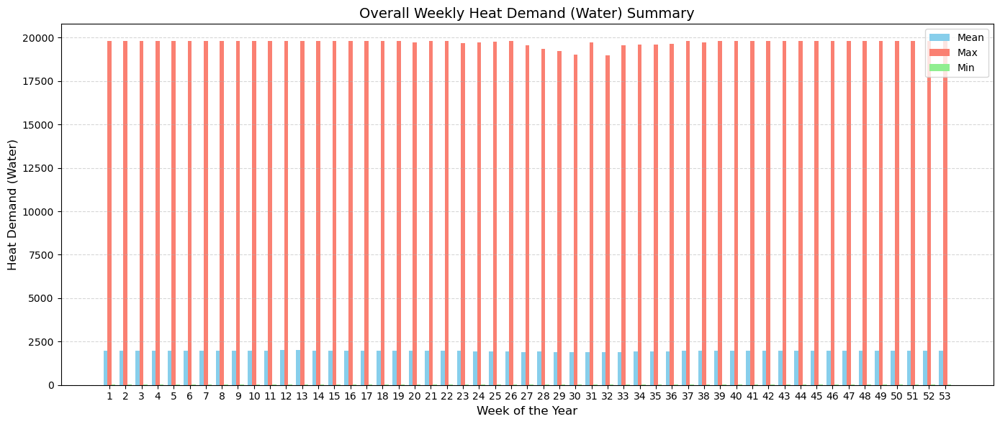

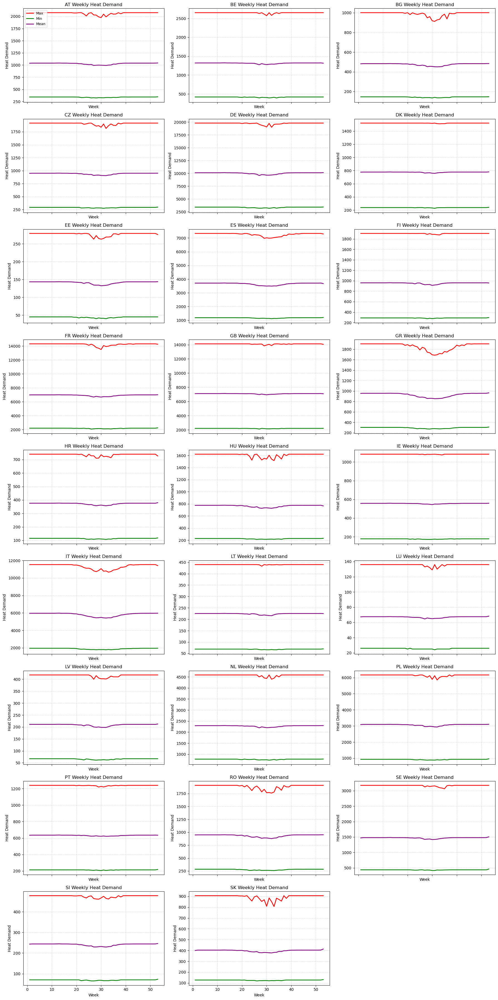

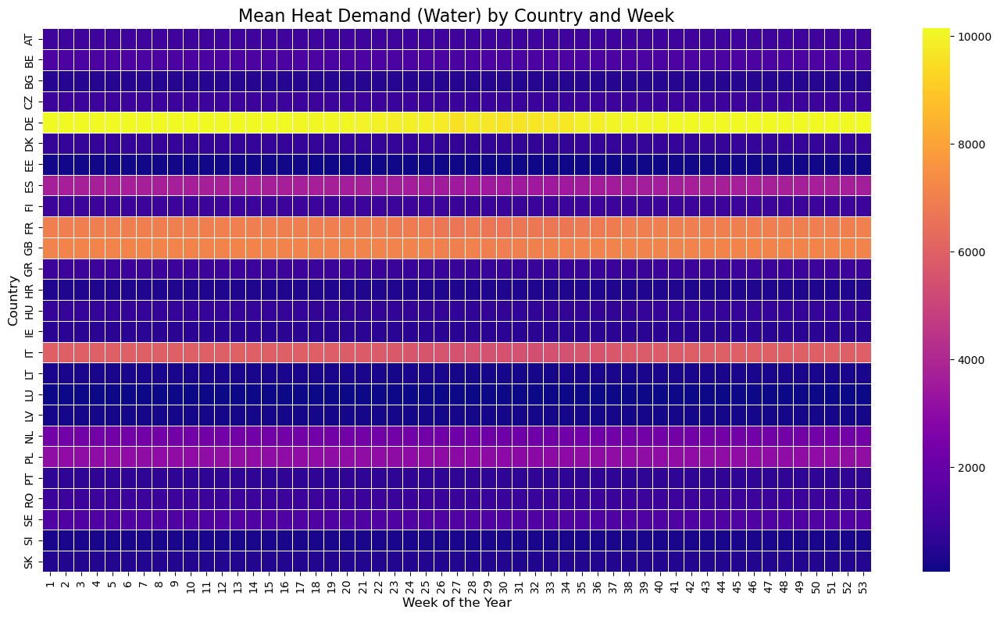

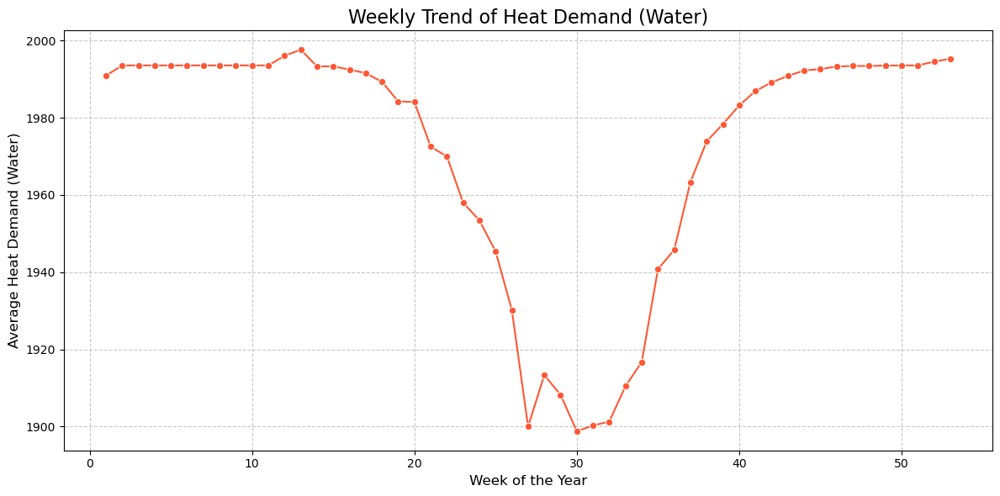

In [ ]:
# Grouping overall by week and compute mean, max, min
overall_weekly_summary = df.groupby('week')['heat_demand_water'].agg(['mean', 'max', 'min']).reset_index()

# Setting positions and bar width
bar_width = 0.25
weeks = overall_weekly_summary['week'].values

r1 = np.arange(len(weeks))
r2 = [x + bar_width for x in r1]
r3 = [x + bar_width for x in r2]

# Ploting grouped bar plot
plt.figure(figsize=(14, 6))
plt.bar(r1, overall_weekly_summary['mean'], width=bar_width, label='Mean', color='skyblue')
plt.bar(r2, overall_weekly_summary['max'], width=bar_width, label='Max', color='salmon')
plt.bar(r3, overall_weekly_summary['min'], width=bar_width, label='Min', color='lightgreen')

# Customizing plot
plt.xlabel('Week of the Year', fontsize=12)
plt.ylabel('Heat Demand (Water)', fontsize=12)
plt.title('Overall Weekly Heat Demand (Water) Summary', fontsize=14)
plt.xticks([r + bar_width for r in range(len(weeks))], weeks)
plt.legend()
plt.grid(axis='y', linestyle='--', alpha=0.5)
plt.tight_layout()
plt.show()



# Using List of countries
countries = weekly_summary['country'].unique()

# Setting-up subplot grid
n_cols = 3
n_rows = (len(countries) // n_cols) + (len(countries) % n_cols > 0)
fig, axes = plt.subplots(n_rows, n_cols, figsize=(18, n_rows * 4), sharex=True, sharey=False)

axes = axes.flatten()


# Plotting loop for weekly heat demand by country
for i, country in enumerate(countries):
    country_data = weekly_summary[weekly_summary['country'] == country]
    
    ax = axes[i]
    ax.plot(country_data['week'], country_data['max'], label='Max', color='red', linewidth=2)
    ax.plot(country_data['week'], country_data['min'], label='Min', color='green', linewidth=2)
    ax.plot(country_data['week'], country_data['mean'], label='Mean', color='purple', linewidth=2)
    
    ax.set_title(f"{country} Weekly Heat Demand", fontsize=12)
    ax.set_xlabel("Week")
    ax.set_ylabel("Heat Demand")
    ax.grid(True, linestyle='--', alpha=0.5)
    
    # Only adding legend to the first subplot for cleanliness
    if i == 0:
        ax.legend(loc='upper left', fontsize=9)

# Hiding any empty subplots
for j in range(i+1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()



# Using Pivot data for the heatmap (average heat demand for each country by week)
pivot_mean = df.groupby(['country', 'week'])['heat_demand_water'].mean().reset_index()
heatmap_data = pivot_mean.pivot(index='country', columns='week', values='heat_demand_water')

# Ploting heatmap
plt.figure(figsize=(14, 8))
sns.heatmap(heatmap_data, cmap='plasma', annot=False, linewidths=0.5)

plt.title('Mean Heat Demand (Water) by Country and Week', fontsize=16)
plt.xlabel('Week of the Year', fontsize=12)
plt.ylabel('Country', fontsize=12)
plt.tight_layout()
plt.show()



# Calculating overall weekly mean (not per country)
weekly_trend = df.groupby(df['cet_cest_timestamp'].dt.isocalendar().week)['heat_demand_water'].mean().reset_index()

# For Ploting
plt.figure(figsize=(12, 6))
sns.lineplot(x='week', y='heat_demand_water', data=weekly_trend, marker='o', color='#FF5733')

plt.title('Weekly Trend of Heat Demand (Water)', fontsize=16)
plt.xlabel('Week of the Year', fontsize=12)
plt.ylabel('Average Heat Demand (Water)', fontsize=12)
plt.grid(True, linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()


In [ ]:
# Converting timestamp to datetime if not already done
df['cet_cest_timestamp'] = pd.to_datetime(df['cet_cest_timestamp'], utc=True)
df['cet_cest_timestamp'] = df['cet_cest_timestamp'].dt.tz_convert('Europe/Paris')

# Creating 'month' and 'year' columns
df['month'] = df['cet_cest_timestamp'].dt.month

# Using For Monthly summary: mean, min, max grouped by country and month
monthly_summary = df.groupby(['country', 'month'])['heat_demand_water'].agg(['mean', 'min', 'max']).reset_index().round(2)

monthly_summary_table = tabulate(monthly_summary.head(), headers='keys', tablefmt='html', showindex=False)

# Using Style and wrap it in a scrollable div
styled_monthly_table = f"""
<div style="font-family: 'Arial', sans-serif; background-color: #f9f9f9; padding: 20px; border-radius: 10px; overflow-x: auto;">
    <h3 style="text-align: center; color: #4CAF50; font-size: 24px; font-weight: bold;">Country-wise Monthly Heat Demand Water Summary (Top 5)</h3>
    <table style="width: 100%; border-collapse: collapse; margin: 25px 0; font-size: 14px; text-align: center; border: 1px solid #ddd; word-wrap: break-word;">
        <thead style="background-color: #4CAF50; color: white; font-weight: bold;">
            {monthly_summary_table.split('<thead>')[1].split('</thead>')[0]}
        </thead>
        <tbody style="background-color: #ffffff;">
            {monthly_summary_table.split('<tbody>')[1].split('</tbody>')[0]}
        </tbody>
    </table>
</div>
"""

# Using the styled table
display(HTML(styled_monthly_table))

country,month,mean,min,max
AT,1,1038.94,342,2076
AT,2,1038.79,342,2076
AT,3,1039.5,342,2076
AT,4,1038.41,342,2076
AT,5,1031.85,329,2076


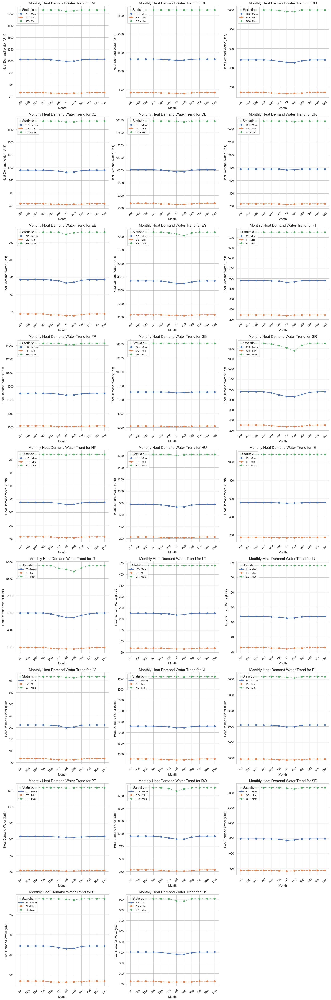

In [ ]:
# Setting seaborn style for consistency
sns.set(style="whitegrid")

# Determining the number of rows and columns for the subplot grid
n_cols = 3  # For Number of columns in the grid
n_rows = int(np.ceil(len(countries) / n_cols))  # Calculate rows needed to fit all countries

# Creating subplots with the appropriate number of rows and columns
fig, axes = plt.subplots(n_rows, n_cols, figsize=(n_cols * 6, n_rows * 6))

# Using Flatten axes array for easier iteration
axes = axes.flatten()

# Looping over each country and create a line plot in the corresponding subplot
for i, country in enumerate(countries):
    # Filtering the data for the current country
    country_data = monthly_summary[monthly_summary['country'] == country]
    
    # Selecting the subplot axis for the current country
    ax = axes[i]
    
    # Plotting each statistic (mean, min, max) for the country
    ax.plot(country_data['month'], country_data['mean'], label=f'{country} - Mean', marker='o', linewidth=2)
    ax.plot(country_data['month'], country_data['min'], label=f'{country} - Min', marker='o', linestyle='--', linewidth=2)
    ax.plot(country_data['month'], country_data['max'], label=f'{country} - Max', marker='o', linestyle=':', linewidth=2)
    
    # Using Title and labels for each plot
    ax.set_title(f'Monthly Heat Demand Water Trend for {country}', fontsize=14)
    ax.set_xlabel('Month', fontsize=12)
    ax.set_ylabel('Heat Demand Water (Unit)', fontsize=12)
    
    # Adjusting the legend for clarity
    ax.legend(title="Statistic", title_fontsize='13', loc='upper left', fontsize='10')
    
    # Rotating x-axis labels for better readability
    ax.set_xticks(range(1, 13))
    ax.set_xticklabels(['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec'], rotation=45)

# Hiding any extra subplots that are not needed (if the number of countries is less than the grid size)
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

# Adjusting layout for better spacing
plt.tight_layout()
plt.show()

C:\Users\oppor\AppData\Local\Temp\ipykernel_8232\1781982128.py:15: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.barplot(x="month", y="heat_demand_water", hue="stat", data=monthly_melted, palette=palette, ci=None)


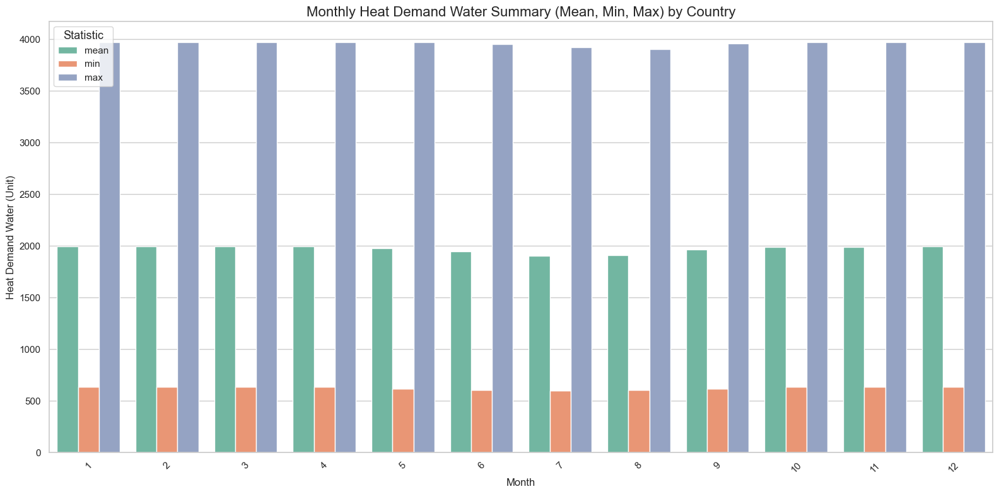

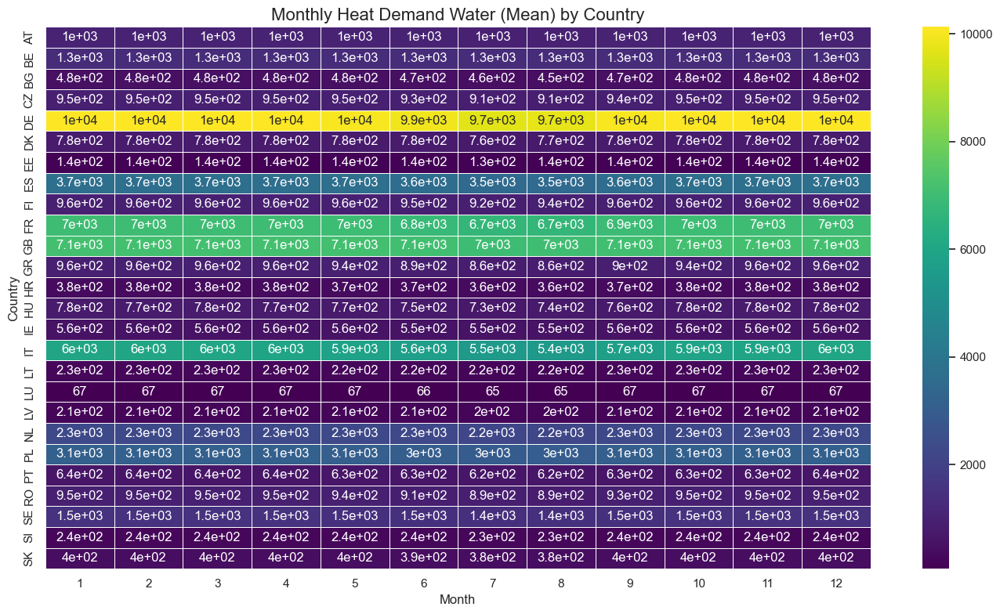

In [ ]:
# Setting figure size for better readability
plt.figure(figsize=(16, 8))

# Setting seaborn style
sns.set(style="whitegrid")

# Creating a grouped bar plot for mean, min, and max heat demand water by country and month
monthly_melted = monthly_summary.melt(id_vars=['country', 'month'], value_vars=['mean', 'min', 'max'], 
                                      var_name='stat', value_name='heat_demand_water')

# Setting color palette
palette = sns.color_palette("Set2", n_colors=3)

# Creating the barplot
sns.barplot(x="month", y="heat_demand_water", hue="stat", data=monthly_melted, palette=palette, ci=None)

# Rotating x-axis labels for better readability
plt.xticks(rotation=45)

# For Title and labels
plt.title('Monthly Heat Demand Water Summary (Mean, Min, Max) by Country', fontsize=16)
plt.xlabel('Month', fontsize=12)
plt.ylabel('Heat Demand Water (Unit)', fontsize=12)

# Adjusting the legend
plt.legend(title="Statistic", title_fontsize='13', loc='upper left', fontsize='11')

# Displaying the plot
plt.tight_layout()
plt.show()




# Using Pivot the data to create a heatmap-ready format
heatmap_data = monthly_summary.pivot(index='country', columns='month', values='mean')

# Setting-up the heatmap
plt.figure(figsize=(14, 8))
sns.heatmap(heatmap_data, cmap='viridis', annot=True, linewidths=0.5)

# For Title and labels
plt.title('Monthly Heat Demand Water (Mean) by Country', fontsize=16)
plt.xlabel('Month', fontsize=12)
plt.ylabel('Country', fontsize=12)

# Displaying the plot
plt.tight_layout()
plt.show()




In [ ]:
# Ensuring timestamp is converted to datetime with timezone awareness
df['cet_cest_timestamp'] = pd.to_datetime(df['cet_cest_timestamp'], utc=True)
df['cet_cest_timestamp'] = df['cet_cest_timestamp'].dt.tz_convert('Europe/Paris')

# Creating 'year' column
df['year'] = df['cet_cest_timestamp'].dt.year

# For Yearly summary: mean, min, max grouped by country and year
yearly_summary = df.groupby(['country', 'year'])['heat_demand_water'].agg(['mean', 'min', 'max']).reset_index().round(2)

# Converting to HTML table format with tabulate
yearly_summary_table = tabulate(yearly_summary.head(), headers='keys', tablefmt='html', showindex=False)

# For Style and wrap it in a scrollable div (same format you requested)
styled_yearly_table = f"""
<div style="font-family: 'Arial', sans-serif; background-color: #f9f9f9; padding: 20px; border-radius: 10px; overflow-x: auto;">
    <h3 style="text-align: center; color: #4CAF50; font-size: 24px; font-weight: bold;">Country-wise Yearly Heat Demand Water Summary (Top 5)</h3>
    <table style="width: 100%; border-collapse: collapse; margin: 25px 0; font-size: 14px; text-align: center; border: 1px solid #ddd; word-wrap: break-word;">
        <thead style="background-color: #4CAF50; color: white; font-weight: bold;">
            {yearly_summary_table.split('<thead>')[1].split('</thead>')[0]}
        </thead>
        <tbody style="background-color: #ffffff;">
            {yearly_summary_table.split('<tbody>')[1].split('</tbody>')[0]}
        </tbody>
    </table>
</div>
"""

# Displaying the styled table
display(HTML(styled_yearly_table))

country,year,mean,min,max
AT,2007,344,344,344
AT,2008,981,324,1887
AT,2009,997.72,327,1918
AT,2010,1010.62,323,1943
AT,2011,1022.66,328,1967


C:\Users\oppor\AppData\Local\Temp\ipykernel_8232\677077017.py:11: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.barplot(x="year", y="heat_demand_water", hue="stat", data=yearly_melted, palette=palette, ci=None)


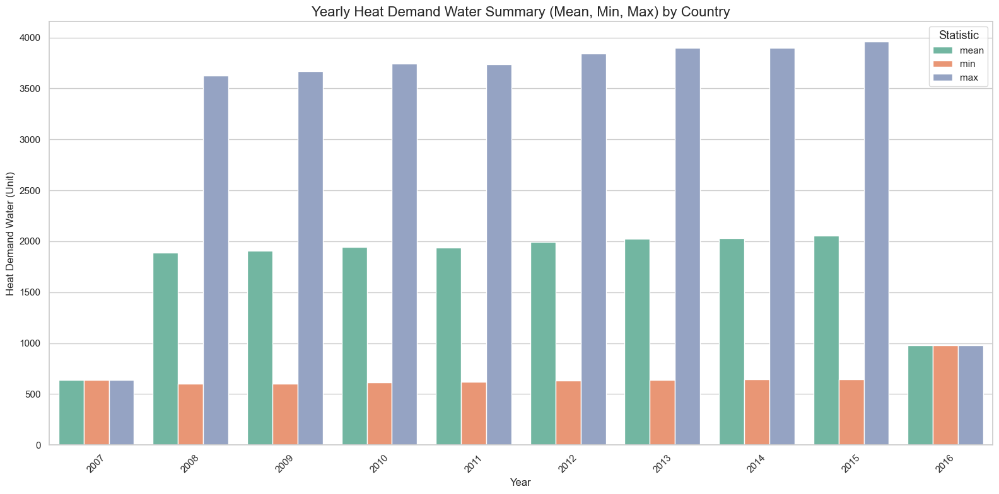

C:\Users\oppor\AppData\Local\Temp\ipykernel_8232\677077017.py:33: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.barplot(x="year", y="heat_demand_water", hue="stat", data=yearly_melted, palette=palette, ci=None)


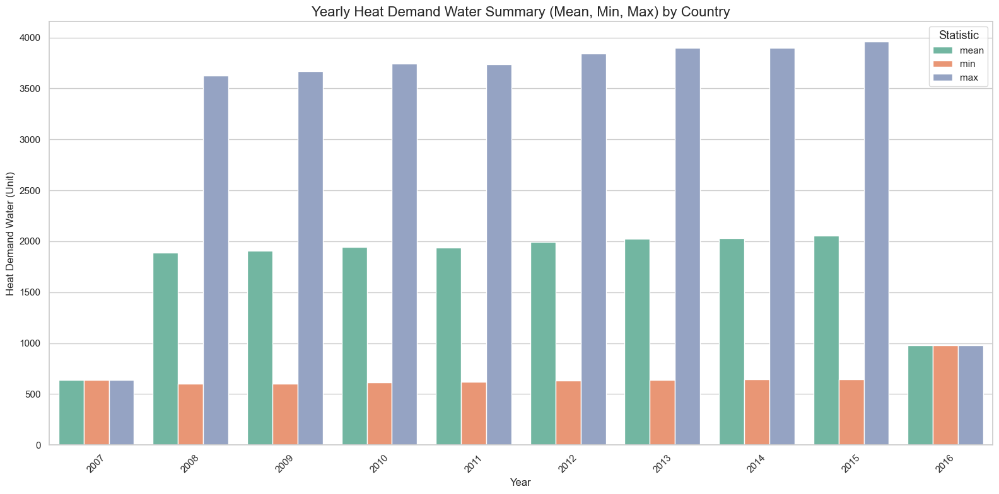

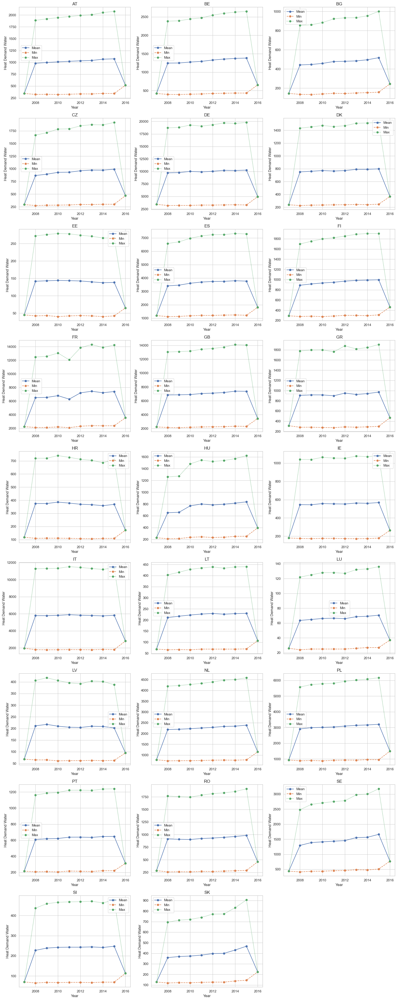

In [ ]:
# Melting the summary for plotting
yearly_melted = yearly_summary.melt(id_vars=['country', 'year'], value_vars=['mean', 'min', 'max'], 
                                    var_name='stat', value_name='heat_demand_water')

# Setting seaborn style
sns.set(style="whitegrid")

plt.figure(figsize=(16, 8))
palette = sns.color_palette("Set2", n_colors=3)

sns.barplot(x="year", y="heat_demand_water", hue="stat", data=yearly_melted, palette=palette, ci=None)

plt.title('Yearly Heat Demand Water Summary (Mean, Min, Max) by Country', fontsize=16)
plt.xlabel('Year', fontsize=12)
plt.ylabel('Heat Demand Water (Unit)', fontsize=12)
plt.legend(title="Statistic", title_fontsize='13', loc='upper right', fontsize='11')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()



# Melting the summary for plotting
yearly_melted = yearly_summary.melt(id_vars=['country', 'year'], value_vars=['mean', 'min', 'max'], 
                                    var_name='stat', value_name='heat_demand_water')

# Setting seaborn style
sns.set(style="whitegrid")

plt.figure(figsize=(16, 8))
palette = sns.color_palette("Set2", n_colors=3)

sns.barplot(x="year", y="heat_demand_water", hue="stat", data=yearly_melted, palette=palette, ci=None)

plt.title('Yearly Heat Demand Water Summary (Mean, Min, Max) by Country', fontsize=16)
plt.xlabel('Year', fontsize=12)
plt.ylabel('Heat Demand Water (Unit)', fontsize=12)
plt.legend(title="Statistic", title_fontsize='13', loc='upper right', fontsize='11')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()



# For Number of countries
n_countries = len(countries)
cols = 3
rows = int(np.ceil(n_countries / cols))

fig, axes = plt.subplots(rows, cols, figsize=(18, 5 * rows))

for i, country in enumerate(countries):
    ax = axes.flat[i]
    country_data = yearly_summary[yearly_summary['country'] == country]
    ax.plot(country_data['year'], country_data['mean'], label='Mean', marker='o')
    ax.plot(country_data['year'], country_data['min'], label='Min', marker='o', linestyle='--')
    ax.plot(country_data['year'], country_data['max'], label='Max', marker='o', linestyle=':')
    ax.set_title(f"{country}", fontsize=14)
    ax.set_xlabel("Year")
    ax.set_ylabel("Heat Demand Water")
    ax.legend()

# Removing empty subplots if any
for j in range(i+1, len(axes.flat)):
    fig.delaxes(axes.flat[j])

plt.tight_layout()
plt.show()

year,mean,min,max
2007,640.69,26,3429
2008,1886.38,24,18713
2009,1905.38,25,18813
2010,1944.96,25,19281
2011,1940.72,25,19062
2012,1992.92,25,19325
2013,2022.5,26,19702
2014,2027.64,27,19601
2015,2052.86,27,19800
2016,976.5,37,4967


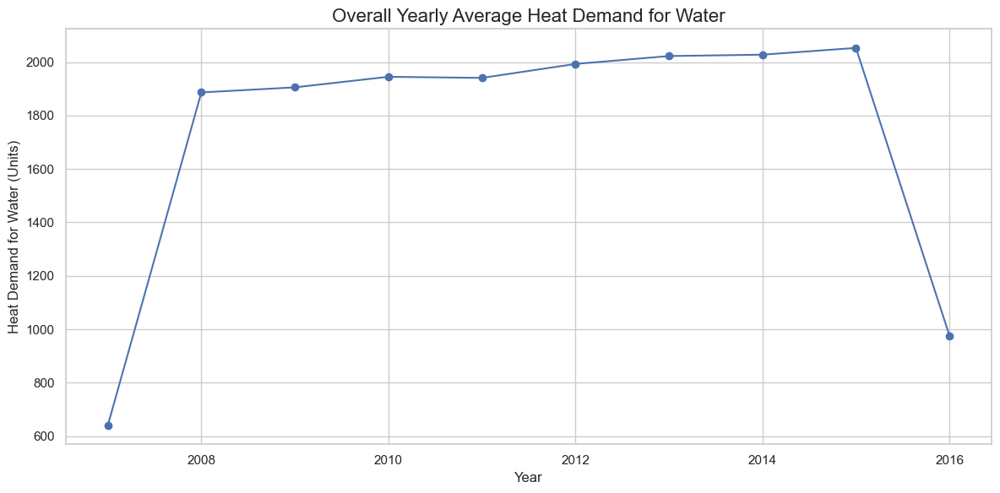

In [ ]:
# Ensuring timestamp is converted to datetime with timezone awareness
df['cet_cest_timestamp'] = pd.to_datetime(df['cet_cest_timestamp'], utc=True)
df['cet_cest_timestamp'] = df['cet_cest_timestamp'].dt.tz_convert('Europe/Paris')

# Creating a 'year' column based on the timestamp
df['year'] = df['cet_cest_timestamp'].dt.year

# For Overall yearly summary: mean, min, max for the entire dataset (no country grouping)
yearly_summary = df.groupby('year')['heat_demand_water'].agg(['mean', 'min', 'max']).reset_index().round(2)

# Converting the aggregated yearly data to HTML table format using tabulate
yearly_summary_table = tabulate(yearly_summary, headers='keys', tablefmt='html', showindex=False)

# For Style and wrap the table in a scrollable div
styled_yearly_table = f"""
<div style="font-family: 'Arial', sans-serif; background-color: #f9f9f9; padding: 20px; border-radius: 10px; overflow-x: auto;">
    <h3 style="text-align: center; color: #4CAF50; font-size: 24px; font-weight: bold;">Overall Yearly Heat Demand Water Summary (Top 5)</h3>
    <table style="width: 100%; border-collapse: collapse; margin: 25px 0; font-size: 14px; text-align: center; border: 1px solid #ddd; word-wrap: break-word;">
        <thead style="background-color: #4CAF50; color: white; font-weight: bold;">
            {yearly_summary_table.split('<thead>')[1].split('</thead>')[0]}
        </thead>
        <tbody style="background-color: #ffffff;">
            {yearly_summary_table.split('<tbody>')[1].split('</tbody>')[0]}
        </tbody>
    </table>
</div>
"""

# Displaying the styled table in Jupyter Notebook
display(HTML(styled_yearly_table))

# Setting-up seaborn style
sns.set(style="whitegrid")

# Creating the plot for the overall yearly trend
plt.figure(figsize=(12, 6))
plt.plot(yearly_summary['year'], yearly_summary['mean'], marker='o', linestyle='-', color='b')

# Adding labels and title
plt.title('Overall Yearly Average Heat Demand for Water', fontsize=16)
plt.xlabel('Year', fontsize=12)
plt.ylabel('Heat Demand for Water (Units)', fontsize=12)

# Showing the plot
plt.tight_layout()
plt.show()

In [ ]:
# Defining aggregation functions for heat_demand_space
agg_funcs_space = {
    'heat_demand_space': [
        'mean',
        lambda x: x.quantile(0.25),  # Q1 (lower quartile)
        lambda x: x.quantile(0.75),  # Q3 (upper quartile)
        'min', 
        'max'
    ]
}

# Grouping by country and compute the stats for heat_demand_space
country_summary_space = df.groupby('country').agg(agg_funcs_space).round(2)

# Renaming columns for clarity
def rename_stat(col):
    stat_map = {
        '<lambda_0>': 'q1',
        '<lambda_1>': 'q3'
    }
    stat_name = stat_map.get(col[1], col[1])
    return f"{col[0]}_{stat_name}"

country_summary_space.columns = [rename_stat(col) for col in country_summary_space.columns]

# Using Reset index for clean display
country_summary_space.reset_index(inplace=True)

# Using Rename columns for simplicity
country_summary_space.columns = [
    'country', 
    'mean', 
    'q1', 
    'q3', 
    'min', 
    'max'
]

# Converting to HTML table using tabulate
table_country_summary_space = tabulate(country_summary_space, headers='keys', tablefmt='html', showindex=False)

# Using Style and wrap it in a scrollable div
styled_country_table_space = f"""
<div style="font-family: 'Arial', sans-serif; background-color: #f9f9f9; padding: 20px; border-radius: 10px; overflow-x: auto;">
    <h3 style="text-align: center; color: #4CAF50; font-size: 24px; font-weight: bold;">Country-wise Heat Demand Space Summary</h3>
    <table style="width: 100%; border-collapse: collapse; margin: 25px 0; font-size: 14px; text-align: center; border: 1px solid #ddd; word-wrap: break-word;">
        <thead style="background-color: #4CAF50; color: white; font-weight: bold;">
            {table_country_summary_space.split('<thead>')[1].split('</thead>')[0]}
        </thead>
        <tbody style="background-color: #ffffff;">
            {table_country_summary_space.split('<tbody>')[1].split('</tbody>')[0]}
        </tbody>
    </table>
</div>
"""

# Displaying the styled table
display(HTML(styled_country_table_space))

country,mean,q1,q3,min,max
AT,5521.27,1450,9033.75,33,21497
BE,7920.48,2259,12409,33,21886
BG,1199.39,187,1999,5,5687
CZ,5852.16,1297,9631,10,21886
DE,17238.4,11739.5,21886,111,21886
DK,4099.58,1194,6446.75,22,15422
EE,808.92,92,1356,1,4056
ES,8629.78,2008.5,14342,127,21886
FI,6205.32,1479,9878,14,21886
FR,16291.2,9120,21886,226,21886


C:\Users\oppor\AppData\Local\Temp\ipykernel_8232\4200495809.py:3: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='country', y='mean', data=country_summary_space, palette='viridis')


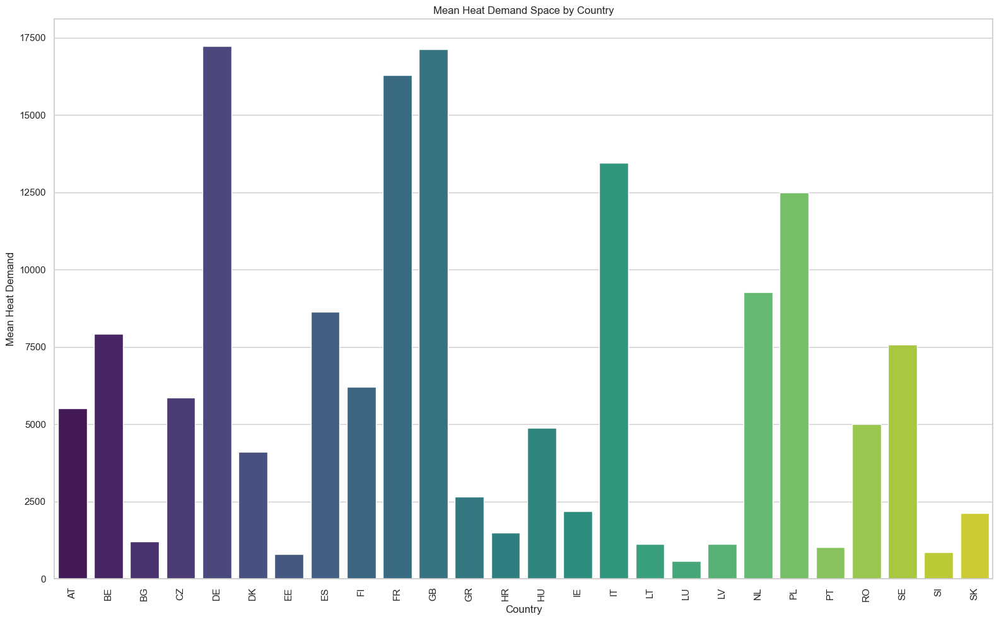

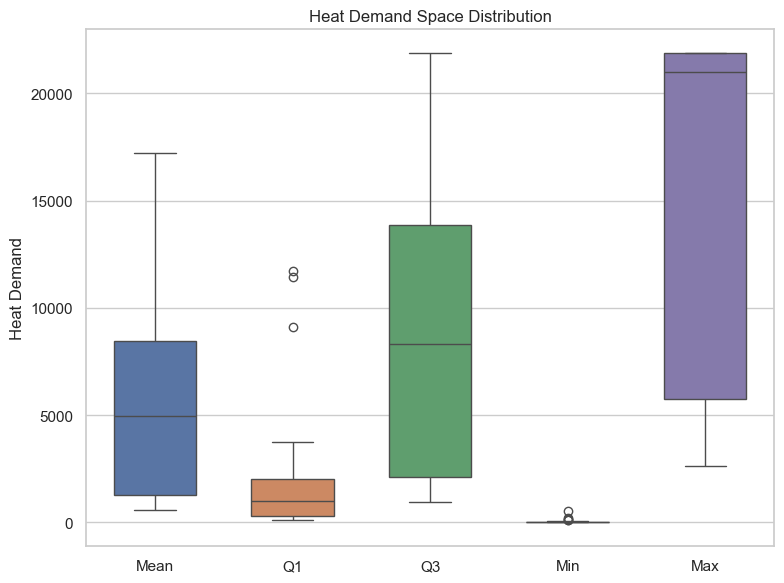

C:\Users\oppor\AppData\Local\Temp\ipykernel_8232\4200495809.py:23: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='country', y='range', data=country_summary_space, palette='coolwarm')


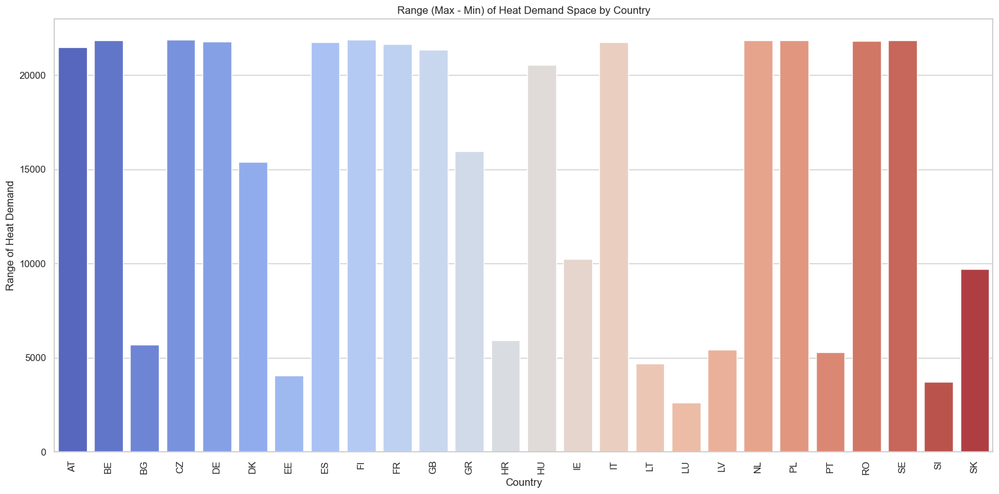

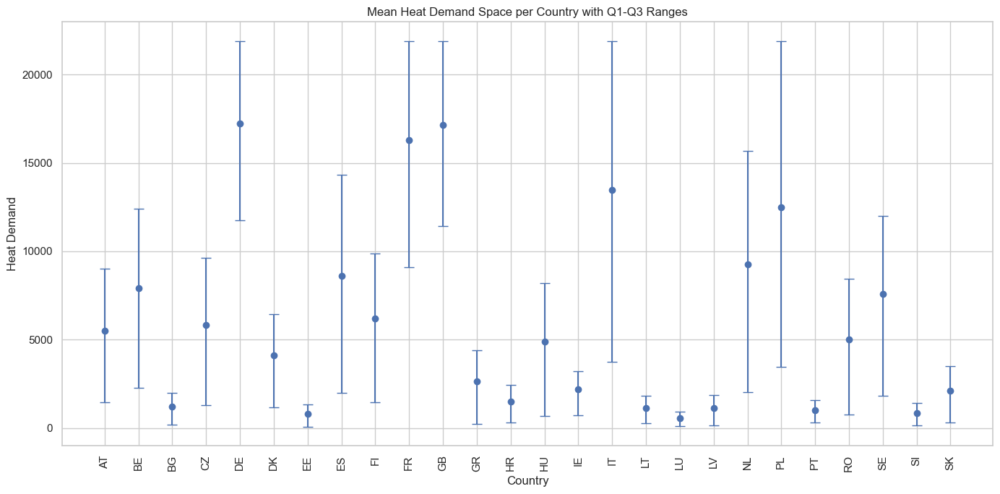

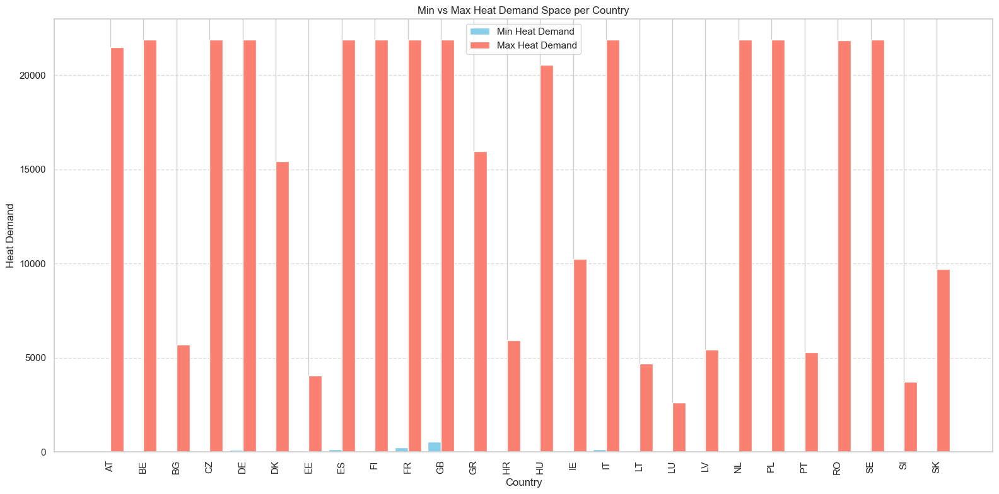

In [ ]:
# 1. Using Bar Plot for mean heat demand (space) across countries
plt.figure(figsize=(16, 10))
sns.barplot(x='country', y='mean', data=country_summary_space, palette='viridis')
plt.title("Mean Heat Demand Space by Country")
plt.xticks(rotation=90)
plt.ylabel("Mean Heat Demand")
plt.xlabel("Country")
plt.tight_layout()
plt.show()

# 2. Using Boxplot for distribution (Q1, Q3, Min, Max)
plt.figure(figsize=(8, 6))
sns.boxplot(data=country_summary_space[['mean', 'q1', 'q3', 'min', 'max']], width=0.6)
plt.title("Heat Demand Space Distribution")
plt.xticks(ticks=range(5), labels=['Mean', 'Q1', 'Q3', 'Min', 'Max'])
plt.ylabel("Heat Demand")
plt.tight_layout()
plt.show()

# 3. Using Bar Plot for the range (Max - Min) of heat demand space for each country
country_summary_space['range'] = country_summary_space['max'] - country_summary_space['min']
plt.figure(figsize=(16, 8))
sns.barplot(x='country', y='range', data=country_summary_space, palette='coolwarm')
plt.title("Range (Max - Min) of Heat Demand Space by Country")
plt.xticks(rotation=90)
plt.ylabel("Range of Heat Demand")
plt.xlabel("Country")
plt.tight_layout()
plt.show()

# 4. For Error bar plot (Mean with Q1-Q3 Ranges)
plt.figure(figsize=(14, 7))
plt.errorbar(
    country_summary_space['country'], 
    country_summary_space['mean'], 
    yerr=[country_summary_space['mean'] - country_summary_space['q1'], country_summary_space['q3'] - country_summary_space['mean']], 
    fmt='o', capsize=5
)
plt.xticks(rotation=90)
plt.title('Mean Heat Demand Space per Country with Q1-Q3 Ranges')
plt.ylabel('Heat Demand')
plt.xlabel('Country')
plt.grid(True)
plt.tight_layout()
plt.show()

# 5. Using Side-by-side bar plot: Min vs Max Heat Demand (Space)
plt.figure(figsize=(16, 8))

# Setting bar width
bar_width = 0.4

# For Position of bars on x-axis
r1 = np.arange(len(country_summary_space))
r2 = [x + bar_width for x in r1]

# Ploting bars
plt.bar(r1, country_summary_space['min'], color='skyblue', width=bar_width, label='Min Heat Demand')
plt.bar(r2, country_summary_space['max'], color='salmon', width=bar_width, label='Max Heat Demand')

# Adding labels and title
plt.xlabel('Country')
plt.ylabel('Heat Demand')
plt.title('Min vs Max Heat Demand Space per Country')
plt.xticks([r + bar_width / 2 for r in range(len(country_summary_space))], country_summary_space['country'], rotation=90)
plt.legend()

# Adding grid
plt.grid(axis='y', linestyle='--', alpha=0.7)

# For Tight layout
plt.tight_layout()

# Showing plot
plt.show()


In [ ]:
# Grouping by 'country' and 'hour', then calculating descriptive statistics for 'heat_demand_space'
country_hourly_summary = df.groupby(['country', 'hour'])['heat_demand_space'].agg(
    mean='mean',
    min='min',
    max='max',
    q1=lambda x: x.quantile(0.25),
    q3=lambda x: x.quantile(0.75)
).reset_index().round(2)

# Converting the DataFrame to an HTML table using tabulate
country_hourly_summary_table = tabulate(country_hourly_summary.head(35), headers='keys', tablefmt='html', showindex=False)

# For Style and wrap the table in a scrollable div (with new title for country-based data)
styled_country_hourly_table = f"""
<div style="font-family: 'Arial', sans-serif; background-color: #f9f9f9; padding: 20px; border-radius: 10px; overflow-x: auto;">
    <h3 style="text-align: center; color: #4CAF50; font-size: 24px; font-weight: bold;">Overall Country-wise Hourly Heat Demand Space Summary</h3>
    <table style="width: 100%; border-collapse: collapse; margin: 25px 0; font-size: 14px; text-align: center; border: 1px solid #ddd; word-wrap: break-word;">
        <thead style="background-color: #4CAF50; color: white; font-weight: bold;">
            {country_hourly_summary_table.split('<thead>')[1].split('</thead>')[0]}
        </thead>
        <tbody style="background-color: #ffffff;">
            {country_hourly_summary_table.split('<tbody>')[1].split('</tbody>')[0]}
        </tbody>
    </table>
</div>
"""

# Displaying the styled table in Jupyter Notebook
display(HTML(styled_country_hourly_table))

country,hour,mean,min,max,q1,q3
AT,0,3521.31,34,12616,776.5,5958.5
AT,1,3612.79,33,12584,800,6128.75
AT,2,3708.59,34,12791,841.25,6287.75
AT,3,4014.42,39,13387,990.25,6751.5
AT,4,4615.35,63,13818,1312.5,7633.75
AT,5,5989.81,114,16720,1818.25,9858.75
AT,6,7066.55,146,21497,2144.25,11491.5
AT,7,6828.06,141,20133,2086.5,11093.2
AT,8,6830.52,122,20009,2033.25,11181.8
AT,9,6476.26,119,19041,1893.25,10733.5


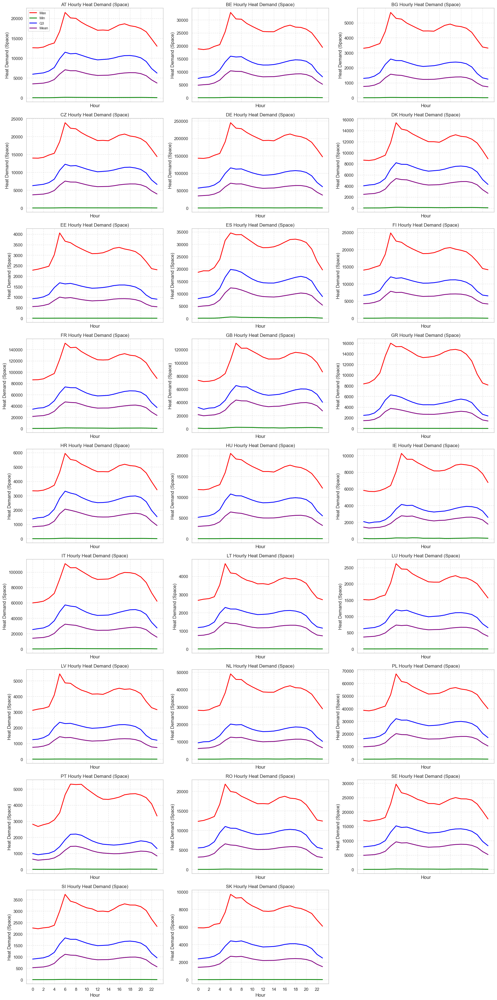

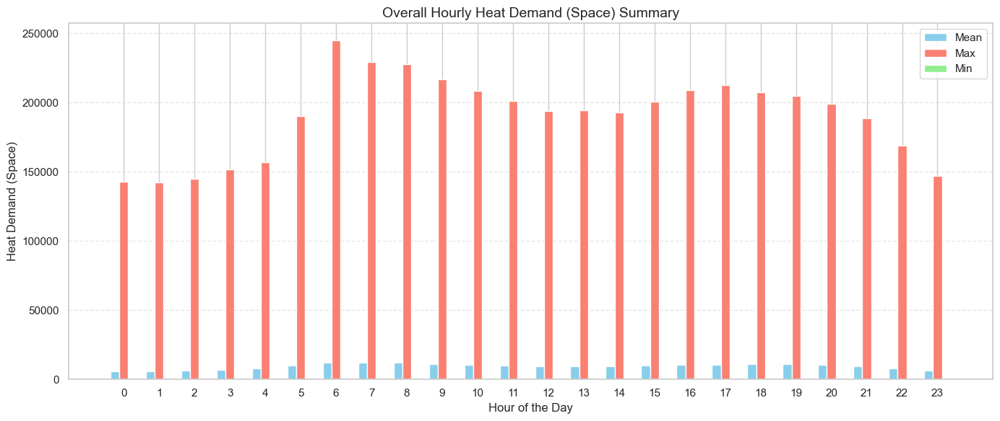

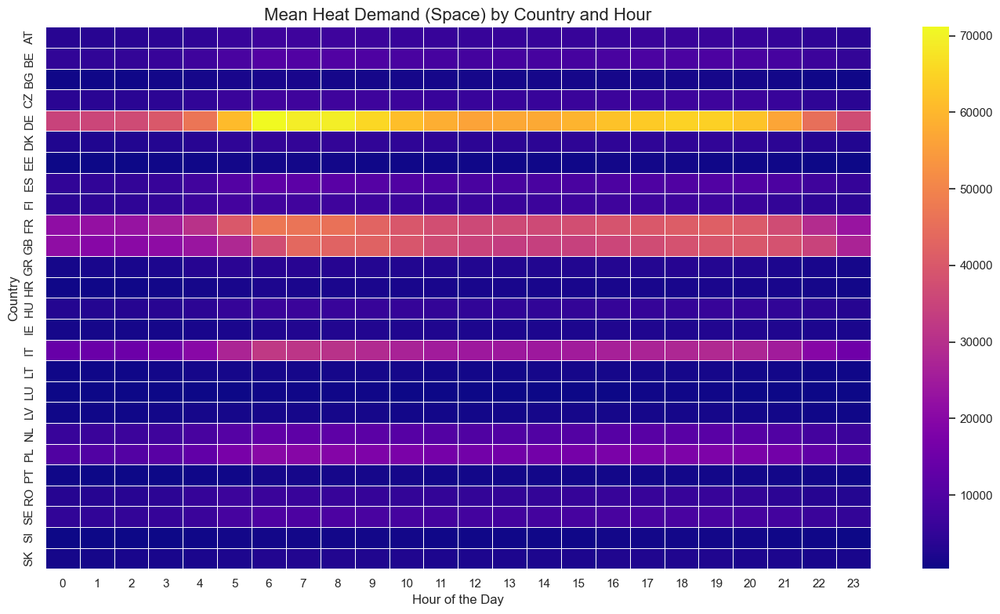

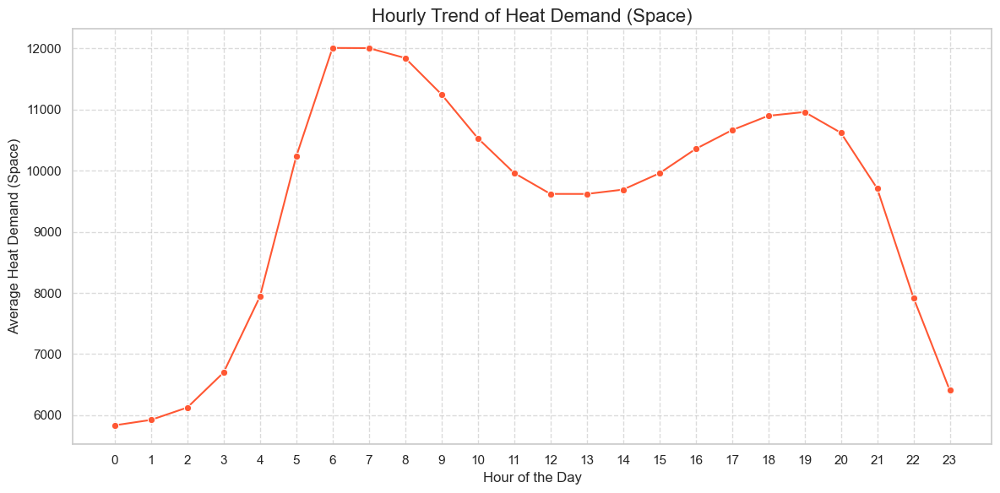

In [ ]:
# For List of countries
countries = country_hourly_summary['country'].unique()

# Setting-up subplot grid
n_cols = 3
n_rows = (len(countries) // n_cols) + (len(countries) % n_cols > 0)
fig, axes = plt.subplots(n_rows, n_cols, figsize=(18, n_rows * 4), sharex=True, sharey=False)

axes = axes.flatten()

# Plotting loop for Heat Demand (Space)
for i, country in enumerate(countries):
    country_data = country_hourly_summary[country_hourly_summary['country'] == country]
    
    ax = axes[i]
    ax.plot(country_data['hour'], country_data['max'], label='Max', color='red', linewidth=2)
    ax.plot(country_data['hour'], country_data['min'], label='Min', color='green', linewidth=2)
    ax.plot(country_data['hour'], country_data['q3'], label='Q3', color='blue', linewidth=2)
    ax.plot(country_data['hour'], country_data['mean'], label='Mean', color='purple', linewidth=2)
    
    ax.set_title(f"{country} Hourly Heat Demand (Space)", fontsize=12)
    ax.set_xlabel("Hour")
    ax.set_ylabel("Heat Demand (Space)")
    ax.grid(True, linestyle='--', alpha=0.5)
    ax.set_xticks(range(0, 24, 2))
    
    # Only adding legend to the first subplot for cleanliness
    if i == 0:
        ax.legend(loc='upper left', fontsize=9)

# Hiding any empty subplots
for j in range(i+1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()





# Grouping overall by hour and compute mean, max, min for heat demand (space)
overall_hourly_summary_space = df.groupby('hour')['heat_demand_space'].agg(['mean', 'max', 'min']).reset_index()

# Setting positions and bar width
bar_width = 0.25
hours = overall_hourly_summary_space['hour'].values

r1 = np.arange(len(hours))
r2 = [x + bar_width for x in r1]
r3 = [x + bar_width for x in r2]

# Ploting grouped bar plot for heat demand (space)
plt.figure(figsize=(14, 6))
plt.bar(r1, overall_hourly_summary_space['mean'], width=bar_width, label='Mean', color='skyblue')
plt.bar(r2, overall_hourly_summary_space['max'], width=bar_width, label='Max', color='salmon')
plt.bar(r3, overall_hourly_summary_space['min'], width=bar_width, label='Min', color='lightgreen')

# Customizing plot
plt.xlabel('Hour of the Day', fontsize=12)
plt.ylabel('Heat Demand (Space)', fontsize=12)
plt.title('Overall Hourly Heat Demand (Space) Summary', fontsize=14)
plt.xticks([r + bar_width for r in range(len(hours))], hours)
plt.legend()
plt.grid(axis='y', linestyle='--', alpha=0.5)
plt.tight_layout()
plt.show()




# Grouping by country and hour, compute mean for heat demand (space)
pivot_mean_space = df.groupby(['country', 'hour'])['heat_demand_space'].mean().reset_index()

# Using Pivot data for heatmap structure
heatmap_data_space = pivot_mean_space.pivot(index='country', columns='hour', values='heat_demand_space')

# Ploting heatmap
plt.figure(figsize=(14, 8))
sns.heatmap(heatmap_data_space, cmap='plasma', annot=False, linewidths=0.5)

plt.title('Mean Heat Demand (Space) by Country and Hour', fontsize=16)
plt.xlabel('Hour of the Day', fontsize=12)
plt.ylabel('Country', fontsize=12)
plt.tight_layout()
plt.show()




# Calculating overall hourly mean for heat demand (space)
hourly_trend_space = df.groupby(df['cet_cest_timestamp'].dt.hour)['heat_demand_space'].mean().reset_index()

# Ploting the hourly trend of heat demand (space)
plt.figure(figsize=(12,6))
sns.lineplot(x='cet_cest_timestamp', y='heat_demand_space', data=hourly_trend_space, marker='o', color='#FF5733')

plt.title('Hourly Trend of Heat Demand (Space)', fontsize=16)
plt.xlabel('Hour of the Day', fontsize=12)
plt.ylabel('Average Heat Demand (Space)', fontsize=12)
plt.xticks(range(0, 24))
plt.grid(True, linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()

In [ ]:
# Assuming `df` contains the required data
# Extracting week of the year from timestamp
df['week'] = df['cet_cest_timestamp'].dt.isocalendar().week

# Grouping by 'country' and 'week', then calculate descriptive statistics for 'heat_demand_space'
country_weekly_summary = df.groupby(['country', 'week'])['heat_demand_space'].agg(
    mean='mean',
    min='min',
    max='max',
    q1=lambda x: x.quantile(0.25),
    q3=lambda x: x.quantile(0.75)
).reset_index().round(2)

# Converting the DataFrame to an HTML table using tabulate
from tabulate import tabulate
country_weekly_summary_table = tabulate(country_weekly_summary.head(35), headers='keys', tablefmt='html', showindex=False)

# Using Style and wrap the table in a scrollable div (with new title for country-based data)
styled_country_weekly_table = f"""
<div style="font-family: 'Arial', sans-serif; background-color: #f9f9f9; padding: 20px; border-radius: 10px; overflow-x: auto;">
    <h3 style="text-align: center; color: #4CAF50; font-size: 24px; font-weight: bold;">Overall Country-wise Weekly Heat Demand Space Summary</h3>
    <table style="width: 100%; border-collapse: collapse; margin: 25px 0; font-size: 14px; text-align: center; border: 1px solid #ddd; word-wrap: break-word;">
        <thead style="background-color: #4CAF50; color: white; font-weight: bold;">
            {country_weekly_summary_table.split('<thead>')[1].split('</thead>')[0]}
        </thead>
        <tbody style="background-color: #ffffff;">
            {country_weekly_summary_table.split('<tbody>')[1].split('</tbody>')[0]}
        </tbody>
    </table>
</div>
"""

# Displaying the styled table in Jupyter Notebook
display(HTML(styled_country_weekly_table))

country,week,mean,min,max,q1,q3
AT,1,11662.8,4699,18747,9804,13937
AT,2,10649.5,4065,18605,8650.5,12712.5
AT,3,11073.3,4592,18527,9278.5,13122.2
AT,4,11334.8,4791,19469,9400.75,13324.5
AT,5,11670.9,4866,21135,9488.75,13614.8
AT,6,11561.5,4941,21497,9447.75,13692.8
AT,7,11333.5,5455,20654,9591.25,13073
AT,8,10472.5,3785,17565,8485.25,12686.5
AT,9,9265.27,3659,15813,7275.25,11179.5
AT,10,9212.76,3339,17407,7239.5,10916.2


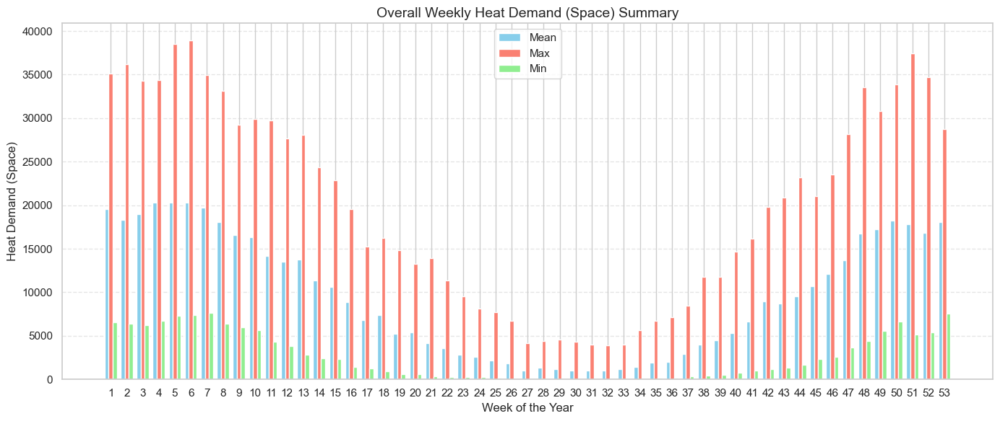

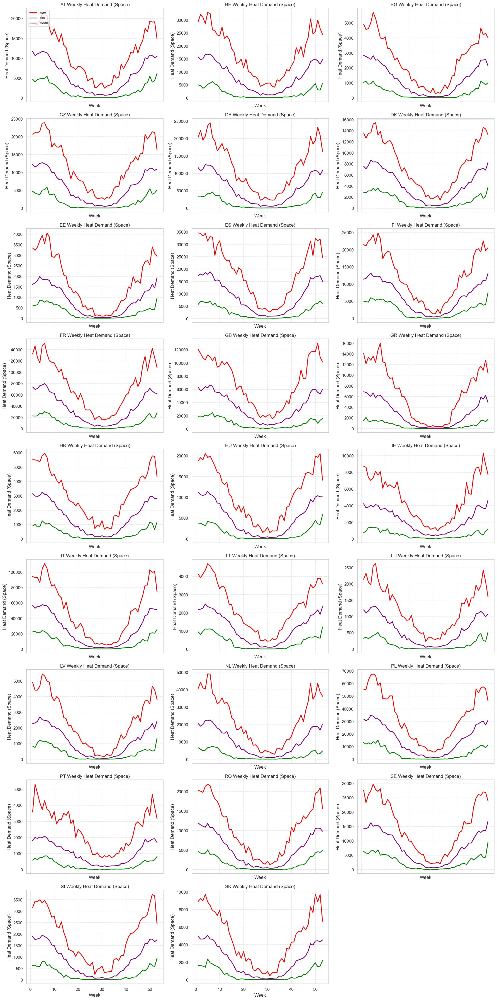

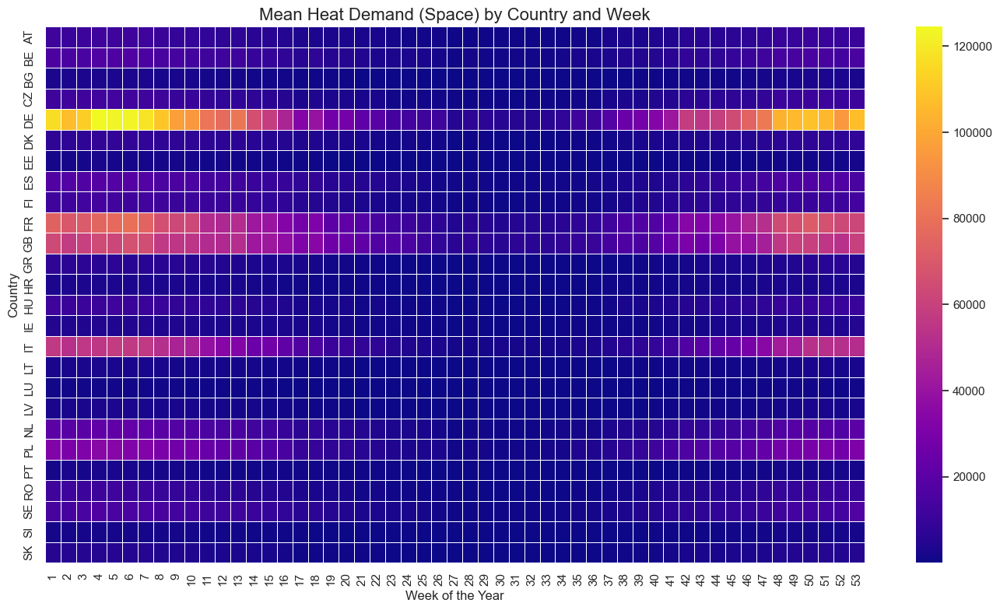

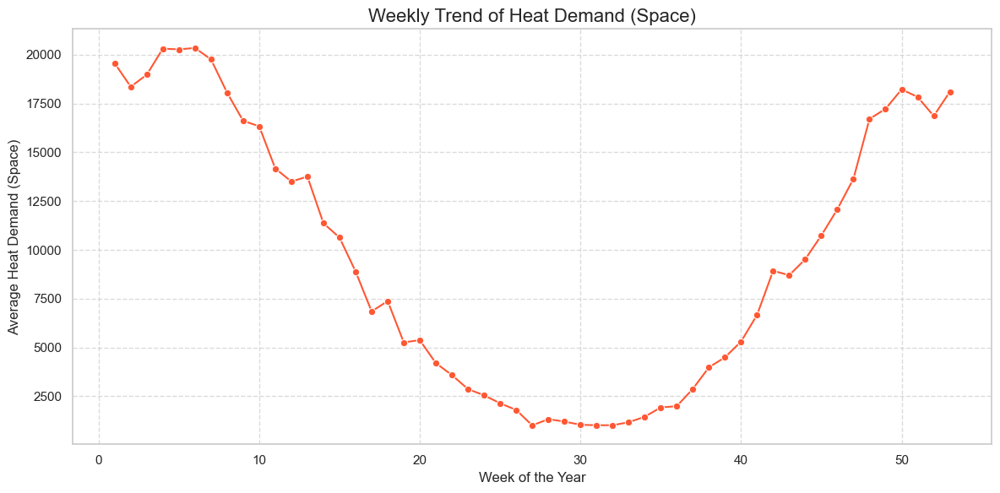

In [ ]:
# For First, compute overall weekly summary (mean, max, min) from your country_weekly_summary
overall_weekly_summary_space = country_weekly_summary.groupby('week')[['mean', 'max', 'min']].mean().reset_index()

# Setting positions and bar width
bar_width = 0.25
weeks = overall_weekly_summary_space['week'].values

r1 = np.arange(len(weeks))
r2 = [x + bar_width for x in r1]
r3 = [x + bar_width for x in r2]

# Ploting grouped bar plot
plt.figure(figsize=(14, 6))
plt.bar(r1, overall_weekly_summary_space['mean'], width=bar_width, label='Mean', color='skyblue')
plt.bar(r2, overall_weekly_summary_space['max'], width=bar_width, label='Max', color='salmon')
plt.bar(r3, overall_weekly_summary_space['min'], width=bar_width, label='Min', color='lightgreen')

# Customizing plot
plt.xlabel('Week of the Year', fontsize=12)
plt.ylabel('Heat Demand (Space)', fontsize=12)
plt.title('Overall Weekly Heat Demand (Space) Summary', fontsize=14)
plt.xticks([r + bar_width for r in range(len(weeks))], weeks)
plt.legend()
plt.grid(axis='y', linestyle='--', alpha=0.5)
plt.tight_layout()
plt.show()



# Using For List of countries
countries = country_weekly_summary['country'].unique()

# Setting-up subplot grid
n_cols = 3
n_rows = (len(countries) // n_cols) + (len(countries) % n_cols > 0)
fig, axes = plt.subplots(n_rows, n_cols, figsize=(18, n_rows * 4), sharex=True, sharey=False)

axes = axes.flatten()

# Plotting loop for weekly heat demand by country
for i, country in enumerate(countries):
    country_data = country_weekly_summary[country_weekly_summary['country'] == country]
    
    ax = axes[i]
    ax.plot(country_data['week'], country_data['max'], label='Max', color='red', linewidth=2)
    ax.plot(country_data['week'], country_data['min'], label='Min', color='green', linewidth=2)
    ax.plot(country_data['week'], country_data['mean'], label='Mean', color='purple', linewidth=2)
    
    ax.set_title(f"{country} Weekly Heat Demand (Space)", fontsize=12)
    ax.set_xlabel("Week")
    ax.set_ylabel("Heat Demand (Space)")
    ax.grid(True, linestyle='--', alpha=0.5)
    
    if i == 0:
        ax.legend(loc='upper left', fontsize=9)

# Hiding any empty subplots
for j in range(i+1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()




# Using Pivot data for the heatmap (average heat demand for each country by week)
pivot_mean_space = country_weekly_summary.pivot(index='country', columns='week', values='mean')

# Ploting heatmap
plt.figure(figsize=(14, 8))
sns.heatmap(pivot_mean_space, cmap='plasma', annot=False, linewidths=0.5)

plt.title('Mean Heat Demand (Space) by Country and Week', fontsize=16)
plt.xlabel('Week of the Year', fontsize=12)
plt.ylabel('Country', fontsize=12)
plt.tight_layout()
plt.show()




# Calculating overall weekly mean (averaging the 'mean' per week from the summary table)
weekly_trend_space = country_weekly_summary.groupby('week')['mean'].mean().reset_index()

# Ploting overall weekly trend
plt.figure(figsize=(12, 6))
sns.lineplot(x='week', y='mean', data=weekly_trend_space, marker='o', color='#FF5733')

plt.title('Weekly Trend of Heat Demand (Space)', fontsize=16)
plt.xlabel('Week of the Year', fontsize=12)
plt.ylabel('Average Heat Demand (Space)', fontsize=12)
plt.grid(True, linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()

In [ ]:
# Extracting month from timestamp
df['month'] = df['cet_cest_timestamp'].dt.month

# Grouping by 'country' and 'month', then calculate descriptive statistics for 'heat_demand_space'
country_monthly_summary = df.groupby(['country', 'month'])['heat_demand_space'].agg(
    mean='mean',
    min='min',
    max='max',
    q1=lambda x: x.quantile(0.25),
    q3=lambda x: x.quantile(0.75)
).reset_index().round(2)

# Converting DataFrame to an HTML table using tabulate
country_monthly_summary_table = tabulate(country_monthly_summary.head(50), headers='keys', tablefmt='html', showindex=False)

# Using Style and wrap the table in a scrollable div
styled_country_monthly_table = f"""
<div style="font-family: 'Arial', sans-serif; background-color: #f9f9f9; padding: 20px; border-radius: 10px; overflow-x: auto;">
    <h3 style="text-align: center; color: #4CAF50; font-size: 24px; font-weight: bold;">Overall Country-wise Monthly Heat Demand Space Summary</h3>
    <table style="width: 100%; border-collapse: collapse; margin: 25px 0; font-size: 14px; text-align: center; border: 1px solid #ddd; word-wrap: break-word;">
        <thead style="background-color: #4CAF50; color: white; font-weight: bold;">
            {country_monthly_summary_table.split('<thead>')[1].split('</thead>')[0]}
        </thead>
        <tbody style="background-color: #ffffff;">
            {country_monthly_summary_table.split('<tbody>')[1].split('</tbody>')[0]}
        </tbody>
    </table>
</div>
"""

# Displaying the styled table in Jupyter Notebook
display(HTML(styled_country_monthly_table))

country,month,mean,min,max,q1,q3
AT,1,11131.7,4065,19469,9281,13231
AT,2,10969.7,3721,21497,8925,12899
AT,3,8109.32,2201,17407,5988.25,10052.5
AT,4,4940.25,419,13287,3130.75,6477.25
AT,5,2756.45,190,7923,1443.75,3862.25
AT,6,1393.85,44,6516,574.75,1887.25
AT,7,787.71,33,3773,336,1057
AT,8,849.05,38,5762,380,1138
AT,9,2371.86,104,8490,1153,3264
AT,10,5152.41,476,13397,3289,6841.25


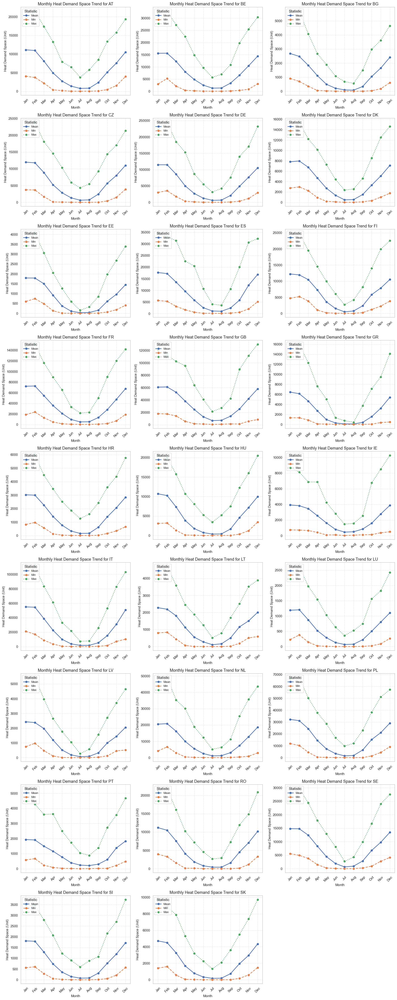

C:\Users\oppor\AppData\Local\Temp\ipykernel_8232\3188146014.py:64: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.barplot(x="month", y="heat_demand_space", hue="stat", data=monthly_melted_space, palette=palette, ci=None)


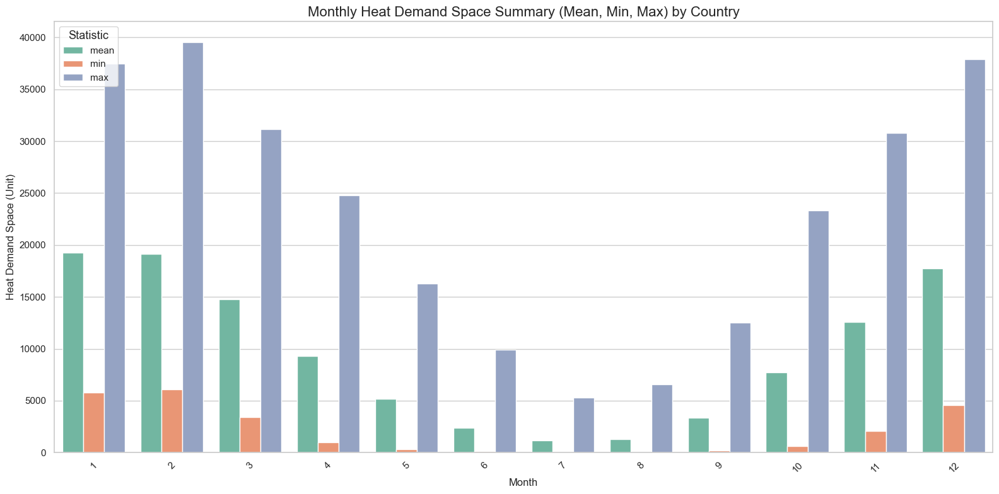

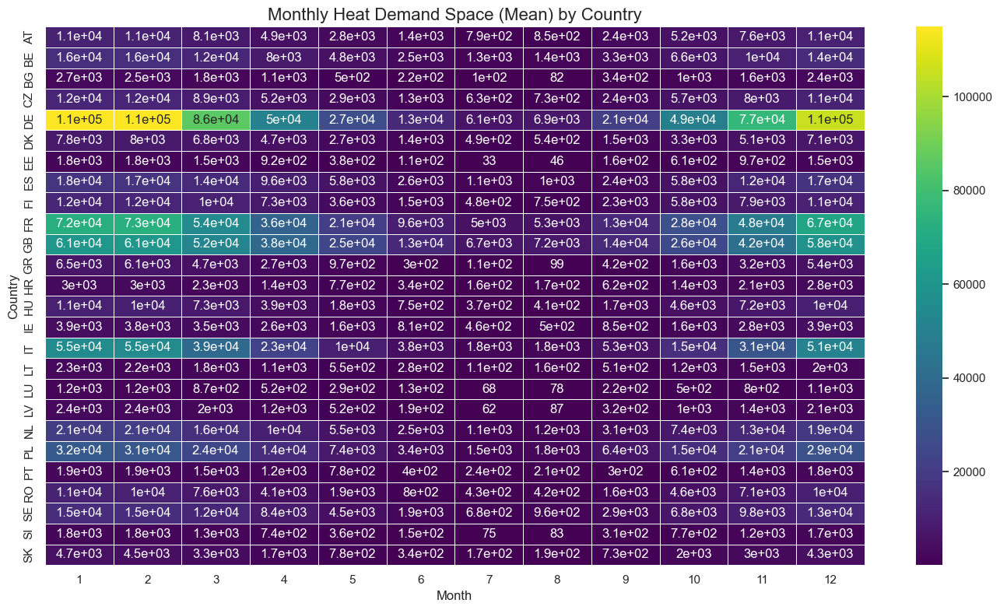

In [ ]:
# Setting seaborn style for consistency
sns.set(style="whitegrid")

# Using List of countries from the monthly summary
countries = country_monthly_summary['country'].unique()

# Determining the number of rows and columns for the subplot grid
n_cols = 3
n_rows = int(np.ceil(len(countries) / n_cols))

# Creating subplots with appropriate size
fig, axes = plt.subplots(n_rows, n_cols, figsize=(n_cols * 6, n_rows * 5))

# For Flatten axes array for easier iteration
axes = axes.flatten()

# Looping over each country and create a line plot in the corresponding subplot
for i, country in enumerate(countries):
    country_data = country_monthly_summary[country_monthly_summary['country'] == country]
    ax = axes[i]
    
    # Ploting mean, min, max
    ax.plot(country_data['month'], country_data['mean'], label='Mean', marker='o', linewidth=2)
    ax.plot(country_data['month'], country_data['min'], label='Min', linestyle='--', marker='o', linewidth=2)
    ax.plot(country_data['month'], country_data['max'], label='Max', linestyle=':', marker='o', linewidth=2)
    
    ax.set_title(f'Monthly Heat Demand Space Trend for {country}', fontsize=13)
    ax.set_xlabel('Month', fontsize=11)
    ax.set_ylabel('Heat Demand Space (Unit)', fontsize=11)
    
    ax.set_xticks(range(1, 13))
    ax.set_xticklabels(['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun',
                        'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec'], rotation=45)
    
    ax.legend(title="Statistic", fontsize=9, loc='upper left')
    ax.grid(True, linestyle='--', alpha=0.5)

# Hiding any empty subplots
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()




# Setting figure size
plt.figure(figsize=(16, 8))
sns.set(style="whitegrid")

# Melting the DataFrame to long format
monthly_melted_space = country_monthly_summary.melt(
    id_vars=['country', 'month'], 
    value_vars=['mean', 'min', 'max'],
    var_name='stat', 
    value_name='heat_demand_space'
)

# Setting color palette
palette = sns.color_palette("Set2", n_colors=3)

# Creating the barplot
sns.barplot(x="month", y="heat_demand_space", hue="stat", data=monthly_melted_space, palette=palette, ci=None)

# Rotating x-axis labels
plt.xticks(rotation=45)

# For Titles and labels
plt.title('Monthly Heat Demand Space Summary (Mean, Min, Max) by Country', fontsize=16)
plt.xlabel('Month', fontsize=12)
plt.ylabel('Heat Demand Space (Unit)', fontsize=12)

# Adjusting legend
plt.legend(title="Statistic", title_fontsize='13', loc='upper left', fontsize='11')

plt.tight_layout()
plt.show()




# Using Pivot the data for heatmap format
heatmap_space = country_monthly_summary.pivot(index='country', columns='month', values='mean')

# Setting up the heatmap
plt.figure(figsize=(14, 8))
sns.heatmap(heatmap_space, cmap='viridis', annot=True, linewidths=0.5)

# Using Title and labels
plt.title('Monthly Heat Demand Space (Mean) by Country', fontsize=16)
plt.xlabel('Month', fontsize=12)
plt.ylabel('Country', fontsize=12)

plt.tight_layout()
plt.show()



In [ ]:
# Extracting year from timestamp
df['year'] = df['cet_cest_timestamp'].dt.year

# Grouping by 'country' and 'year', calculate descriptive stats for heat_demand_space
country_yearly_summary = df.groupby(['country', 'year'])['heat_demand_space'].agg(
    mean='mean',
    min='min',
    max='max',
    q1=lambda x: x.quantile(0.25),
    q3=lambda x: x.quantile(0.75)
).reset_index().round(2)

# Converting DataFrame to HTML table using tabulate
from tabulate import tabulate
country_yearly_summary_table = tabulate(country_yearly_summary.head(35), headers='keys', tablefmt='html', showindex=False)

# Using For Styled HTML table
styled_country_yearly_table = f"""
<div style="font-family: 'Arial', sans-serif; background-color: #f9f9f9; padding: 20px; border-radius: 10px; overflow-x: auto;">
    <h3 style="text-align: center; color: #4CAF50; font-size: 24px; font-weight: bold;">Overall Country-wise Yearly Heat Demand Space Summary</h3>
    <table style="width: 100%; border-collapse: collapse; margin: 25px 0; font-size: 14px; text-align: center; border: 1px solid #ddd; word-wrap: break-word;">
        <thead style="background-color: #4CAF50; color: white; font-weight: bold;">
            {country_yearly_summary_table.split('<thead>')[1].split('</thead>')[0]}
        </thead>
        <tbody style="background-color: #ffffff;">
            {country_yearly_summary_table.split('<tbody>')[1].split('</tbody>')[0]}
        </tbody>
    </table>
</div>
"""

# Displaying the styled table (if in Jupyter)
from IPython.display import display, HTML
display(HTML(styled_country_yearly_table))


country,year,mean,min,max,q1,q3
AT,2007,9320,9320,9320,9320,9320
AT,2008,5630.86,99,18747,1402.5,8805
AT,2009,5317.99,96,19139,1226,9031
AT,2010,6034.98,44,19469,1783,9673
AT,2011,5330.43,53,17865,1319,9014
AT,2012,5544.53,44,21497,1321,8872.5
AT,2013,5841.26,33,18731,1663.5,9713.5
AT,2014,5069.47,85,18653,1660,8178.5
AT,2015,5399.48,34,16476,1391,8884.5
AT,2016,8406,8406,8406,8406,8406


C:\Users\oppor\AppData\Local\Temp\ipykernel_8232\2618222532.py:24: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.barplot(


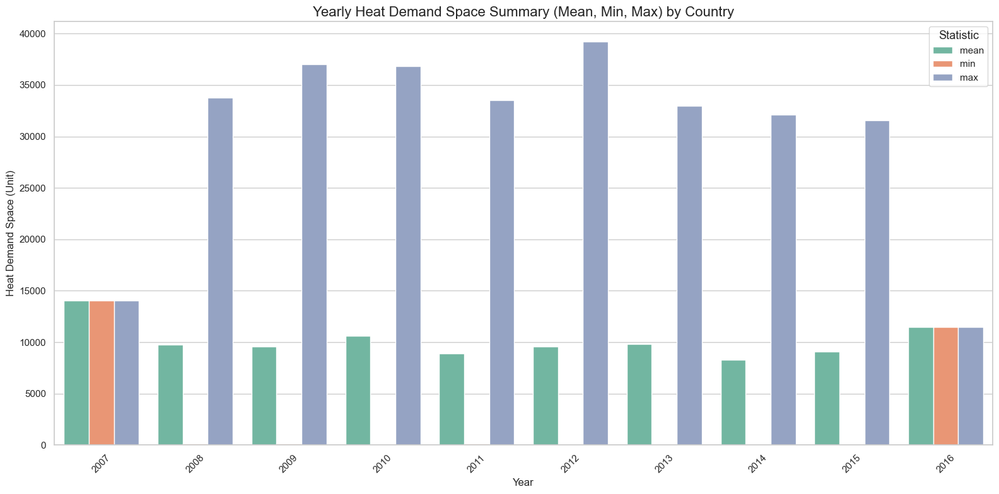

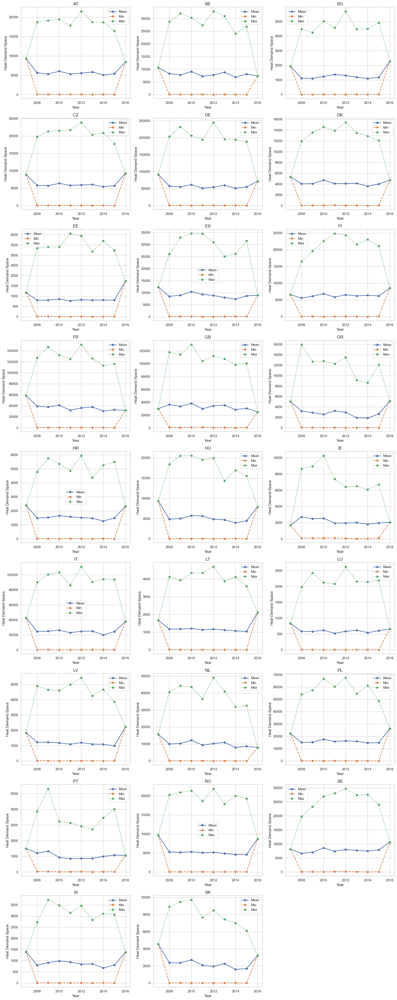

In [ ]:
# Grouping by 'country' and 'year', calculate descriptive stats for heat_demand_space
yearly_summary = df.groupby(['country', 'year'])['heat_demand_space'].agg(
    mean='mean',
    min='min',
    max='max'
).reset_index().round(2)


# Melting the summary for plotting
yearly_melted = yearly_summary.melt(
    id_vars=['country', 'year'],
    value_vars=['mean', 'min', 'max'],
    var_name='stat',
    value_name='heat_demand_space'
)


# Setting seaborn style
sns.set(style="whitegrid")

plt.figure(figsize=(16, 8))
palette = sns.color_palette("Set2", n_colors=3)

sns.barplot(
    x="year",
    y="heat_demand_space",
    hue="stat",
    data=yearly_melted,
    palette=palette,
    ci=None
)

plt.title('Yearly Heat Demand Space Summary (Mean, Min, Max) by Country', fontsize=16)
plt.xlabel('Year', fontsize=12)
plt.ylabel('Heat Demand Space (Unit)', fontsize=12)
plt.legend(title="Statistic", title_fontsize='13', loc='upper right', fontsize='11')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()




# For Number of countries
countries = yearly_summary['country'].unique()
n_countries = len(countries)
cols = 3
rows = int(np.ceil(n_countries / cols))

fig, axes = plt.subplots(rows, cols, figsize=(18, 5 * rows))

for i, country in enumerate(countries):
    ax = axes.flat[i]
    country_data = yearly_summary[yearly_summary['country'] == country]
    
    ax.plot(country_data['year'], country_data['mean'], label='Mean', marker='o', linewidth=2)
    ax.plot(country_data['year'], country_data['min'], label='Min', marker='o', linestyle='--', linewidth=2)
    ax.plot(country_data['year'], country_data['max'], label='Max', marker='o', linestyle=':', linewidth=2)
    
    ax.set_title(f"{country}", fontsize=14)
    ax.set_xlabel("Year")
    ax.set_ylabel("Heat Demand Space")
    ax.legend()

# Removing empty subplots if any
for j in range(i + 1, len(axes.flat)):
    fig.delaxes(axes.flat[j])

plt.tight_layout()
plt.show()



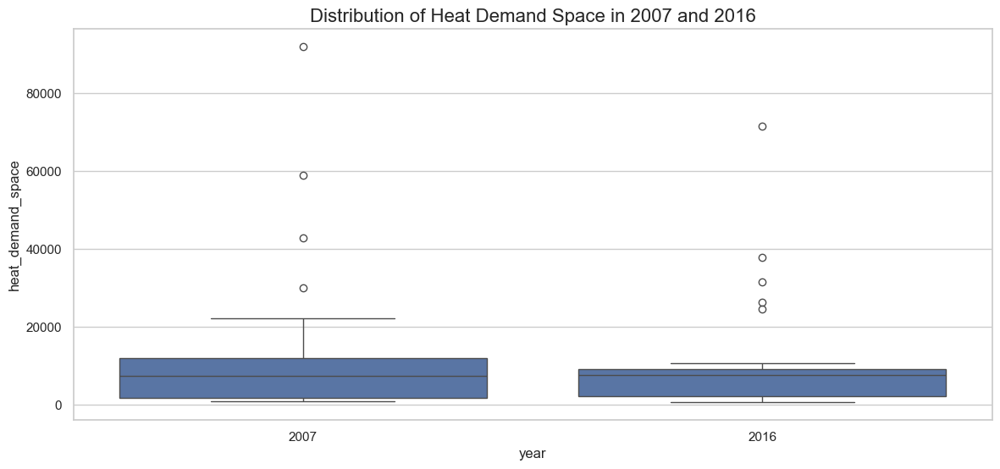

Missing data in 2007 and 2016:
Empty DataFrame
Columns: [year, heat_demand_space]
Index: []


In [ ]:
# Using Filter data for 2007 and 2016
years_of_interest = [2007, 2016]
df_years = df[df['year'].isin(years_of_interest)]

# Visualizing the distribution of values for 2007 and 2016
plt.figure(figsize=(14, 6))
sns.boxplot(data=df_years, x='year', y='heat_demand_space')
plt.title("Distribution of Heat Demand Space in 2007 and 2016", fontsize=16)
plt.show()

# Checking for missing or zero values in 2007 and 2016
missing_data = df_years[df_years['heat_demand_space'].isnull()]
print(f"Missing data in 2007 and 2016:\n{missing_data[['year', 'heat_demand_space']]}")


In [ ]:
# Calculating Q1 (25th percentile) and Q3 (75th percentile)
Q1 = df['heat_demand_space'].quantile(0.25)
Q3 = df['heat_demand_space'].quantile(0.75)
IQR = Q3 - Q1

# Defining outlier bounds (1.5 * IQR rule)
lower_bound = Q1 - 1.5 * IQR
upper_bound = Q3 + 1.5 * IQR

# Filtering out the outliers
outliers = df[(df['heat_demand_space'] < lower_bound) | (df['heat_demand_space'] > upper_bound)]

print(f"Outliers detected:\n{outliers[['year', 'heat_demand_space']]}")


Outliers detected:
         year  heat_demand_space
131514   2008            23496.0
131515   2008            23087.0
131516   2008            23231.0
131517   2008            22312.0
131538   2008            24436.0
...       ...                ...
3349285  2015            23381.0
3349286  2015            22398.0
3356266  2015            23481.0
3356267  2015            22367.0
3356268  2015            22580.0

[194163 rows x 2 columns]


In [ ]:
from scipy.stats import zscore

# Calculating the Z-scores
df['zscore'] = zscore(df['heat_demand_space'])

# Filtering out rows where the absolute Z-score is greater than 3 (outliers)
outliers_zscore = df[df['zscore'].abs() > 3]

print(f"Outliers detected (Z-score method):\n{outliers_zscore[['year', 'heat_demand_space']]}")


Outliers detected (Z-score method):
         year  heat_demand_space
657415   2007            91867.0
657416   2008            91867.0
657417   2008            94072.0
657418   2008            96511.0
657419   2008           102811.0
...       ...                ...
2173844  2015            67237.0
2910775  2010            66694.0
2928485  2012            67485.0
2928509  2012            66565.0
2928557  2012            66305.0

[51516 rows x 2 columns]


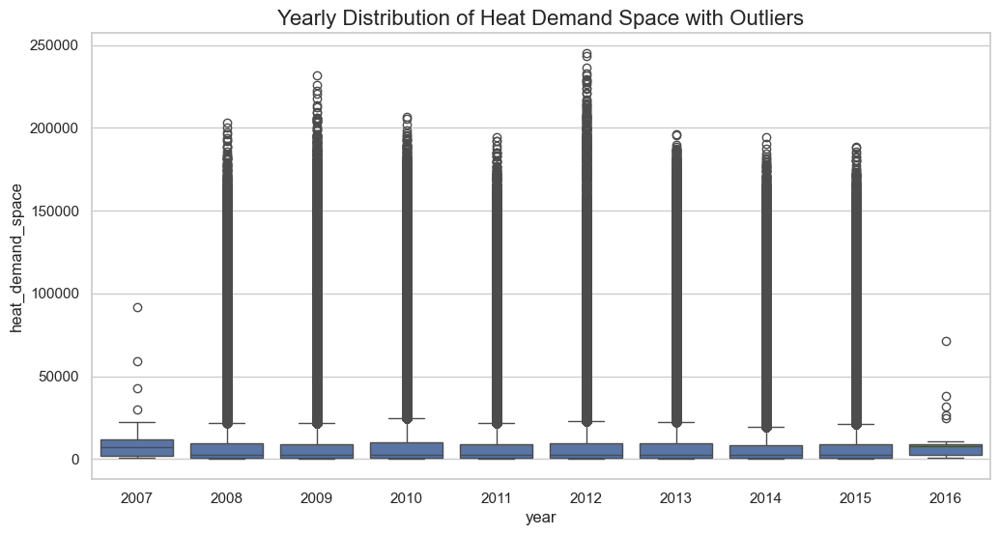

In [ ]:
# Using Boxplot to visualize outliers
plt.figure(figsize=(12, 6))
sns.boxplot(x='year', y='heat_demand_space', data=df)
plt.title("Yearly Distribution of Heat Demand Space with Outliers", fontsize=16)
plt.show()


In [119]:
df['heat_demand_space'] = df['heat_demand_space'].clip(lower=lower_bound, upper=upper_bound)


In [121]:
df['log_heat_demand_space'] = np.log1p(df['heat_demand_space'])


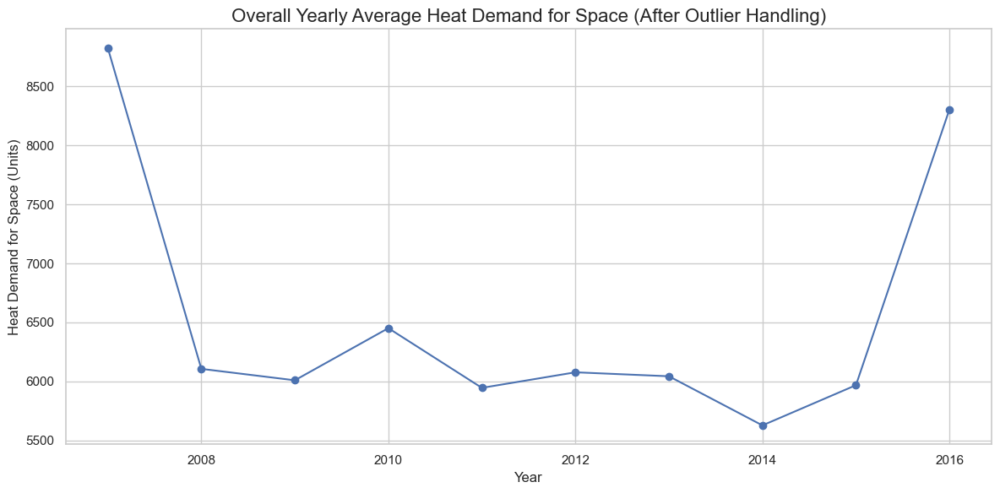

In [ ]:
# For Recompute the yearly summary after cleaning or transforming the data
yearly_summary_cleaned = df.groupby('year')['heat_demand_space'].agg(['mean', 'min', 'max']).reset_index().round(2)

# Ploting the cleaned data (or transformed)
plt.figure(figsize=(12, 6))
plt.plot(yearly_summary_cleaned['year'], yearly_summary_cleaned['mean'], marker='o', linestyle='-', color='b')

# Adding labels and title
plt.title('Overall Yearly Average Heat Demand for Space (After Outlier Handling)', fontsize=16)
plt.xlabel('Year', fontsize=12)
plt.ylabel('Heat Demand for Space (Units)', fontsize=12)

# Showing the plot
plt.tight_layout()
plt.show()


year,mean,min,max
2007,14073.8,835,91867
2008,9750.54,5,203234
2009,9548.34,3,231979
2010,10633,1,206505
2011,8922.12,1,194092
2012,9547.83,1,244977
2013,9835.08,2,195917
2014,8304.07,1,194214
2015,9059.79,1,188764
2016,11472.5,656,71408


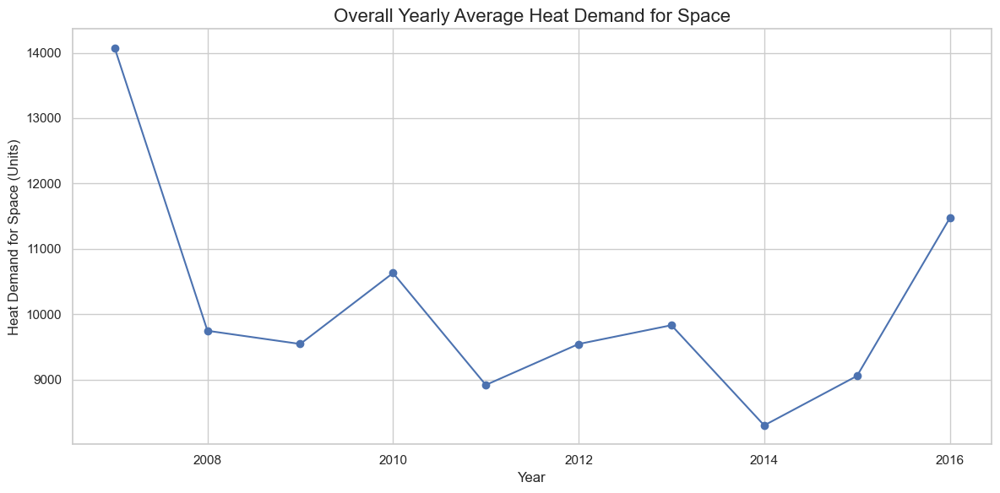

In [ ]:
# Ensuring timestamp is converted to datetime with timezone awareness
df['cet_cest_timestamp'] = pd.to_datetime(df['cet_cest_timestamp'], utc=True)
df['cet_cest_timestamp'] = df['cet_cest_timestamp'].dt.tz_convert('Europe/Paris')

# Creating a 'year' column based on the timestamp
df['year'] = df['cet_cest_timestamp'].dt.year


# For Overall yearly summary: mean, min, max for the entire dataset (no country grouping)
yearly_summary_space = df.groupby('year')['heat_demand_space'].agg(['mean', 'min', 'max']).reset_index().round(2)


from tabulate import tabulate
from IPython.display import display, HTML

# Converting the aggregated yearly data to HTML table format using tabulate
yearly_summary_table_space = tabulate(yearly_summary_space, headers='keys', tablefmt='html', showindex=False)

# Using Style and wrap the table in a scrollable div
styled_yearly_table_space = f"""
<div style="font-family: 'Arial', sans-serif; background-color: #f9f9f9; padding: 20px; border-radius: 10px; overflow-x: auto;">
    <h3 style="text-align: center; color: #4CAF50; font-size: 24px; font-weight: bold;">Overall Yearly Heat Demand Space Summary</h3>
    <table style="width: 100%; border-collapse: collapse; margin: 25px 0; font-size: 14px; text-align: center; border: 1px solid #ddd; word-wrap: break-word;">
        <thead style="background-color: #4CAF50; color: white; font-weight: bold;">
            {yearly_summary_table_space.split('<thead>')[1].split('</thead>')[0]}
        </thead>
        <tbody style="background-color: #ffffff;">
            {yearly_summary_table_space.split('<tbody>')[1].split('</tbody>')[0]}
        </tbody>
    </table>
</div>
"""

# Displaying the styled table in Jupyter Notebook
display(HTML(styled_yearly_table_space))


# Setting up seaborn style
sns.set(style="whitegrid")

# Creating the plot for the overall yearly trend
plt.figure(figsize=(12, 6))
plt.plot(yearly_summary_space['year'], yearly_summary_space['mean'], marker='o', linestyle='-', color='b')

# Adding labels and title
plt.title('Overall Yearly Average Heat Demand for Space', fontsize=16)
plt.xlabel('Year', fontsize=12)
plt.ylabel('Heat Demand for Space (Units)', fontsize=12)

# Showing the plot
plt.tight_layout()
plt.show()


In [ ]:
# Grouping by 'year' and 'country' to calculate the required statistics
yearly_country_summary = df.groupby(['year', 'country'])['heat_demand_space'].agg(
    mean='mean',
    max='max',
    min='min',
    q1=lambda x: x.quantile(0.25),
    q3=lambda x: x.quantile(0.75)
).reset_index()

# For Round the values for better readability
yearly_country_summary = yearly_country_summary.round(2)

# Converting the aggregated yearly data to HTML table format using tabulate
yearly_country_summary_table = tabulate(yearly_country_summary.head(30), headers='keys', tablefmt='html', showindex=False)

# For Style and wrap the table in a scrollable div
styled_yearly_country_summary = f"""
<div style="font-family: 'Arial', sans-serif; background-color: #f9f9f9; padding: 20px; border-radius: 10px; overflow-x: auto;">
    <h3 style="text-align: center; color: #4CAF50; font-size: 24px; font-weight: bold;">Overall Yearly Heat Demand Space Summary (Grouped by Country)</h3>
    <table style="width: 100%; border-collapse: collapse; margin: 25px 0; font-size: 14px; text-align: center; border: 1px solid #ddd; word-wrap: break-word;">
        <thead style="background-color: #4CAF50; color: white; font-weight: bold;">
            {yearly_country_summary_table.split('<thead>')[1].split('</thead>')[0]}
        </thead>
        <tbody style="background-color: #ffffff;">
            {yearly_country_summary_table.split('<tbody>')[1].split('</tbody>')[0]}
        </tbody>
    </table>
</div>
"""

# Displaying the styled table in Jupyter Notebook
display(HTML(styled_yearly_country_summary))

year,country,mean,max,min,q1,q3
2007,AT,9320,9320,9320,9320,9320
2007,BE,10609,10609,10609,10609,10609
2007,BG,1932,1932,1932,1932,1932
2007,CZ,8920,8920,8920,8920,8920
2007,DE,21886,21886,21886,21886,21886
2007,DK,5318,5318,5318,5318,5318
2007,EE,1169,1169,1169,1169,1169
2007,ES,12412,12412,12412,12412,12412
2007,FI,6564,6564,6564,6564,6564
2007,FR,21886,21886,21886,21886,21886


In [ ]:
# Defining aggregation functions for heat_demand_total
agg_funcs_total = {
    'heat_demand_total': [
        'mean',
        lambda x: x.quantile(0.25),  # Q1 (lower quartile)
        lambda x: x.quantile(0.75),  # Q3 (upper quartile)
        'min', 
        'max'
    ]
}

# Grouping by country and compute the stats for heat_demand_total
country_summary_total = df.groupby('country').agg(agg_funcs_total).round(2)

# Using Rename columns for clarity
def rename_stat(col):
    stat_map = {
        '<lambda_0>': 'q1',
        '<lambda_1>': 'q3'
    }
    stat_name = stat_map.get(col[1], col[1])
    return f"{col[0]}_{stat_name}"

country_summary_total.columns = [rename_stat(col) for col in country_summary_total.columns]

# Resetting index for clean display
country_summary_total.reset_index(inplace=True)

# Using Rename columns for simplicity
country_summary_total.columns = [
    'country', 
    'mean', 
    'q1', 
    'q3', 
    'min', 
    'max'
]

# Converting to HTML table using tabulate
table_country_summary_total = tabulate(country_summary_total, headers='keys', tablefmt='html', showindex=False)

# Styling and wrap it in a scrollable div
styled_country_table_total = f"""
<div style="font-family: 'Arial', sans-serif; background-color: #f9f9f9; padding: 20px; border-radius: 10px; overflow-x: auto;">
    <h3 style="text-align: center; color: #4CAF50; font-size: 24px; font-weight: bold;">Country-wise Heat Demand Total Summary</h3>
    <table style="width: 100%; border-collapse: collapse; margin: 25px 0; font-size: 14px; text-align: center; border: 1px solid #ddd; word-wrap: break-word;">
        <thead style="background-color: #4CAF50; color: white; font-weight: bold;">
            {table_country_summary_total.split('<thead>')[1].split('</thead>')[0]}
        </thead>
        <tbody style="background-color: #ffffff;">
            {table_country_summary_total.split('<tbody>')[1].split('</tbody>')[0]}
        </tbody>
    </table>
</div>
"""

# Displaying the styled table
display(HTML(styled_country_table_total))

country,mean,q1,q3,min,max
AT,6549.73,2489,10076.8,378,23482
BE,9297.25,3556.25,13794,460,35273
BG,1674.79,688,2498,142,6619
CZ,6793.17,2254,10619,311,25730
DE,65656.2,22080.2,101063,3448,264244
DK,4874.8,1970.25,7270,269,16890
EE,950.19,254,1502,41,4328
ES,12444,5763.25,18288,1295,41595
FI,7159.34,2499,10913,297,26622
FR,42789.3,16173,64268.8,2685,165059


C:\Users\oppor\AppData\Local\Temp\ipykernel_8232\2623223055.py:3: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='country', y='mean', data=country_summary_total, palette='viridis')


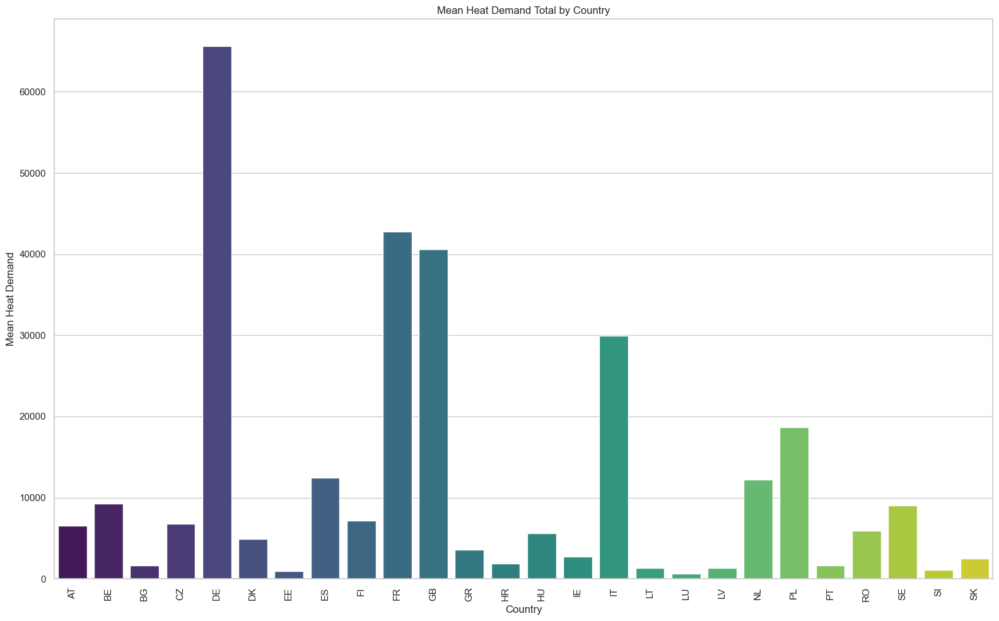

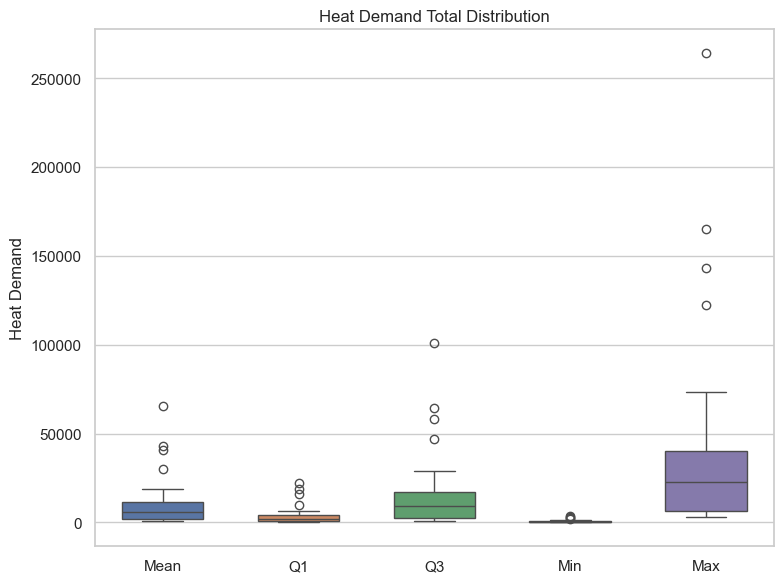

C:\Users\oppor\AppData\Local\Temp\ipykernel_8232\2623223055.py:23: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='country', y='range', data=country_summary_total, palette='coolwarm')


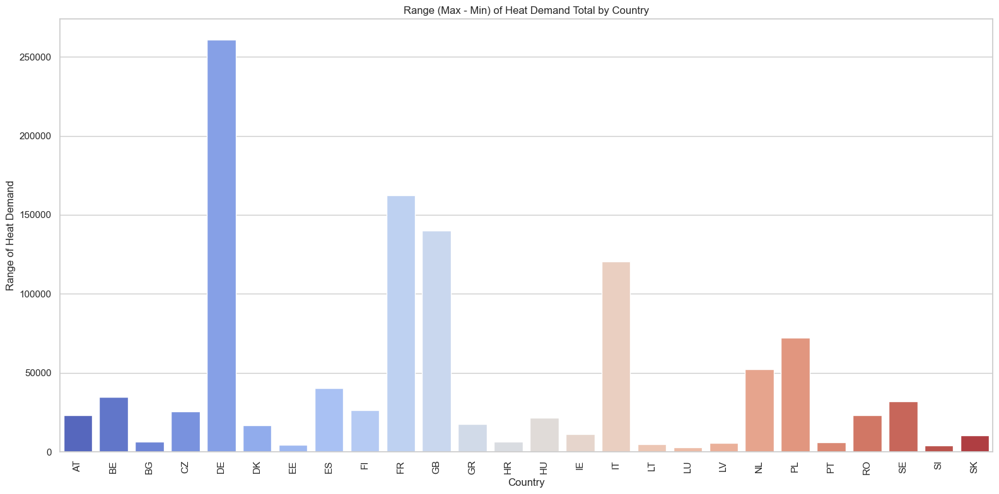

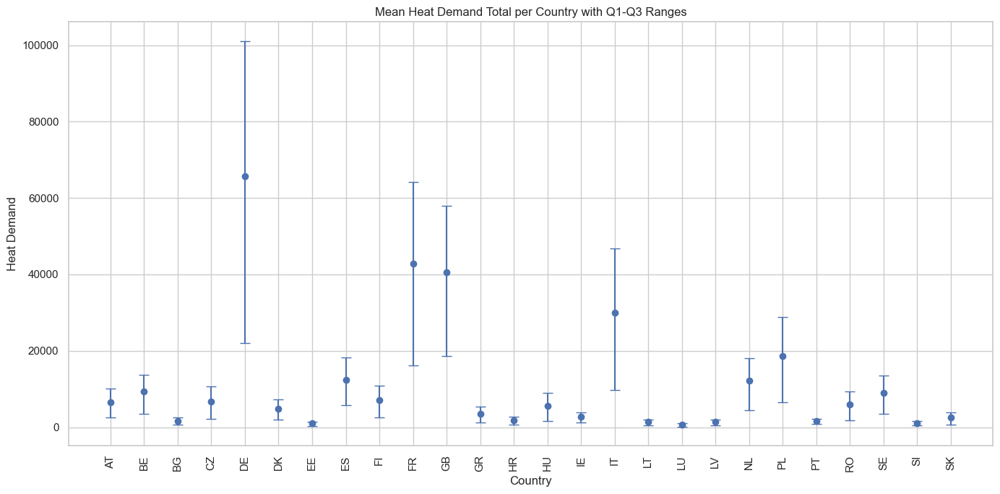

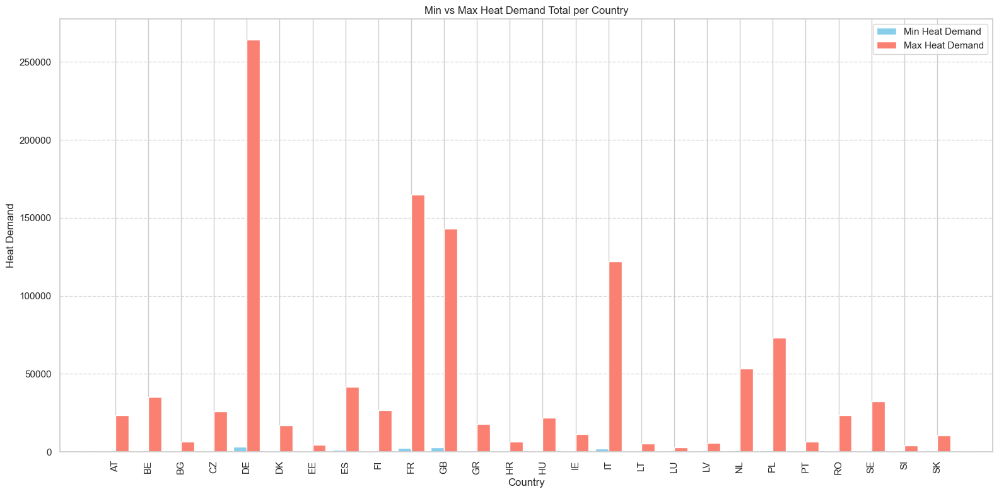

In [ ]:
# 1. Using Bar Plot for mean heat demand (total) across countries
plt.figure(figsize=(16, 10))
sns.barplot(x='country', y='mean', data=country_summary_total, palette='viridis')
plt.title("Mean Heat Demand Total by Country")
plt.xticks(rotation=90)
plt.ylabel("Mean Heat Demand")
plt.xlabel("Country")
plt.tight_layout()
plt.show()

# 2. Using Boxplot for distribution (Q1, Q3, Min, Max)
plt.figure(figsize=(8, 6))
sns.boxplot(data=country_summary_total[['mean', 'q1', 'q3', 'min', 'max']], width=0.6)
plt.title("Heat Demand Total Distribution")
plt.xticks(ticks=range(5), labels=['Mean', 'Q1', 'Q3', 'Min', 'Max'])
plt.ylabel("Heat Demand")
plt.tight_layout()
plt.show()

# 3. Using Bar Plot for the range (Max - Min) of heat demand total for each country
country_summary_total['range'] = country_summary_total['max'] - country_summary_total['min']
plt.figure(figsize=(16, 8))
sns.barplot(x='country', y='range', data=country_summary_total, palette='coolwarm')
plt.title("Range (Max - Min) of Heat Demand Total by Country")
plt.xticks(rotation=90)
plt.ylabel("Range of Heat Demand")
plt.xlabel("Country")
plt.tight_layout()
plt.show()

# 4. For Error bar plot (Mean with Q1-Q3 Ranges)
plt.figure(figsize=(14, 7))
plt.errorbar(
    country_summary_total['country'],
    country_summary_total['mean'],
    yerr=[
        country_summary_total['mean'] - country_summary_total['q1'],
        country_summary_total['q3'] - country_summary_total['mean']
    ],
    fmt='o', capsize=5
)
plt.xticks(rotation=90)
plt.title('Mean Heat Demand Total per Country with Q1-Q3 Ranges')
plt.ylabel('Heat Demand')
plt.xlabel('Country')
plt.grid(True)
plt.tight_layout()
plt.show()

# 5. For Side-by-side bar plot: Min vs Max Heat Demand (Total)
plt.figure(figsize=(16, 8))

# Setting bar width
bar_width = 0.4

# Using for Position of bars on x-axis
r1 = np.arange(len(country_summary_total))
r2 = [x + bar_width for x in r1]

# Ploting bars
plt.bar(r1, country_summary_total['min'], color='skyblue', width=bar_width, label='Min Heat Demand')
plt.bar(r2, country_summary_total['max'], color='salmon', width=bar_width, label='Max Heat Demand')

# Adding labels and title
plt.xlabel('Country')
plt.ylabel('Heat Demand')
plt.title('Min vs Max Heat Demand Total per Country')
plt.xticks([r + bar_width / 2 for r in range(len(country_summary_total))], country_summary_total['country'], rotation=90)
plt.legend()

# Adding grid
plt.grid(axis='y', linestyle='--', alpha=0.7)

# For Tight layout
plt.tight_layout()

# Showing plot
plt.show()


In [ ]:
# Grouping by 'country' and 'hour', then calculating descriptive statistics for 'heat_demand_total'
country_hourly_summary_total = df.groupby(['country', 'hour'])['heat_demand_total'].agg(
    mean='mean',
    min='min',
    max='max',
    q1=lambda x: x.quantile(0.25),
    q3=lambda x: x.quantile(0.75)
).reset_index().round(2)

# Converting the DataFrame to an HTML table using tabulate
country_hourly_summary_total_table = tabulate(country_hourly_summary_total.head(35), headers='keys', tablefmt='html', showindex=False)

# For Style and wrap the table in a scrollable div (with new title for heat_demand_total)
styled_country_hourly_table_total = f"""
<div style="font-family: 'Arial', sans-serif; background-color: #f9f9f9; padding: 20px; border-radius: 10px; overflow-x: auto;">
    <h3 style="text-align: center; color: #4CAF50; font-size: 24px; font-weight: bold;">Overall Country-wise Hourly Heat Demand Total Summary</h3>
    <table style="width: 100%; border-collapse: collapse; margin: 25px 0; font-size: 14px; text-align: center; border: 1px solid #ddd; word-wrap: break-word;">
        <thead style="background-color: #4CAF50; color: white; font-weight: bold;">
            {country_hourly_summary_total_table.split('<thead>')[1].split('</thead>')[0]}
        </thead>
        <tbody style="background-color: #ffffff;">
            {country_hourly_summary_total_table.split('<tbody>')[1].split('</tbody>')[0]}
        </tbody>
    </table>
</div>
"""

# Displaying the styled table in Jupyter Notebook
display(HTML(styled_country_hourly_table_total))

country,hour,mean,min,max,q1,q3
AT,0,3892.73,378,12985,1151.5,6325
AT,1,4036.9,430,13015,1220,6556
AT,2,4118.54,402,13213,1249.75,6709.75
AT,3,4489.28,469,13855,1460.25,7236
AT,4,5378.18,745,14580,2047.75,8412.5
AT,5,7479.3,1388,18271,3265.75,11381.8
AT,6,8975.26,1731,23482,4011.25,13419
AT,7,8656.62,1711,22017,3897.25,12961.5
AT,8,8248.49,1318,21449,3457.25,12619.2
AT,9,7830.24,1256,20421,3244.5,12109.5


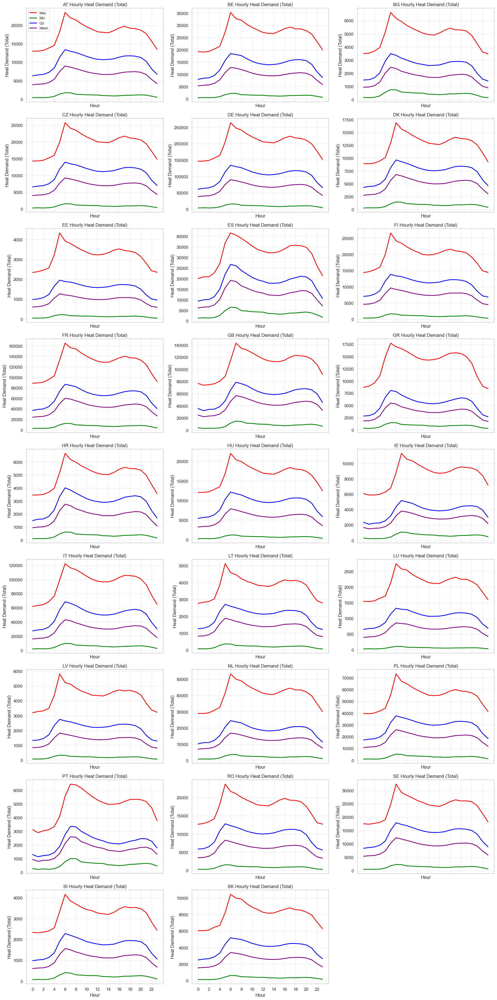

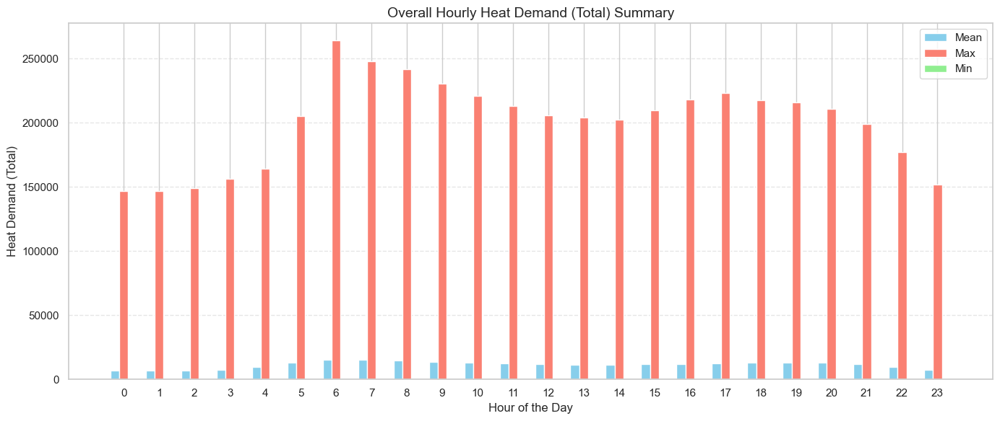

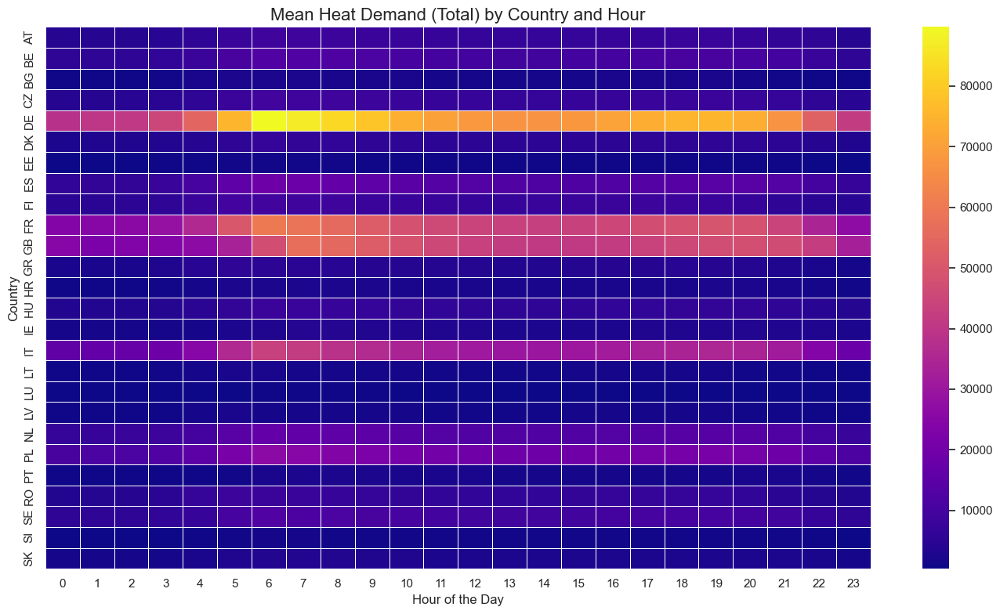

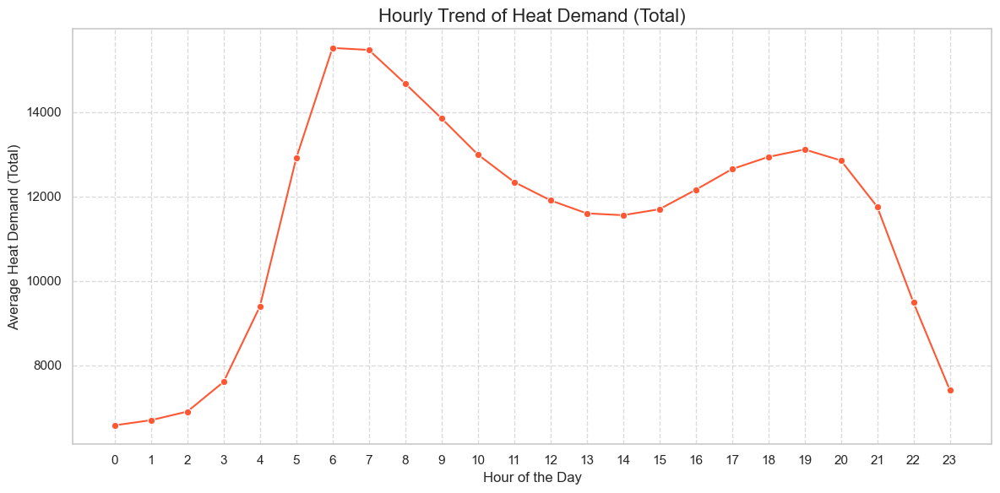

In [ ]:
# For List of countries
countries = country_hourly_summary_total['country'].unique()

# Setting-up subplot grid
n_cols = 3
n_rows = (len(countries) // n_cols) + (len(countries) % n_cols > 0)
fig, axes = plt.subplots(n_rows, n_cols, figsize=(18, n_rows * 4), sharex=True, sharey=False)

axes = axes.flatten()

# Plotting loop for Heat Demand (Total)
for i, country in enumerate(countries):
    country_data = country_hourly_summary_total[country_hourly_summary_total['country'] == country]
    
    ax = axes[i]
    ax.plot(country_data['hour'], country_data['max'], label='Max', color='red', linewidth=2)
    ax.plot(country_data['hour'], country_data['min'], label='Min', color='green', linewidth=2)
    ax.plot(country_data['hour'], country_data['q3'], label='Q3', color='blue', linewidth=2)
    ax.plot(country_data['hour'], country_data['mean'], label='Mean', color='purple', linewidth=2)
    
    ax.set_title(f"{country} Hourly Heat Demand (Total)", fontsize=12)
    ax.set_xlabel("Hour")
    ax.set_ylabel("Heat Demand (Total)")
    ax.grid(True, linestyle='--', alpha=0.5)
    ax.set_xticks(range(0, 24, 2))
    
    if i == 0:
        ax.legend(loc='upper left', fontsize=9)

# Hiding empty subplots
for j in range(i+1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()



# Grouping overall by hour and compute mean, max, min for heat demand (total)
overall_hourly_summary_total = df.groupby('hour')['heat_demand_total'].agg(['mean', 'max', 'min']).reset_index()

# Setting positions and bar width
bar_width = 0.25
hours = overall_hourly_summary_total['hour'].values

r1 = np.arange(len(hours))
r2 = [x + bar_width for x in r1]
r3 = [x + bar_width for x in r2]

# Ploting grouped bar plot for heat demand (total)
plt.figure(figsize=(14, 6))
plt.bar(r1, overall_hourly_summary_total['mean'], width=bar_width, label='Mean', color='skyblue')
plt.bar(r2, overall_hourly_summary_total['max'], width=bar_width, label='Max', color='salmon')
plt.bar(r3, overall_hourly_summary_total['min'], width=bar_width, label='Min', color='lightgreen')

# Customizing plot
plt.xlabel('Hour of the Day', fontsize=12)
plt.ylabel('Heat Demand (Total)', fontsize=12)
plt.title('Overall Hourly Heat Demand (Total) Summary', fontsize=14)
plt.xticks([r + bar_width for r in range(len(hours))], hours)
plt.legend()
plt.grid(axis='y', linestyle='--', alpha=0.5)
plt.tight_layout()
plt.show()



# Grouping by country and hour, compute mean for heat demand (total)
pivot_mean_total = df.groupby(['country', 'hour'])['heat_demand_total'].mean().reset_index()

# Using Pivot data for heatmap structure
heatmap_data_total = pivot_mean_total.pivot(index='country', columns='hour', values='heat_demand_total')

# Ploting heatmap
plt.figure(figsize=(14, 8))
sns.heatmap(heatmap_data_total, cmap='plasma', annot=False, linewidths=0.5)

plt.title('Mean Heat Demand (Total) by Country and Hour', fontsize=16)
plt.xlabel('Hour of the Day', fontsize=12)
plt.ylabel('Country', fontsize=12)
plt.tight_layout()
plt.show()



# Calculating overall hourly mean for heat demand (total)
hourly_trend_total = df.groupby(df['cet_cest_timestamp'].dt.hour)['heat_demand_total'].mean().reset_index()

# Ploting the hourly trend of heat demand (total)
plt.figure(figsize=(12,6))
sns.lineplot(x='cet_cest_timestamp', y='heat_demand_total', data=hourly_trend_total, marker='o', color='#FF5733')

plt.title('Hourly Trend of Heat Demand (Total)', fontsize=16)
plt.xlabel('Hour of the Day', fontsize=12)
plt.ylabel('Average Heat Demand (Total)', fontsize=12)
plt.xticks(range(0, 24))
plt.grid(True, linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()




In [ ]:
# Assuming `df` contains the required data
# Extracting week of the year from timestamp
df['week'] = df['cet_cest_timestamp'].dt.isocalendar().week

# Grouping by 'country' and 'week', then calculate descriptive statistics for 'heat_demand_total'
country_weekly_summary_total = df.groupby(['country', 'week'])['heat_demand_total'].agg(
    mean='mean',
    min='min',
    max='max',
    q1=lambda x: x.quantile(0.25),
    q3=lambda x: x.quantile(0.75)
).reset_index().round(2)

# Converting the DataFrame to an HTML table using tabulate
from tabulate import tabulate
country_weekly_summary_total_table = tabulate(country_weekly_summary_total.head(35), headers='keys', tablefmt='html', showindex=False)

# Using For Style and wrap the table in a scrollable div (with new title for country-based data)
styled_country_weekly_table_total = f"""
<div style="font-family: 'Arial', sans-serif; background-color: #f9f9f9; padding: 20px; border-radius: 10px; overflow-x: auto;">
    <h3 style="text-align: center; color: #4CAF50; font-size: 24px; font-weight: bold;">Overall Country-wise Weekly Heat Demand Total Summary</h3>
    <table style="width: 100%; border-collapse: collapse; margin: 25px 0; font-size: 14px; text-align: center; border: 1px solid #ddd; word-wrap: break-word;">
        <thead style="background-color: #4CAF50; color: white; font-weight: bold;">
            {country_weekly_summary_total_table.split('<thead>')[1].split('</thead>')[0]}
        </thead>
        <tbody style="background-color: #ffffff;">
            {country_weekly_summary_total_table.split('<tbody>')[1].split('</tbody>')[0]}
        </tbody>
    </table>
</div>
"""

# Displaying the styled table in Jupyter Notebook
from IPython.display import HTML, display
display(HTML(styled_country_weekly_table_total))

country,week,mean,min,max,q1,q3
AT,1,12699.6,5122,20702,10594,15123
AT,2,11688.4,4502,20439,9381.75,13899.8
AT,3,12112.2,4960,20440,10032.8,14387.8
AT,4,12373.8,5143,21407,10185.2,14577.8
AT,5,12709.9,5230,23040,10315,14902.2
AT,6,12600.5,5344,23482,10259,14917.8
AT,7,12372.4,5886,22639,10231,14352
AT,8,11511.5,4185,19532,9296.25,13870.2
AT,9,10304.2,4035,17560,8142.75,12404.2
AT,10,10251.7,3691,19344,8141.5,12157.2


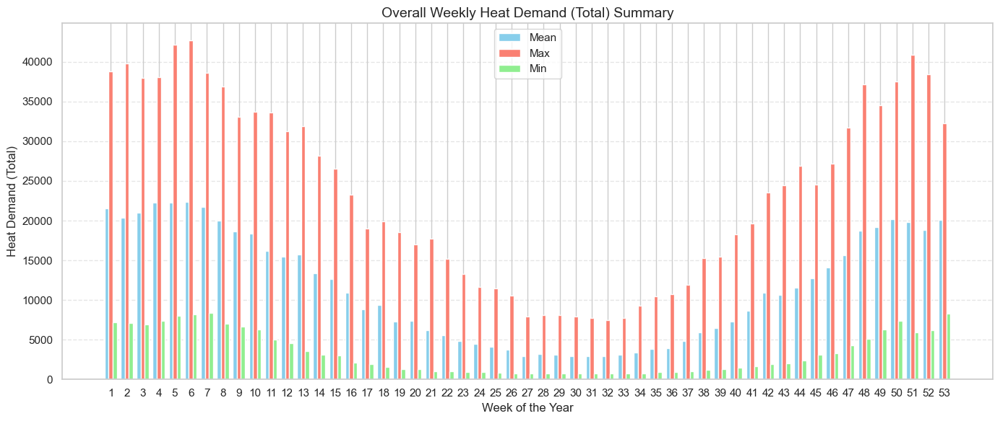

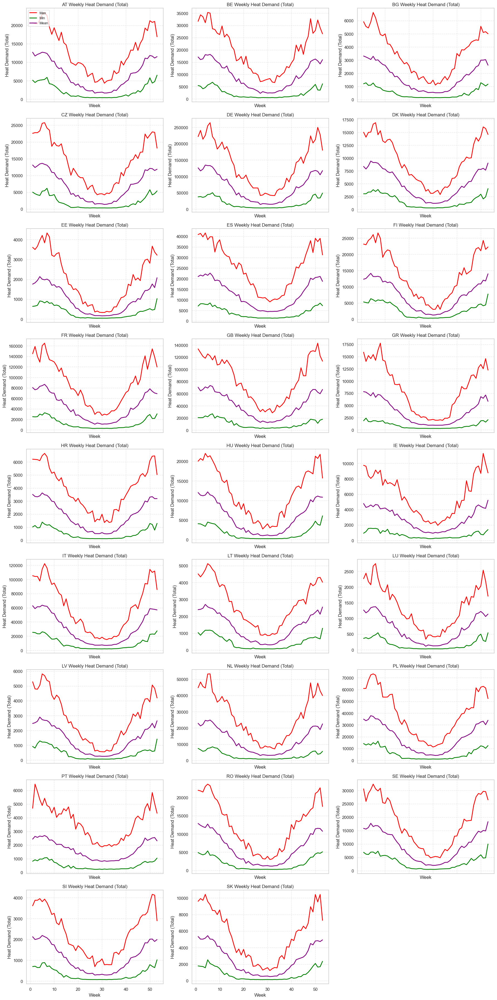

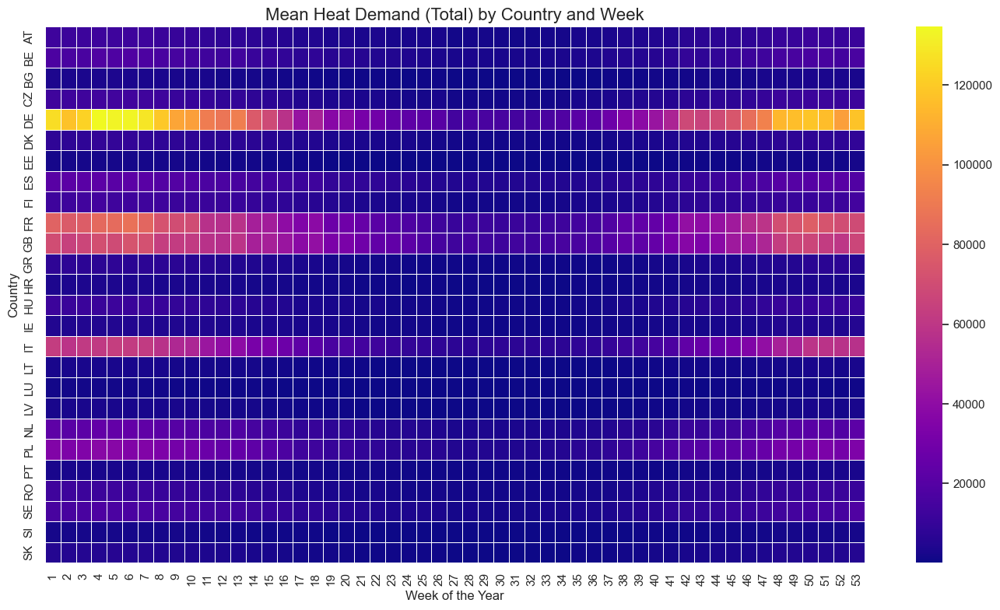

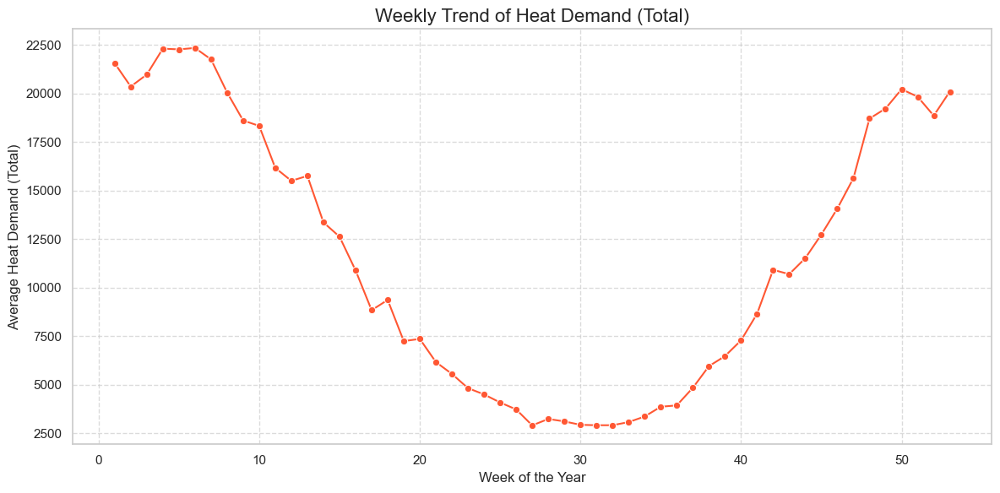

In [ ]:
# For Compute overall weekly summary (mean, max, min) for heat_demand_total
overall_weekly_summary_total = country_weekly_summary_total.groupby('week')[['mean', 'max', 'min']].mean().reset_index()

# Setting positions and bar width
bar_width = 0.25
weeks = overall_weekly_summary_total['week'].values

r1 = np.arange(len(weeks))
r2 = [x + bar_width for x in r1]
r3 = [x + bar_width for x in r2]

# Ploting grouped bar plot
plt.figure(figsize=(14, 6))
plt.bar(r1, overall_weekly_summary_total['mean'], width=bar_width, label='Mean', color='skyblue')
plt.bar(r2, overall_weekly_summary_total['max'], width=bar_width, label='Max', color='salmon')
plt.bar(r3, overall_weekly_summary_total['min'], width=bar_width, label='Min', color='lightgreen')

# Customizing plot
plt.xlabel('Week of the Year', fontsize=12)
plt.ylabel('Heat Demand (Total)', fontsize=12)
plt.title('Overall Weekly Heat Demand (Total) Summary', fontsize=14)
plt.xticks([r + bar_width for r in range(len(weeks))], weeks)
plt.legend()
plt.grid(axis='y', linestyle='--', alpha=0.5)
plt.tight_layout()
plt.show()



# For List of countries
countries = country_weekly_summary_total['country'].unique()

# Setting-up subplot grid
n_cols = 3
n_rows = (len(countries) // n_cols) + (len(countries) % n_cols > 0)
fig, axes = plt.subplots(n_rows, n_cols, figsize=(18, n_rows * 4), sharex=True, sharey=False)

axes = axes.flatten()

# Plotting loop for weekly heat demand total by country
for i, country in enumerate(countries):
    country_data = country_weekly_summary_total[country_weekly_summary_total['country'] == country]
    
    ax = axes[i]
    ax.plot(country_data['week'], country_data['max'], label='Max', color='red', linewidth=2)
    ax.plot(country_data['week'], country_data['min'], label='Min', color='green', linewidth=2)
    ax.plot(country_data['week'], country_data['mean'], label='Mean', color='purple', linewidth=2)
    
    ax.set_title(f"{country} Weekly Heat Demand (Total)", fontsize=12)
    ax.set_xlabel("Week")
    ax.set_ylabel("Heat Demand (Total)")
    ax.grid(True, linestyle='--', alpha=0.5)
    
    if i == 0:
        ax.legend(loc='upper left', fontsize=9)

# Hiding any empty subplots
for j in range(i+1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()



# Using Pivot data for the heatmap (average heat demand total for each country by week)
pivot_mean_total = country_weekly_summary_total.pivot(index='country', columns='week', values='mean')

# Ploting heatmap
plt.figure(figsize=(14, 8))
sns.heatmap(pivot_mean_total, cmap='plasma', annot=False, linewidths=0.5)

plt.title('Mean Heat Demand (Total) by Country and Week', fontsize=16)
plt.xlabel('Week of the Year', fontsize=12)
plt.ylabel('Country', fontsize=12)
plt.tight_layout()
plt.show()



# Calculating overall weekly mean (averaging the 'mean' per week from the summary table)
weekly_trend_total = country_weekly_summary_total.groupby('week')['mean'].mean().reset_index()

# Ploting overall weekly trend
plt.figure(figsize=(12, 6))
sns.lineplot(x='week', y='mean', data=weekly_trend_total, marker='o', color='#FF5733')

plt.title('Weekly Trend of Heat Demand (Total)', fontsize=16)
plt.xlabel('Week of the Year', fontsize=12)
plt.ylabel('Average Heat Demand (Total)', fontsize=12)
plt.grid(True, linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()


In [ ]:
# Grouping by 'country' and 'month', then calculate descriptive statistics for 'heat_demand_total'
country_monthly_summary_total = df.groupby(['country', 'month'])['heat_demand_total'].agg(
    mean='mean',
    min='min',
    max='max',
    q1=lambda x: x.quantile(0.25),
    q3=lambda x: x.quantile(0.75)
).reset_index().round(2)

# Converting DataFrame to an HTML table using tabulate
country_monthly_summary_total_table = tabulate(country_monthly_summary_total.head(50), headers='keys', tablefmt='html', showindex=False)

# For Style and wrap the table in a scrollable div
styled_country_monthly_table_total = f"""
<div style="font-family: 'Arial', sans-serif; background-color: #f9f9f9; padding: 20px; border-radius: 10px; overflow-x: auto;">
    <h3 style="text-align: center; color: #4CAF50; font-size: 24px; font-weight: bold;">Overall Country-wise Monthly Heat Demand Total Summary</h3>
    <table style="width: 100%; border-collapse: collapse; margin: 25px 0; font-size: 14px; text-align: center; border: 1px solid #ddd; word-wrap: break-word;">
        <thead style="background-color: #4CAF50; color: white; font-weight: bold;">
            {country_monthly_summary_total_table.split('<thead>')[1].split('</thead>')[0]}
        </thead>
        <tbody style="background-color: #ffffff;">
            {country_monthly_summary_total_table.split('<tbody>')[1].split('</tbody>')[0]}
        </tbody>
    </table>
</div>
"""

# Displaying the styled table in Jupyter Notebook
display(HTML(styled_country_monthly_table_total))

country,month,mean,min,max,q1,q3
AT,1,12170.7,4502,21407,10058,14443
AT,2,12008.5,4073,23482,9735.5,14151.5
AT,3,9148.84,2568,19344,6905,11288.8
AT,4,5978.69,794,15287,4064.75,7647.25
AT,5,3788.31,521,9915,2390,5014.25
AT,6,2407.32,383,8515,1462.75,3069.25
AT,7,1782.82,378,5734,1197.75,2270
AT,8,1848.74,382,7705,1233.75,2331
AT,9,3402.19,455,10296,2081,4436.25
AT,10,6191.07,818,15388,4175,8038.5


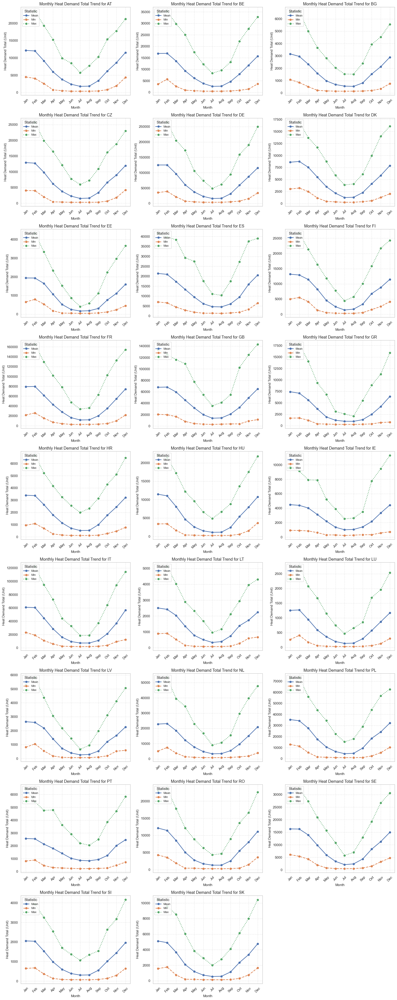

C:\Users\oppor\AppData\Local\Temp\ipykernel_8232\2358436706.py:64: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.barplot(x="month", y="heat_demand_total", hue="stat", data=monthly_melted_total, palette=palette, ci=None)


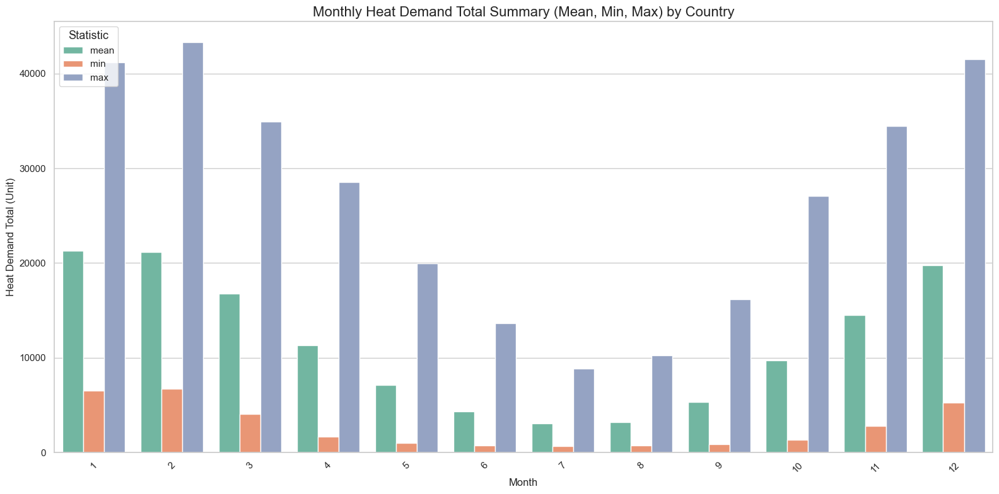

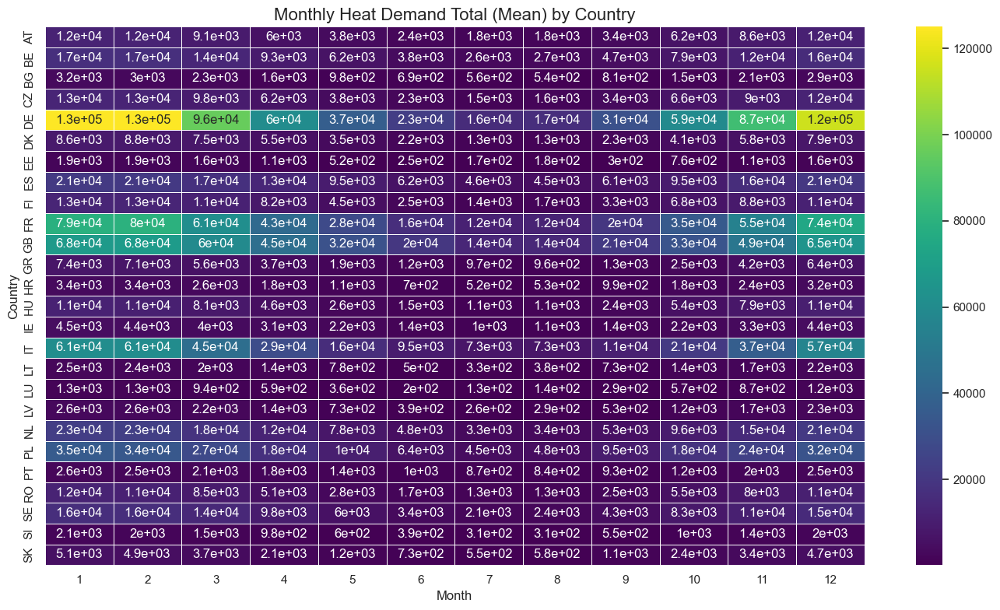

In [ ]:
# Setting seaborn style for consistency
sns.set(style="whitegrid")

# For List of countries from the monthly summary
countries = country_monthly_summary_total['country'].unique()

# Determining the number of rows and columns for the subplot grid
n_cols = 3
n_rows = int(np.ceil(len(countries) / n_cols))

# Creating subplots with appropriate size
fig, axes = plt.subplots(n_rows, n_cols, figsize=(n_cols * 6, n_rows * 5))

# Using Flatten axes array for easier iteration
axes = axes.flatten()

# For Loop over each country and create a line plot in the corresponding subplot
for i, country in enumerate(countries):
    country_data = country_monthly_summary_total[country_monthly_summary_total['country'] == country]
    ax = axes[i]
    
    # Ploting mean, min, max for heat_demand_total
    ax.plot(country_data['month'], country_data['mean'], label='Mean', marker='o', linewidth=2)
    ax.plot(country_data['month'], country_data['min'], label='Min', linestyle='--', marker='o', linewidth=2)
    ax.plot(country_data['month'], country_data['max'], label='Max', linestyle=':', marker='o', linewidth=2)
    
    ax.set_title(f'Monthly Heat Demand Total Trend for {country}', fontsize=13)
    ax.set_xlabel('Month', fontsize=11)
    ax.set_ylabel('Heat Demand Total (Unit)', fontsize=11)
    
    ax.set_xticks(range(1, 13))
    ax.set_xticklabels(['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun',
                        'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec'], rotation=45)
    
    ax.legend(title="Statistic", fontsize=9, loc='upper left')
    ax.grid(True, linestyle='--', alpha=0.5)

# Hiding any empty subplots
for j in range(i + 1, len(axes)):
    fig.delaxes(axes[j])

plt.tight_layout()
plt.show()




# Setting figure size
plt.figure(figsize=(16, 8))
sns.set(style="whitegrid")

# Melting the DataFrame to long format for heat_demand_total
monthly_melted_total = country_monthly_summary_total.melt(
    id_vars=['country', 'month'], 
    value_vars=['mean', 'min', 'max'],
    var_name='stat', 
    value_name='heat_demand_total'
)

# Setting color palette
palette = sns.color_palette("Set2", n_colors=3)

# Creating the barplot for heat_demand_total
sns.barplot(x="month", y="heat_demand_total", hue="stat", data=monthly_melted_total, palette=palette, ci=None)

# Rotating x-axis labels
plt.xticks(rotation=45)

# For Titles and labels
plt.title('Monthly Heat Demand Total Summary (Mean, Min, Max) by Country', fontsize=16)
plt.xlabel('Month', fontsize=12)
plt.ylabel('Heat Demand Total (Unit)', fontsize=12)

# Adjusting legend
plt.legend(title="Statistic", title_fontsize='13', loc='upper left', fontsize='11')

plt.tight_layout()
plt.show()




# Using Pivot the data for heatmap format for heat_demand_total
heatmap_total = country_monthly_summary_total.pivot(index='country', columns='month', values='mean')

# Setting up the heatmap for heat_demand_total
plt.figure(figsize=(14, 8))
sns.heatmap(heatmap_total, cmap='viridis', annot=True, linewidths=0.5)

# For Title and labels
plt.title('Monthly Heat Demand Total (Mean) by Country', fontsize=16)
plt.xlabel('Month', fontsize=12)
plt.ylabel('Country', fontsize=12)

plt.tight_layout()
plt.show()

In [ ]:
# Extracting year from timestamp
df['year'] = df['cet_cest_timestamp'].dt.year

# Grouping by 'country' and 'year', calculate descriptive stats for heat_demand_total
country_yearly_summary_total = df.groupby(['country', 'year'])['heat_demand_total'].agg(
    mean='mean',
    min='min',
    max='max',
    q1=lambda x: x.quantile(0.25),
    q3=lambda x: x.quantile(0.75)
).reset_index().round(2)

# Converting DataFrame to HTML table using tabulate
from tabulate import tabulate
country_yearly_summary_table_total = tabulate(country_yearly_summary_total.head(35), headers='keys', tablefmt='html', showindex=False)

# For Styled HTML table
styled_country_yearly_table_total = f"""
<div style="font-family: 'Arial', sans-serif; background-color: #f9f9f9; padding: 20px; border-radius: 10px; overflow-x: auto;">
    <h3 style="text-align: center; color: #4CAF50; font-size: 24px; font-weight: bold;">Overall Country-wise Yearly Heat Demand Total Summary</h3>
    <table style="width: 100%; border-collapse: collapse; margin: 25px 0; font-size: 14px; text-align: center; border: 1px solid #ddd; word-wrap: break-word;">
        <thead style="background-color: #4CAF50; color: white; font-weight: bold;">
            {country_yearly_summary_table_total.split('<thead>')[1].split('</thead>')[0]}
        </thead>
        <tbody style="background-color: #ffffff;">
            {country_yearly_summary_table_total.split('<tbody>')[1].split('</tbody>')[0]}
        </tbody>
    </table>
</div>
"""

# Displaying the styled table (if in Jupyter)
from IPython.display import display, HTML
display(HTML(styled_country_yearly_table_total))


country,year,mean,min,max,q1,q3
AT,2007,9664,9664,9664,9664,9664
AT,2008,6611.85,435,20630,2474.5,9861
AT,2009,6315.74,424,21052,2251.5,10080.5
AT,2010,7045.63,380,21407,2736,10576.5
AT,2011,6353.12,382,19827,2386.5,10039
AT,2012,6577.7,413,23482,2369,9918.5
AT,2013,6881.87,383,20647,2652,10752
AT,2014,6136.94,467,20702,2715.5,9338
AT,2015,6474.12,378,18505,2461.5,10009.5
AT,2016,8923,8923,8923,8923,8923


C:\Users\oppor\AppData\Local\Temp\ipykernel_8232\620480094.py:24: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.barplot(


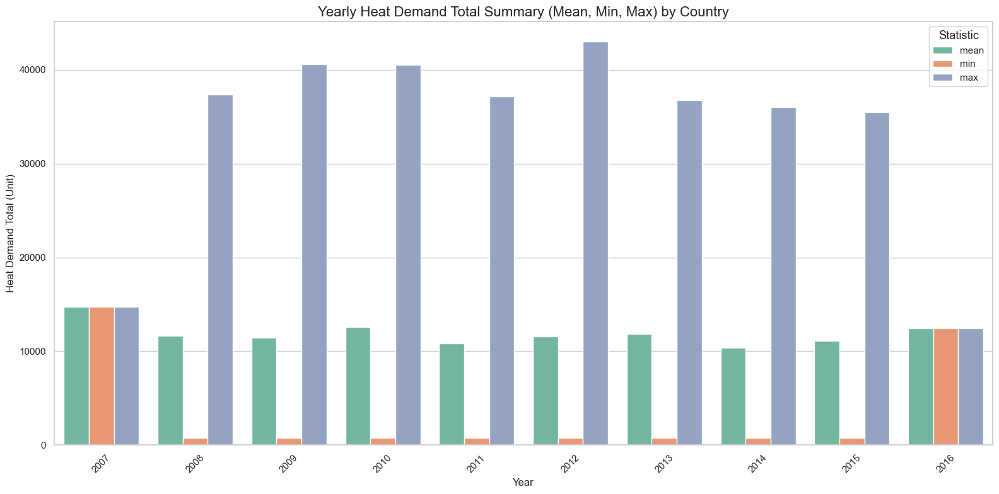

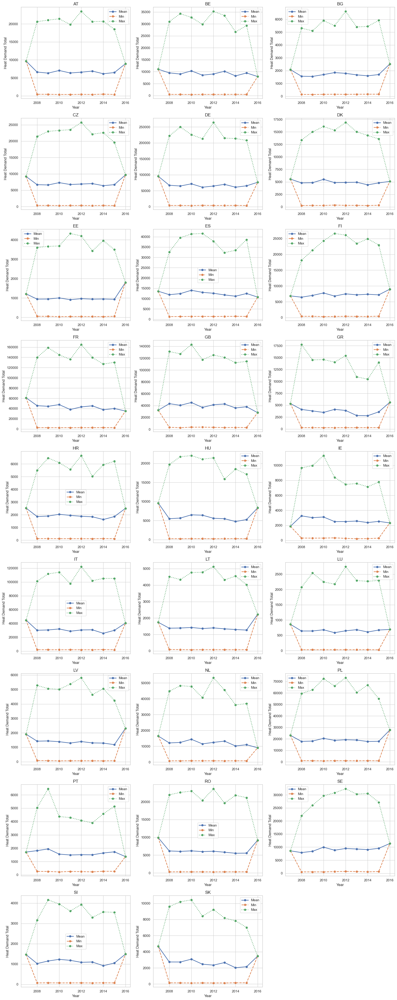

In [ ]:
# Grouping by 'country' and 'year', calculate descriptive stats for heat_demand_total
yearly_summary_total = df.groupby(['country', 'year'])['heat_demand_total'].agg(
    mean='mean',
    min='min',
    max='max'
).reset_index().round(2)


# Melting the summary for plotting
yearly_melted_total = yearly_summary_total.melt(
    id_vars=['country', 'year'],
    value_vars=['mean', 'min', 'max'],
    var_name='stat',
    value_name='heat_demand_total'
)


# Setting seaborn style
sns.set(style="whitegrid")

plt.figure(figsize=(16, 8))
palette = sns.color_palette("Set2", n_colors=3)

sns.barplot(
    x="year",
    y="heat_demand_total",
    hue="stat",
    data=yearly_melted_total,
    palette=palette,
    ci=None
)

plt.title('Yearly Heat Demand Total Summary (Mean, Min, Max) by Country', fontsize=16)
plt.xlabel('Year', fontsize=12)
plt.ylabel('Heat Demand Total (Unit)', fontsize=12)
plt.legend(title="Statistic", title_fontsize='13', loc='upper right', fontsize='11')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()



# Using For Number of countries
countries = yearly_summary_total['country'].unique()
n_countries = len(countries)
cols = 3
rows = int(np.ceil(n_countries / cols))

fig, axes = plt.subplots(rows, cols, figsize=(18, 5 * rows))

for i, country in enumerate(countries):
    ax = axes.flat[i]
    country_data = yearly_summary_total[yearly_summary_total['country'] == country]
    
    ax.plot(country_data['year'], country_data['mean'], label='Mean', marker='o', linewidth=2)
    ax.plot(country_data['year'], country_data['min'], label='Min', marker='o', linestyle='--', linewidth=2)
    ax.plot(country_data['year'], country_data['max'], label='Max', marker='o', linestyle=':', linewidth=2)
    
    ax.set_title(f"{country}", fontsize=14)
    ax.set_xlabel("Year")
    ax.set_ylabel("Heat Demand Total")
    ax.legend()

# Removing empty subplots if any
for j in range(i + 1, len(axes.flat)):
    fig.delaxes(axes.flat[j])

plt.tight_layout()
plt.show()


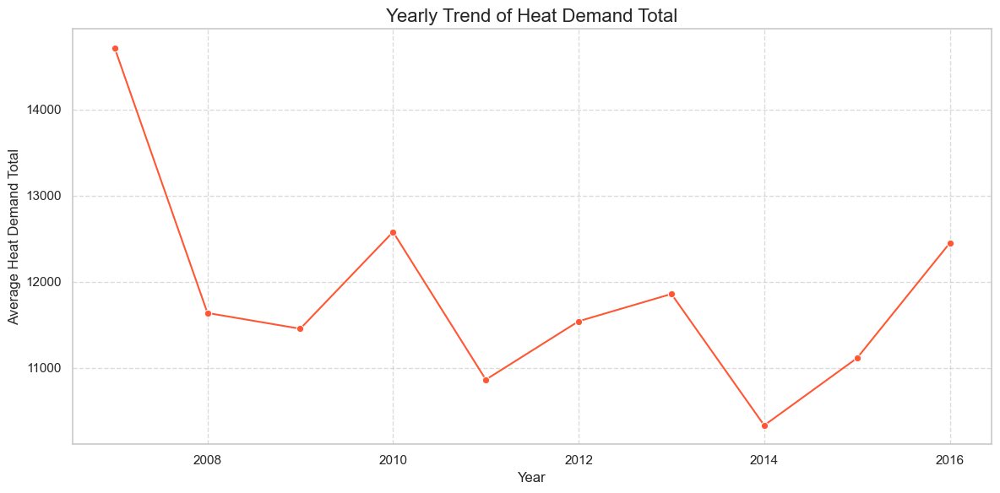

In [ ]:
# Calculating the overall yearly trend for heat_demand_total
yearly_trend_total = df.groupby('year')['heat_demand_total'].mean().reset_index()

# Setting the plot size and style
plt.figure(figsize=(12, 6))
sns.set(style="whitegrid")

# Ploting the yearly trend of heat_demand_total
sns.lineplot(x='year', y='heat_demand_total', data=yearly_trend_total, marker='o', color='#FF5733')

# For Title and labels
plt.title('Yearly Trend of Heat Demand Total', fontsize=16)
plt.xlabel('Year', fontsize=12)
plt.ylabel('Average Heat Demand Total', fontsize=12)
plt.grid(True, linestyle='--', alpha=0.7)
plt.tight_layout()

# Showing the plot
plt.show()


In [ ]:
# Converting the timestamp to datetime
df['utc_timestamp'] = pd.to_datetime(df['utc_timestamp'])

# Extracting features from the timestamp (hour, day of the week, etc.)
df['hour'] = df['utc_timestamp'].dt.hour
df['day_of_week'] = df['utc_timestamp'].dt.dayofweek
df['month'] = df['utc_timestamp'].dt.month

# One-Hot Encode the 'country' column (as it is categorical)
# 'country' is a categorical feature so we need to encode it
categorical_features = ['country']
numerical_features = ['hour', 'day_of_week', 'month']

# Defining features (independent variables) and target (dependent variable)
X = df[categorical_features + numerical_features]  # Now using time features and country
y = df['heat_demand_total']  # Target variable (total heat demand)

# Splitting the dataset into training and testing sets (80% train, 20% test)
X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.2, random_state=42
)

# Creating a preprocessing pipeline with one-hot encoding for categorical data
preprocessor = ColumnTransformer(
    transformers=[
        ('num', 'passthrough', numerical_features),  # Leave numerical features as is
        ('cat', OneHotEncoder(), categorical_features)  # One-hot encode categorical 'country'
    ]
)

# Creating a pipeline with preprocessing and model training
model = Pipeline(steps=[
    ('preprocessor', preprocessor),
    ('regressor', LinearRegression())
])

# For Train the model
model.fit(X_train, y_train)

# Making predictions on the test set
y_pred = model.predict(X_test)

# Evaluating model performance
mae = mean_absolute_error(y_test, y_pred)
mse = mean_squared_error(y_test, y_pred)
r_squared = r2_score(y_test, y_pred)

# For Print evaluation metrics
print('--- Model Performance ---')
print(f'Mean Absolute Error (MAE): {mae:.2f}')
print(f'Mean Squared Error (MSE): {mse:.2f}')
print(f'R-squared: {r_squared:.2f}')

# Optional: Displaying predicted vs actual values side-by-side
comparison_df = pd.DataFrame({'Actual': y_test, 'Predicted': y_pred})
print(comparison_df.head(10))

--- Model Performance ---
Mean Absolute Error (MAE): 7045.80
Mean Squared Error (MSE): 190839085.30
R-squared: 0.57
          Actual     Predicted
176521   21196.0  11806.525999
1985456    950.0   2362.584140
3422197    253.0   1718.880140
3209419   4382.0   8004.512792
850757   10864.0   7918.038452
3335630   3266.0   9193.476621
168063   13222.0  11293.753495
1580993   5036.0   5006.307799
1611865   9155.0    623.397126
52421    11782.0   3717.792251


In [ ]:
df.loc[:, 'heat_demand_interaction'] = df['heat_demand_space'] * df['heat_demand_water']  # Interaction term
df.loc[:, 'rolling_mean_heat_demand'] = df['heat_demand_total'].rolling(window=24).mean()  # 24-hour rolling mean

# Droping rows with NaN values (caused by rolling mean or other transformations)
df = df.dropna()

# Defining features (independent variables) and target (dependent variable)
X = df[['heat_demand_space', 'heat_demand_water', 'hour', 'day_of_week', 'month', 'heat_demand_interaction', 'rolling_mean_heat_demand']]
y = df['heat_demand_total']

# Splitting the dataset into training and testing sets (80% train, 20% test)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# For Standardize the features
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Initializing and train the model (using Random Forest as an example)
model = RandomForestRegressor(n_estimators=100, random_state=42)

# For Train the model
model.fit(X_train_scaled, y_train)

# Making predictions on the test set
y_pred = model.predict(X_test_scaled)

# Evaluating model performance
mae = mean_absolute_error(y_test, y_pred)
mse = mean_squared_error(y_test, y_pred)
r_squared = r2_score(y_test, y_pred)

# For Print evaluation metrics
print('--- Model Performance ---')
print(f'Mean Absolute Error (MAE): {mae:.2f}')
print(f'Mean Squared Error (MSE): {mse:.2f}')
print(f'R-squared: {r_squared:.2f}')

# Optional: Displaying predicted vs actual values side-by-side
comparison_df = pd.DataFrame({'Actual': y_test, 'Predicted': y_pred})
print(comparison_df.head(10))

# Cross-validation for model evaluation
cv_scores = cross_val_score(model, X, y, cv=5, scoring='neg_mean_absolute_error')
print(f'Cross-validated MAE: {-np.mean(cv_scores):.2f}')

--- Model Performance ---
Mean Absolute Error (MAE): 5.18
Mean Squared Error (MSE): 913.04
R-squared: 1.00
          Actual  Predicted
1720990    722.0     721.58
1505167  13688.0   13685.07
1378408  65241.0   65269.67
1365300   7692.0    7689.92
2939723   5452.0    5452.90
1195686   3353.0    3352.39
2561774   2099.0    2098.36
2170624   8411.0    8411.76
844011    6148.0    6149.12
2025935   5704.0    5702.25


In [209]:
print(df.columns)


Index(['utc_timestamp', 'cet_cest_timestamp', 'country', 'heat_demand_space',
       'heat_demand_water', 'heat_demand_total', 'year', 'hour', 'day_of_week',
       'month', 'day_of_year', 'week_of_year'],
      dtype='object')
